In [1]:
import sys
print(sys.version)
print(sys.executable)

3.8.17 (default, Jul  5 2023, 21:04:15) 
[GCC 11.2.0]
/public3/home/scg6055/.conda/envs/py38/bin/python


In [2]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
# import scanorama
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
from deside.utility import check_dir
from deside.utility import log_exp2cpm,non_log2cpm,non_log2log_cpm
sns.set()

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1053: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1061: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packag

In [3]:
os.path.abspath('.')

'/public3/home/scg6055/YERONG/deside_single_cell/code'

In [4]:
path_10X = r'../data/11_Neftel_GBM/GSM3828673_10X_GBM_IDHwt_processed_TPM.tsv'
# data = pd.read_csv(path,sep='\t',index_col =0,header=0)
# data.shape
path_SS2 = r'../data/11_Neftel_GBM/GSM3828672_Smartseq2_GBM_IDHwt_processed_TPM.tsv'
result_dir = r'../results'
result_dir =  os.path.join(result_dir, 'Neftel2019_Brain')
check_dir(result_dir)

In [5]:


def read_single_csv(input_path,sep):
   #Read large files in chunksize
    df_chunk=pd.read_csv(input_path,sep=sep ,index_col =0,header=0,chunksize=1000)    
    res_chunk=[]
    for chunk in df_chunk:
        res_chunk.append(chunk)
    res_df=pd.concat(res_chunk)
    return res_df


### 1. Read an filtering raw data

(7930, 23686)
GENE           A1BG  A1BG-AS1  A1CF       A2M  A2M-AS1     A2ML1  A2MP1  \
MGH101-P1-A04   0.0       0.0   0.0  0.000000      0.0  0.064883    0.0   
MGH101-P1-A05   0.0       0.0   0.0  5.327184      0.0  0.000000    0.0   

GENE           A4GALT  A4GNT  AA06  ...  ZWILCH  ZWINT  ZXDA  ZXDB      ZXDC  \
MGH101-P1-A04     0.0    0.0   0.0  ...     0.0    0.0   0.0   0.0  0.173767   
MGH101-P1-A05     0.0    0.0   0.0  ...     0.0    0.0   0.0   0.0  0.292782   

GENE             ZYG11A    ZYG11B  ZYX  ZZEF1  ZZZ3  
MGH101-P1-A04  0.126973  0.310340  0.0    0.0   0.0  
MGH101-P1-A05  0.645241  0.230203  0.0    0.0   0.0  

[2 rows x 23686 columns]
The maximum of data:  15.574831611499922
The maximum of data after log_exp2cpm():  488070.62785271305


(array([   0.,    0.,    0.,    0.,    0., 7930.,    0.,    0.,    0.,
           0.]),
 array([ 999999.5,  999999.6,  999999.7,  999999.8,  999999.9, 1000000. ,
        1000000.1, 1000000.2, 1000000.3, 1000000.4, 1000000.5]),
 <BarContainer object of 10 artists>)

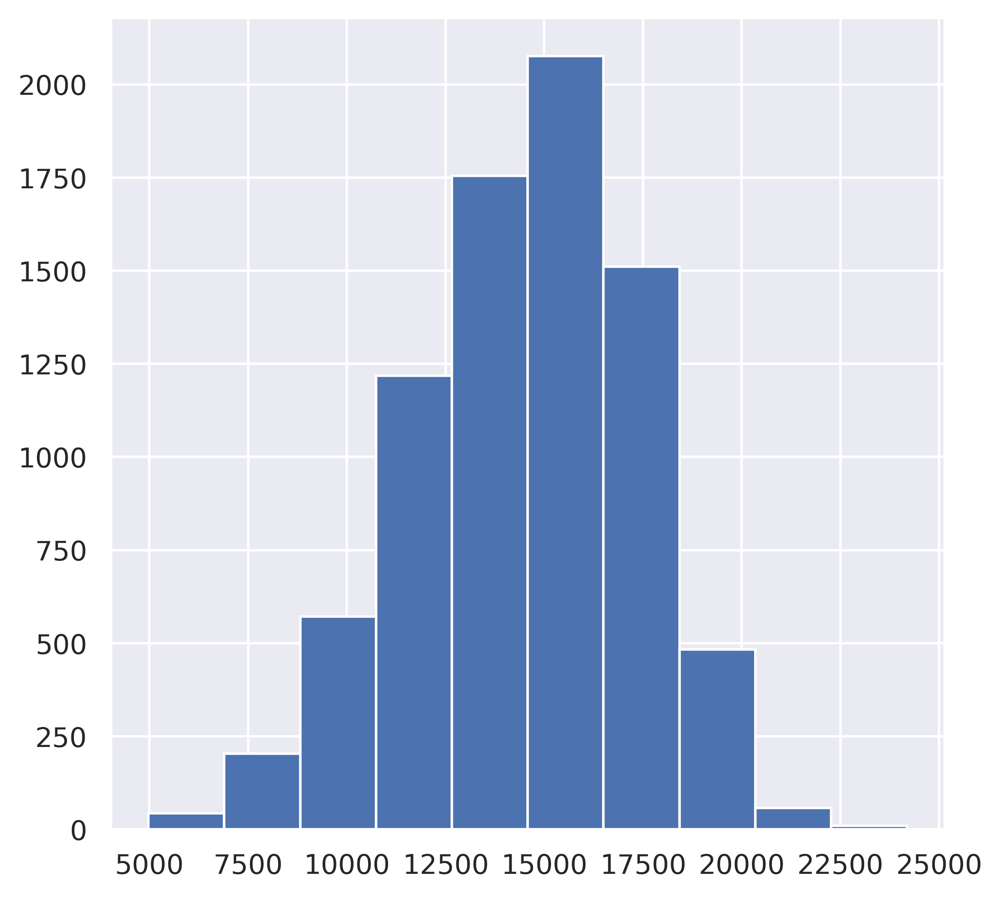

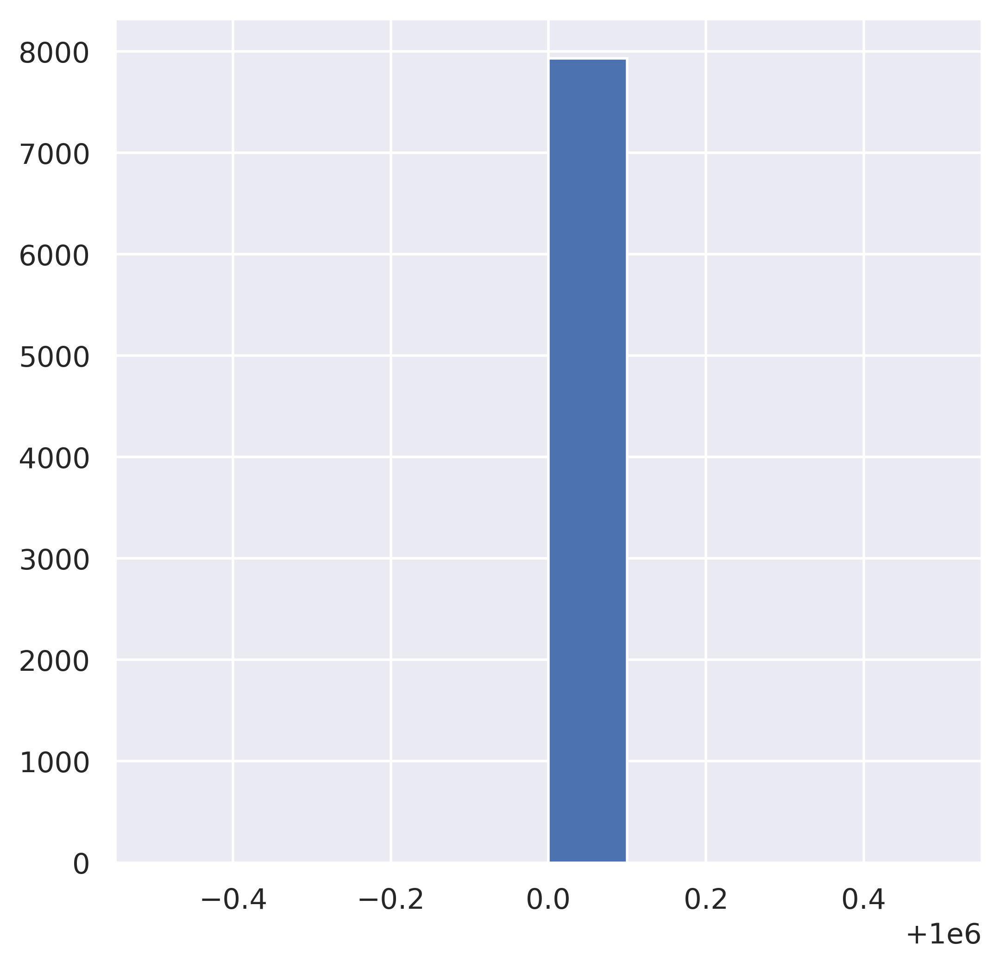

In [6]:
Smartseq2 = pd.read_csv(path_SS2,sep='\t',index_col =0,header=0)
Smartseq2 = Smartseq2.T
print(Smartseq2.shape)
Smartseq2 = Smartseq2.loc[:,Smartseq2.columns.isna()==False]

print(Smartseq2.head(2))
print('The maximum of data: ',Smartseq2.max().max())
plt.figure(figsize=(6,6))
plt.hist(Smartseq2.sum(axis=1))  # dobule check TPM   
Smartseq2 = log_exp2cpm(exp_df=Smartseq2, log_base=2, correct=1)
print('The maximum of data after log_exp2cpm(): ',Smartseq2.max().max())
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(Smartseq2.sum(axis=1)),0))  # dobule check TPM   



In [7]:
Smartseq2.head(2)

GENE,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2MP1,A4GALT,A4GNT,AA06,...,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3
MGH101-P1-A04,0.0,0.0,0.0,0.000000,0.0,0.46,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.28,0.92,2.40,0.0,0.0,0.0
MGH101-P1-A05,0.0,0.0,0.0,391.460008,0.0,0.00,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.25,5.64,1.73,0.0,0.0,0.0


(16201, 30314)
(16201, 30314)


GENE,FAM138A,OR4F5,RP11-34P13.7,RP11-34P13.8,RP11-34P13.14,RP11-34P13.9,AP006222.2,RP4-669L17.10,OR4F29,RP4-669L17.2,...,MT-ND5,MT-ND6,MT-CYB,MGC39584,AC011043.1,AL592183.1,AC011841.1,BX072566.1,AL354822.1,BAGE5
102_1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,691.204424,0.000000,8035.251426,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
102_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,315.357931,315.357931,3784.295175,0.0,0.0,157.678966,0.0,0.0,0.0,0.0


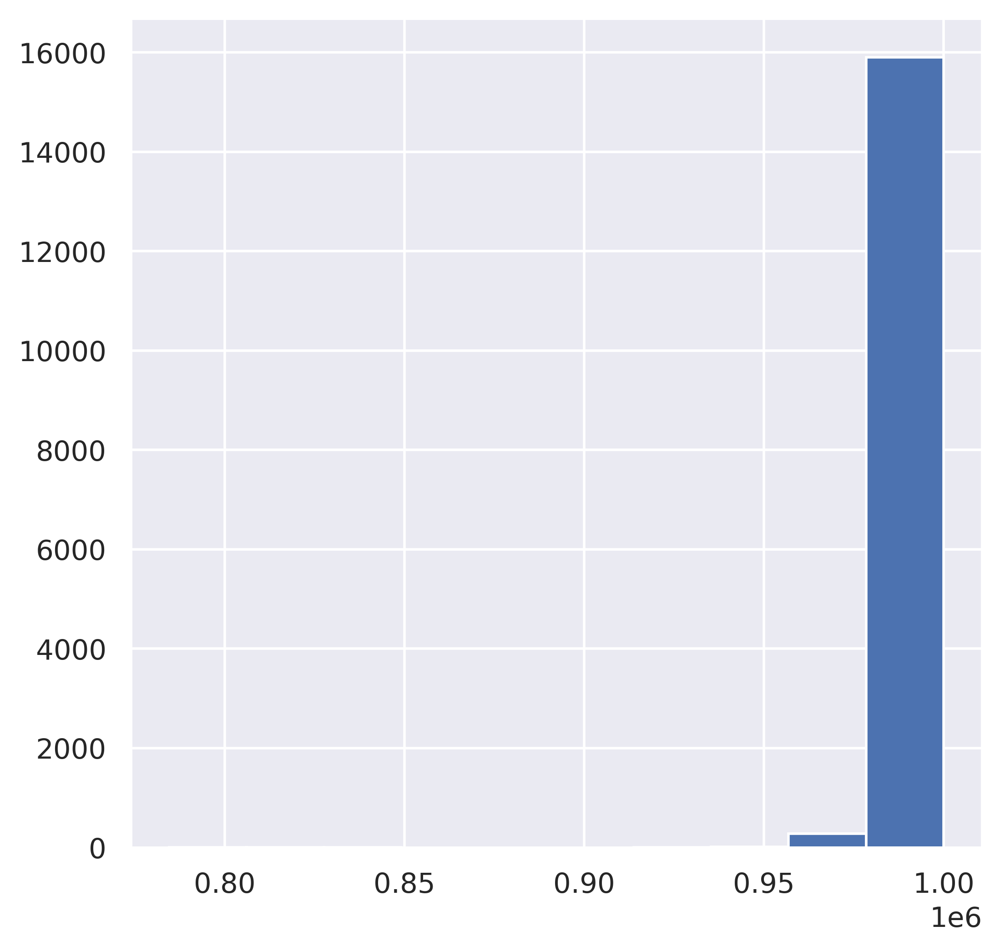

In [8]:
GSM3828673_10X = read_single_csv(path_10X,sep = '\t')  
GSM3828673_10X = GSM3828673_10X.T
print(GSM3828673_10X.shape)

GSM3828673_10X = GSM3828673_10X.loc[:,GSM3828673_10X.columns.isna()==False]
print(GSM3828673_10X.shape)
plt.figure(figsize=(6,6))
ax = plt.hist(GSM3828673_10X.sum(axis=1))  # dobule check TPM
GSM3828673_10X.head(2)

#### 1.1 combine raw data

(24131, 19135)


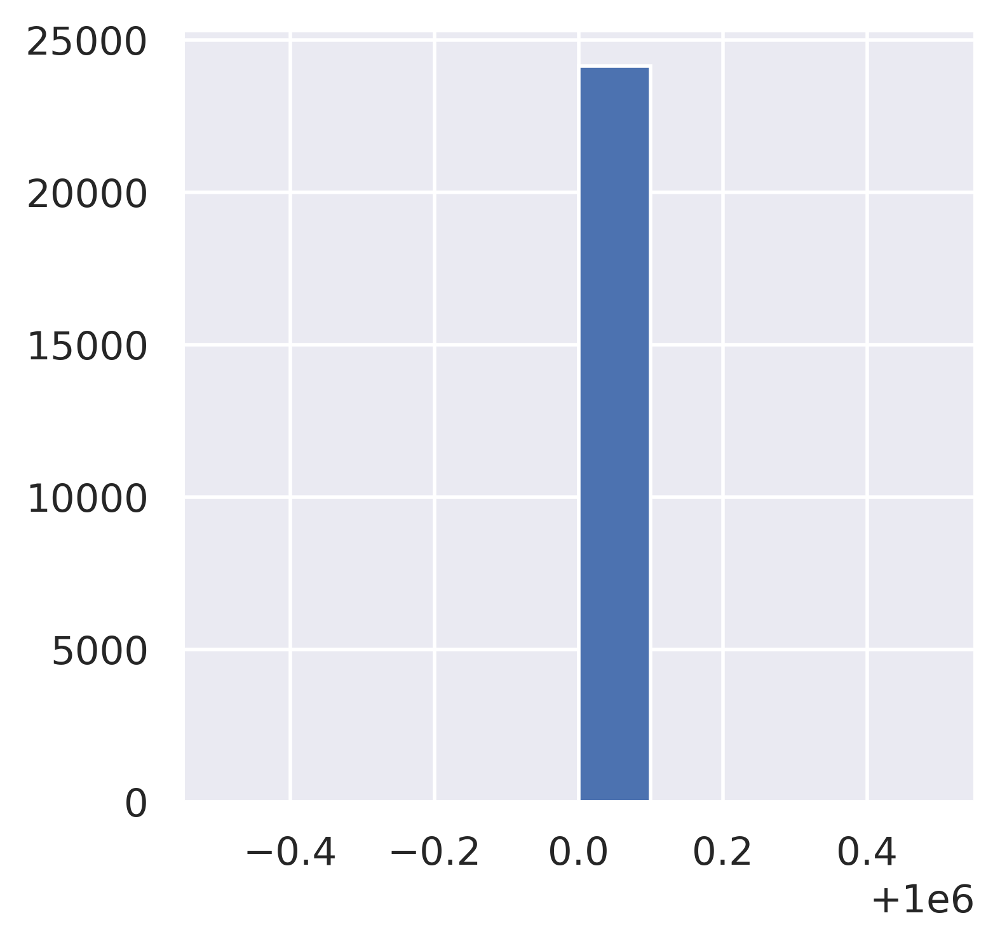

In [9]:
GBM_dta = pd.concat([Smartseq2,GSM3828673_10X],axis=0,join='inner')
print(GBM_dta.shape)     #(24131, 19135)
GBM_dta = non_log2cpm(GBM_dta) 
ax = plt.hist(np.around(np.array(GBM_dta.sum(axis=1)),0))  # dobule check TPM  

In [10]:
all_dataset = an.AnnData(GBM_dta)
all_dataset.X = csr_matrix(all_dataset.X)
all_dataset

AnnData object with n_obs × n_vars = 24131 × 19135

In [11]:
##anno
anno_10X_path = r'../data/11_Neftel_GBM/Cells_10X.csv'
anno_SS2_path = r'../data/11_Neftel_GBM/Cells_SmartSeq2.csv'
anno_10X = read_single_csv(anno_10X_path,sep=',')
print(anno_10X.shape)
anno_SS2 = read_single_csv(anno_SS2_path,sep=',')
print(anno_SS2.shape)
anno = pd.concat([anno_SS2,anno_10X],axis=0,join='inner')
anno = anno.iloc[:,range(2)]
anno = anno.rename(columns={'sample':'sample_id'})
print(anno.shape)
anno.head(2)

(16201, 3)
(7930, 18)
(24131, 2)


,sample_id,cell_type
cell_name,,
MGH101-P1-A04,MGH101,Macrophage
MGH101-P1-A05,MGH101,Macrophage


In [12]:

for col in anno.columns:
    anno[col] = anno[col].astype(str)

anno.dtypes

sample_id    object
cell_type    object
dtype: object

In [13]:
anno = anno.reindex(all_dataset.obs.index)   

In [14]:
print(np.sum(all_dataset.obs.index == anno.index))

24131


In [15]:
all_dataset.obs = anno
all_dataset

AnnData object with n_obs × n_vars = 24131 × 19135
    obs: 'sample_id', 'cell_type'

In [16]:
all_files = list(all_dataset.obs['sample_id'].unique())
print(len(all_files))
print(all_dataset.obs['sample_id'].value_counts())


38
105       4127
124       2415
143       2314
102       1822
125       1613
105A      1386
115       1283
MGH105     634
118        539
114        473
MGH66      436
MGH125     399
MGH124     370
MGH110     359
MGH104     355
BT771      339
BT1160     335
BT749      317
MGH102     312
BT920      301
MGH121     297
MGH143     274
MGH122     273
MGH113     260
BT85       245
MGH136     231
126        229
MGH152     229
BT830      220
BT1187     219
BT786      212
MGH100     209
MGH106     200
MGH101     200
MGH129     192
MGH128     184
MGH115     165
MGH151     163
Name: sample_id, dtype: int64


#----------------------------------------------
Deal with MGH101...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (200, 19135)


<Figure size 3000x600 with 0 Axes>

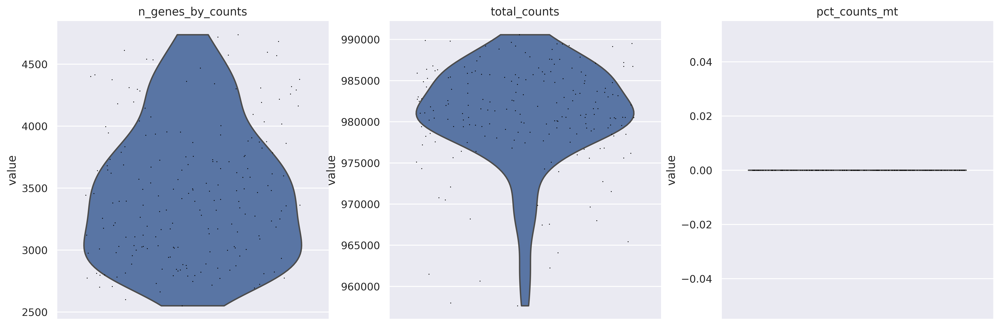

<Figure size 1600x1200 with 0 Axes>

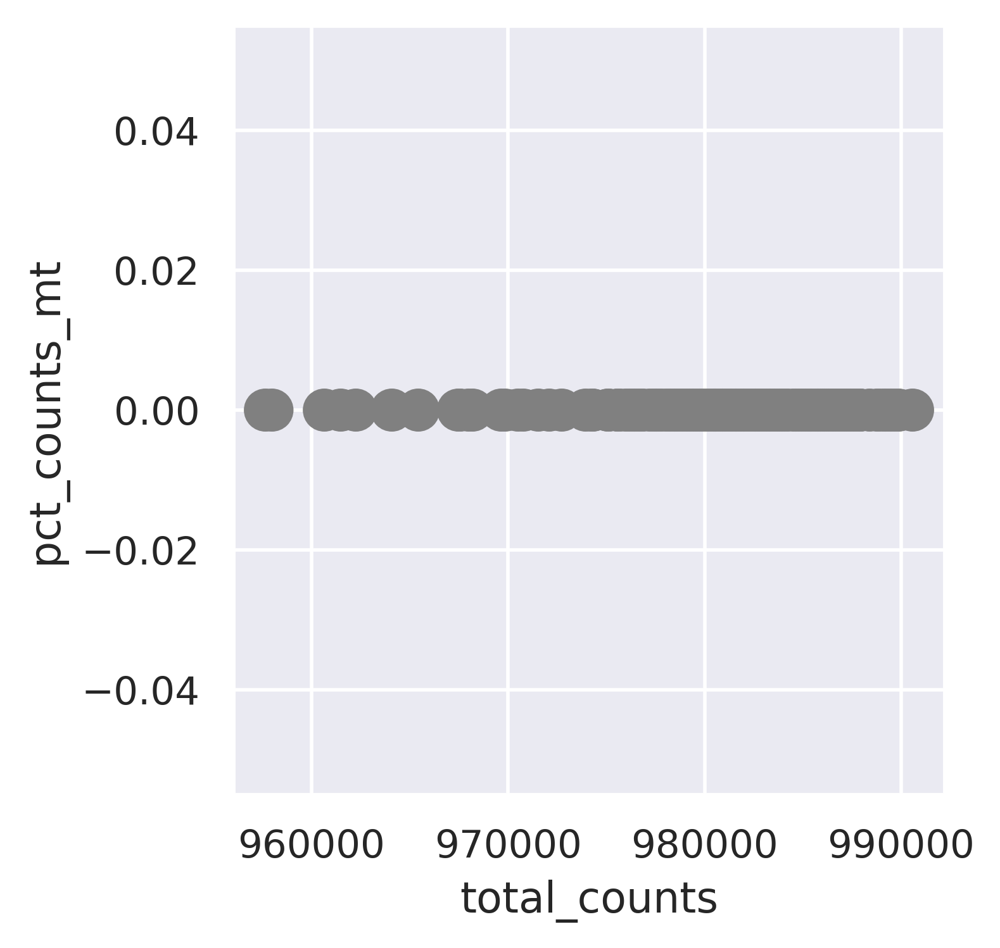

<Figure size 1600x1200 with 0 Axes>

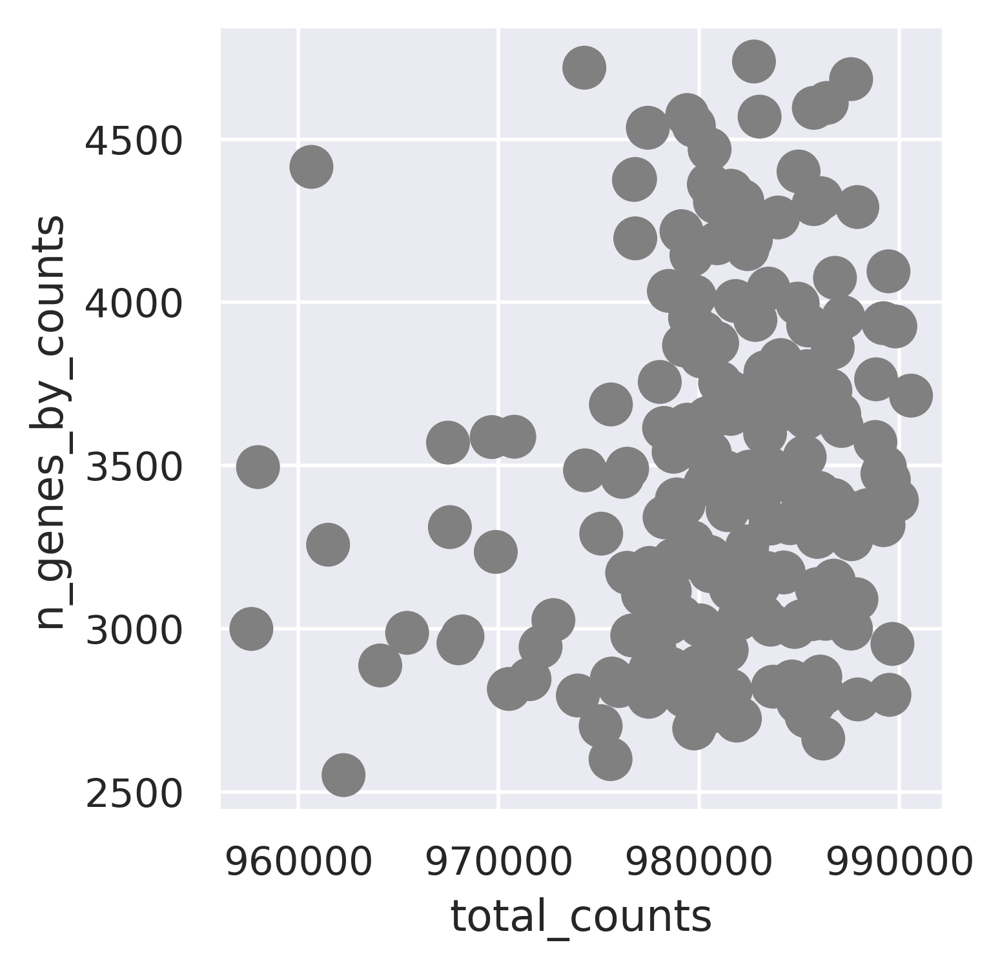

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (200, 10469)
200
#----------------------------------------------
Deal with MGH100...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (209, 19135)


<Figure size 3000x600 with 0 Axes>

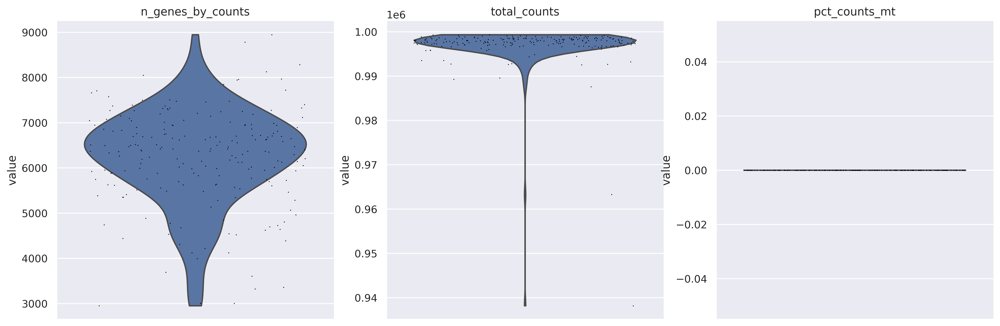

<Figure size 1600x1200 with 0 Axes>

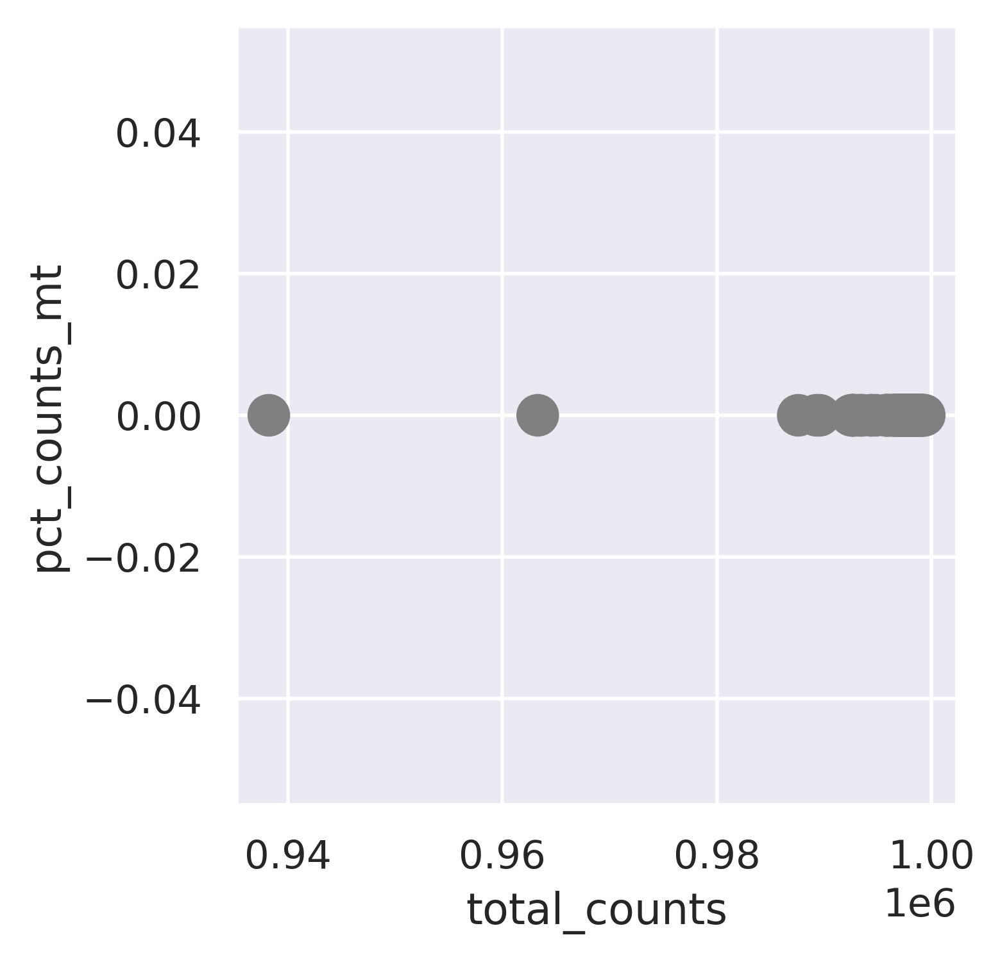

<Figure size 1600x1200 with 0 Axes>

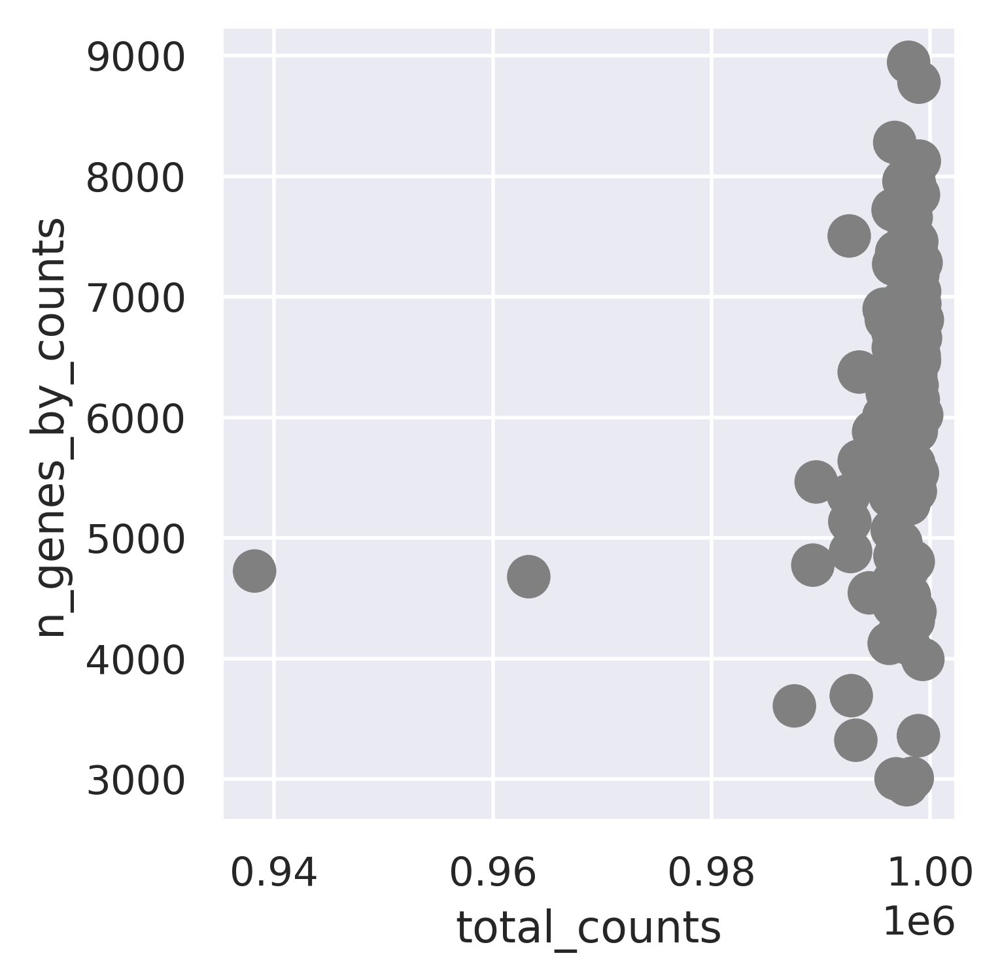

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (204, 13263)
404
#----------------------------------------------
Deal with MGH102...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (312, 19135)


<Figure size 3000x600 with 0 Axes>

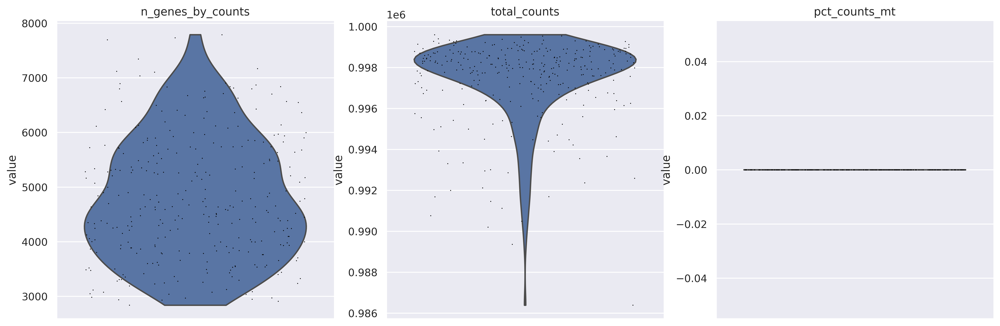

<Figure size 1600x1200 with 0 Axes>

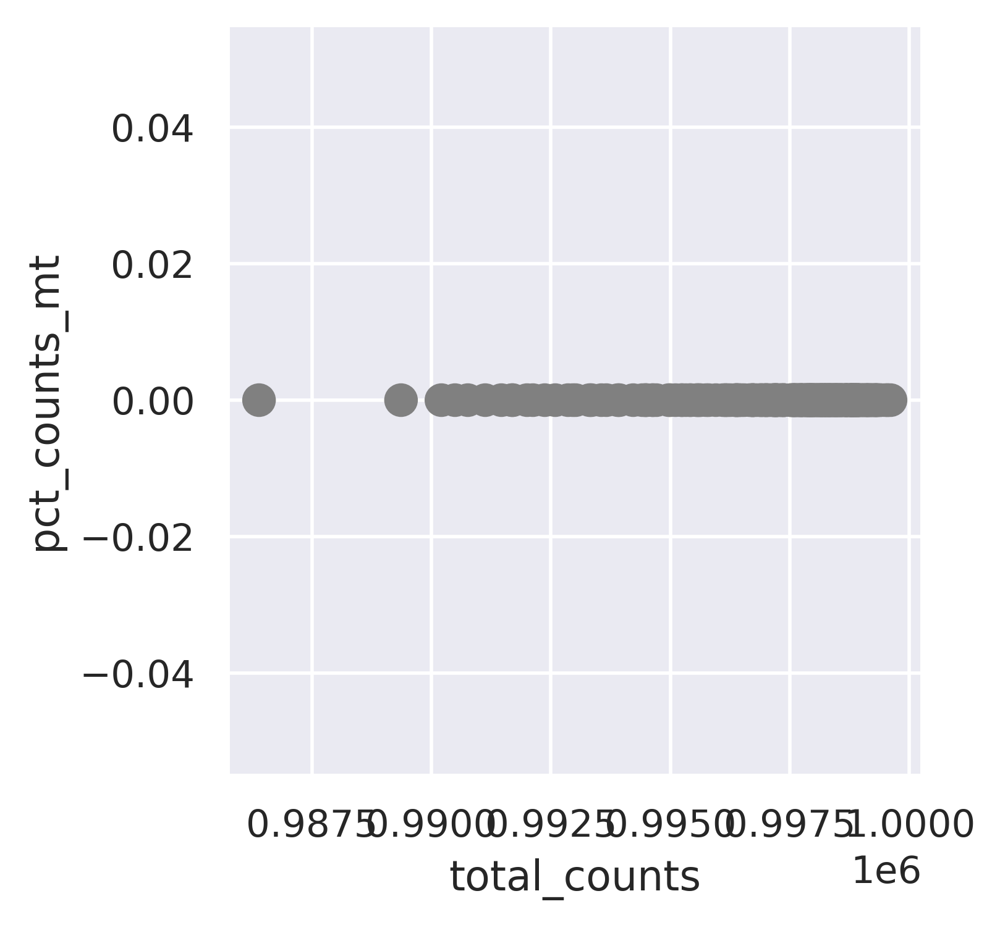

<Figure size 1600x1200 with 0 Axes>

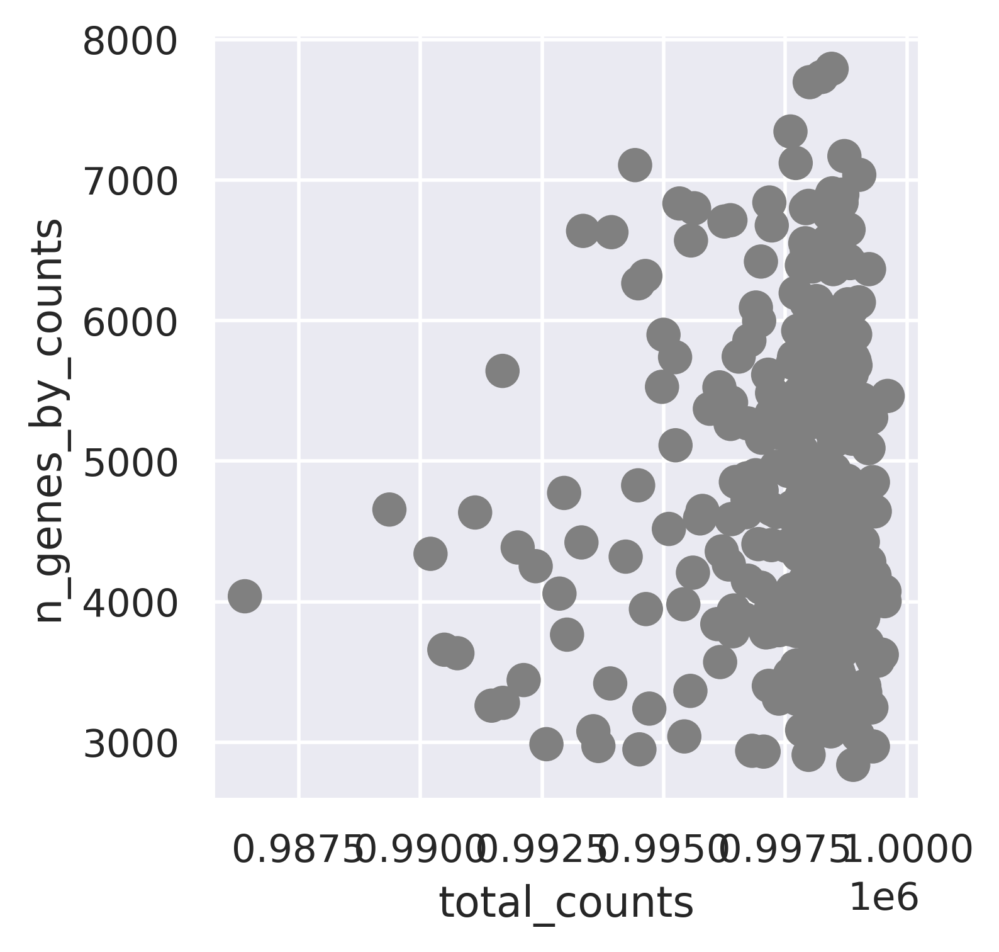

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (312, 13706)
716
#----------------------------------------------
Deal with MGH104...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (355, 19135)


<Figure size 3000x600 with 0 Axes>

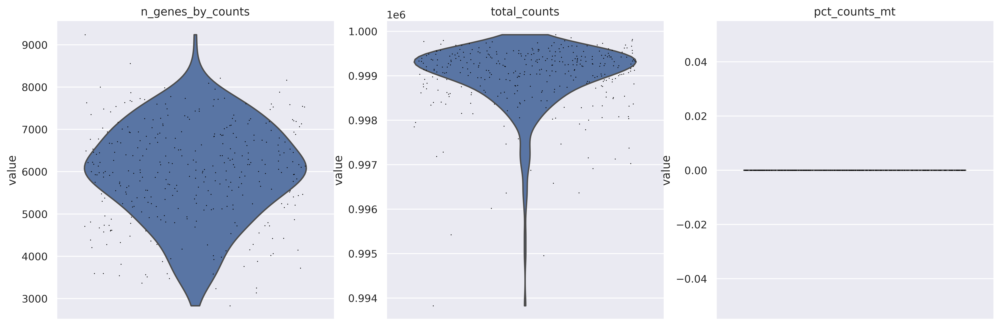

<Figure size 1600x1200 with 0 Axes>

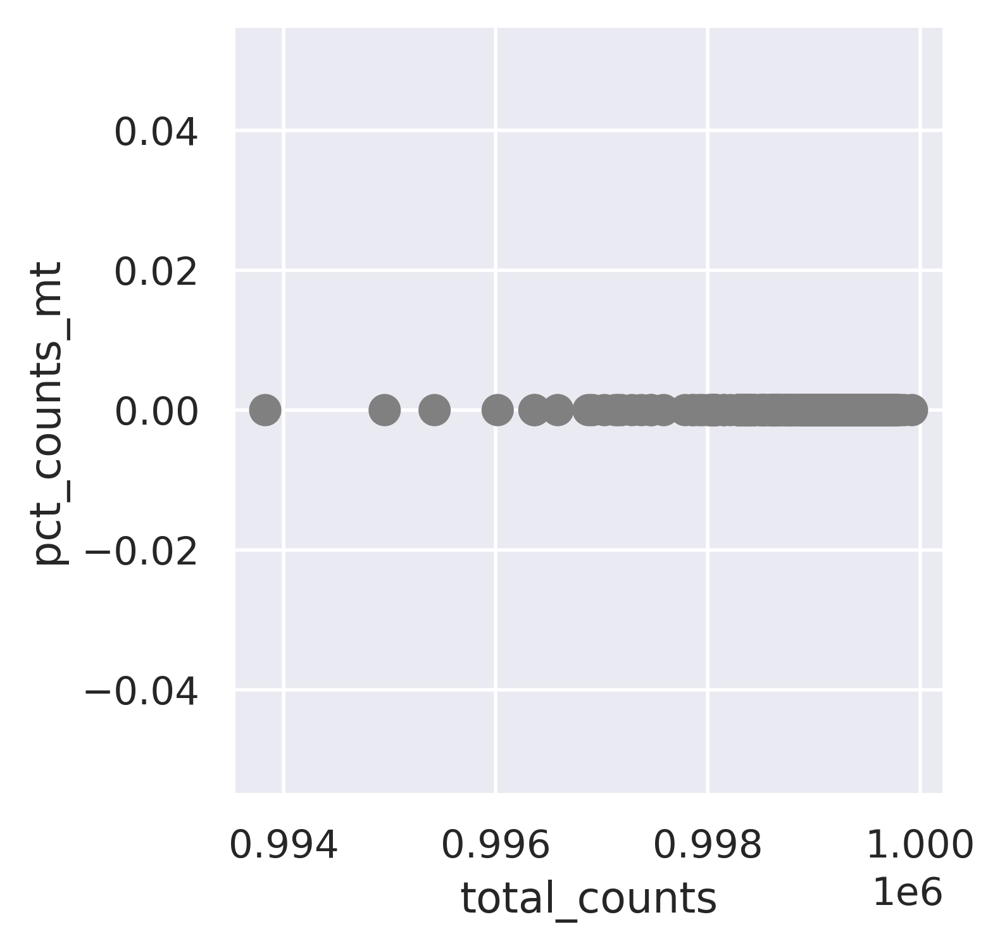

<Figure size 1600x1200 with 0 Axes>

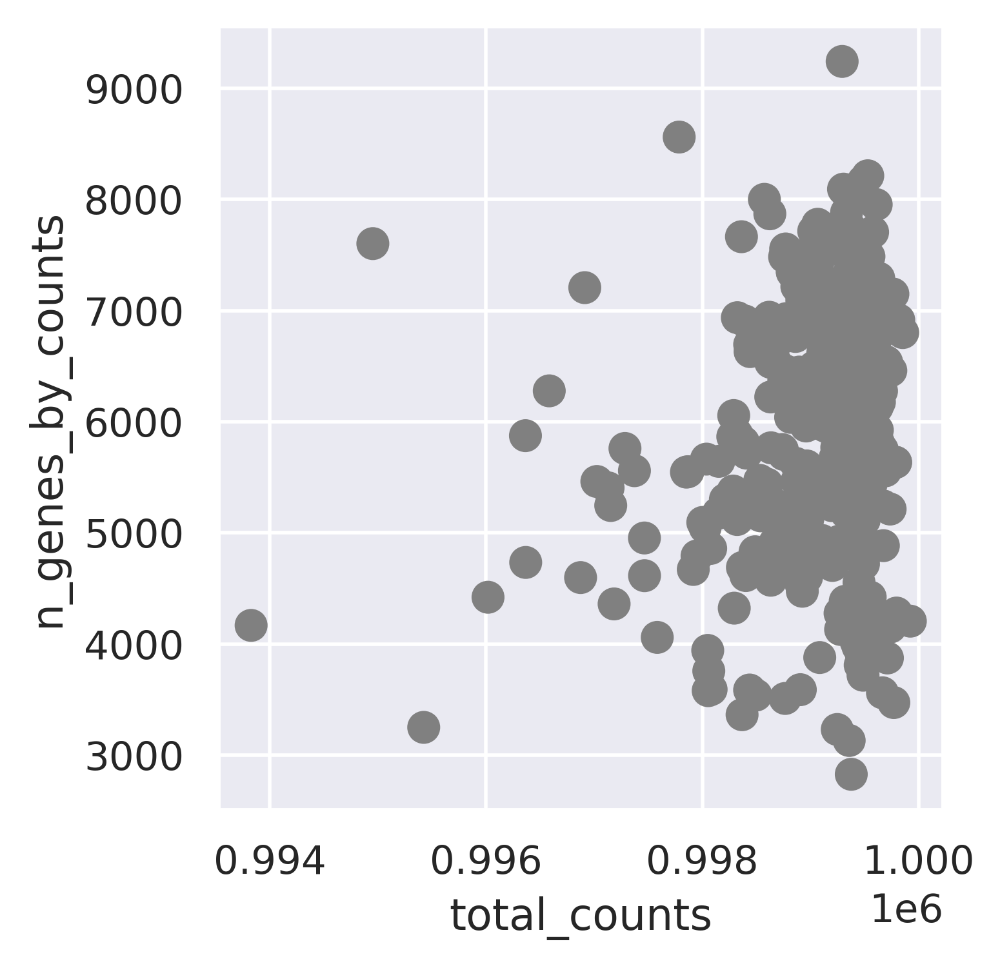

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (350, 13450)
1066
#----------------------------------------------
Deal with MGH105...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (634, 19135)


<Figure size 3000x600 with 0 Axes>

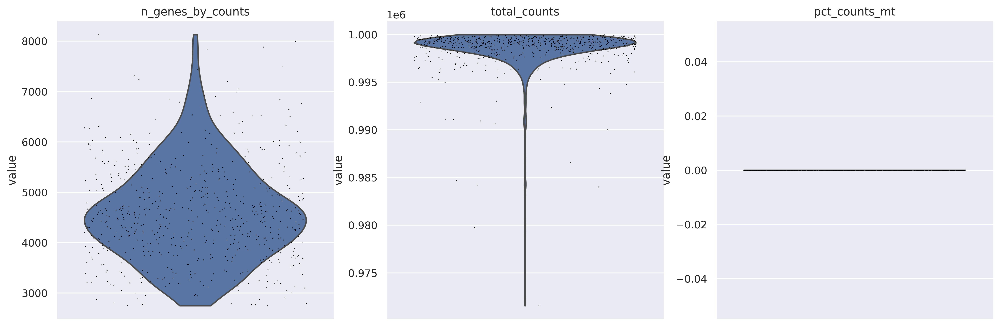

<Figure size 1600x1200 with 0 Axes>

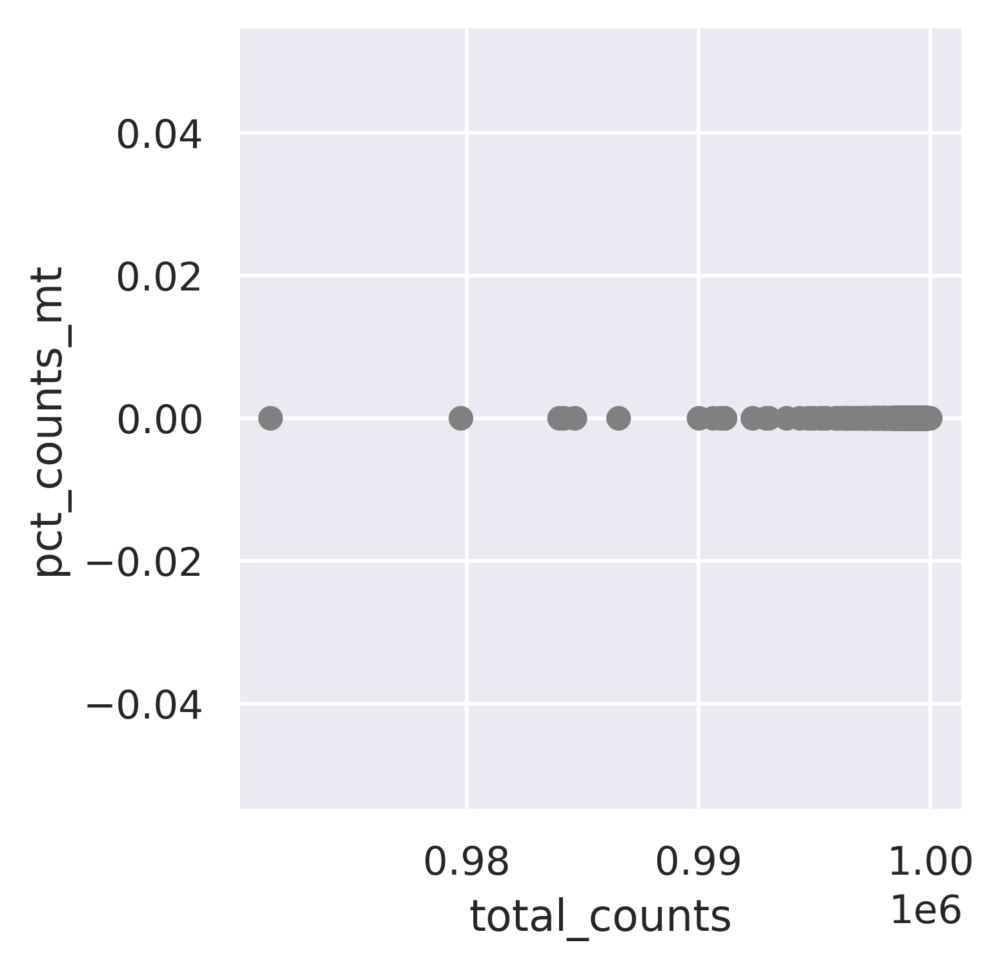

<Figure size 1600x1200 with 0 Axes>

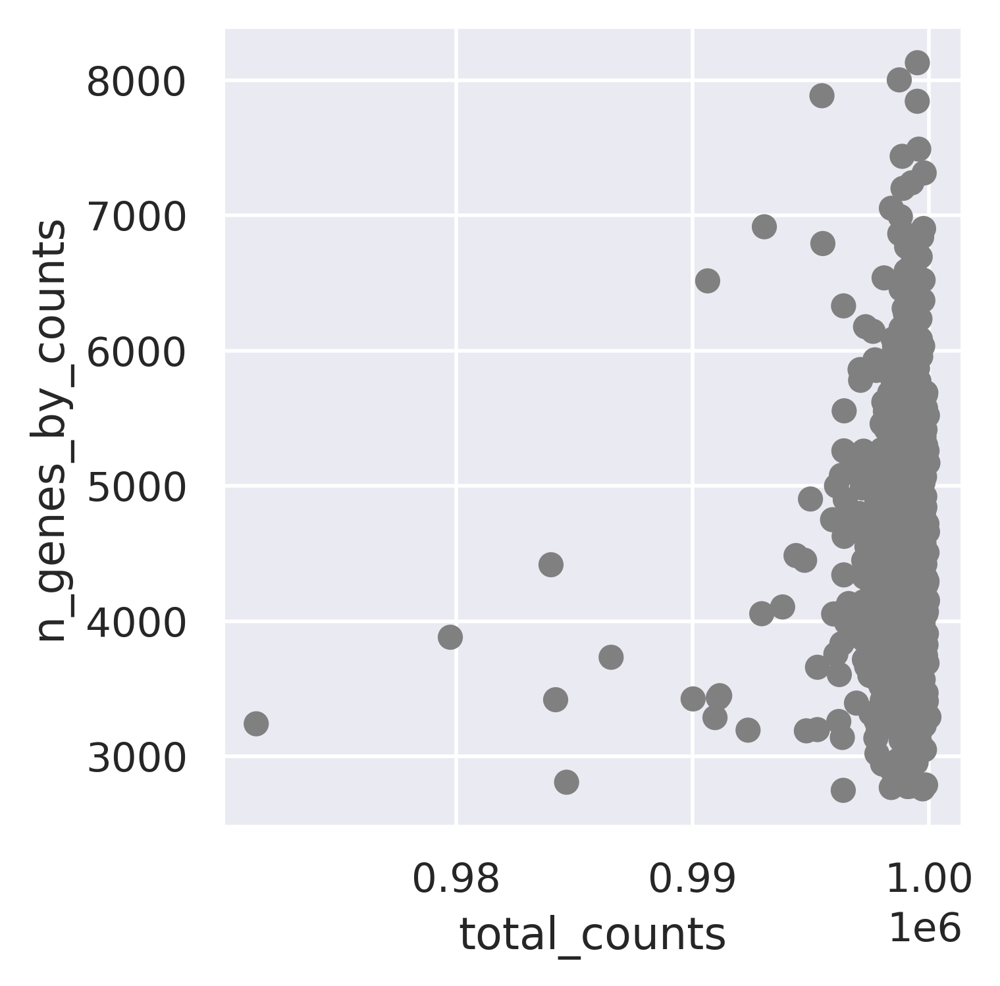

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (632, 14716)
1698
#----------------------------------------------
Deal with MGH106...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (200, 19135)


<Figure size 3000x600 with 0 Axes>

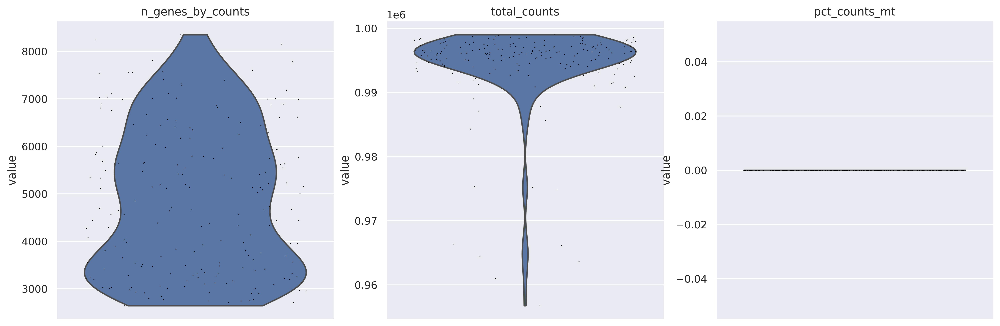

<Figure size 1600x1200 with 0 Axes>

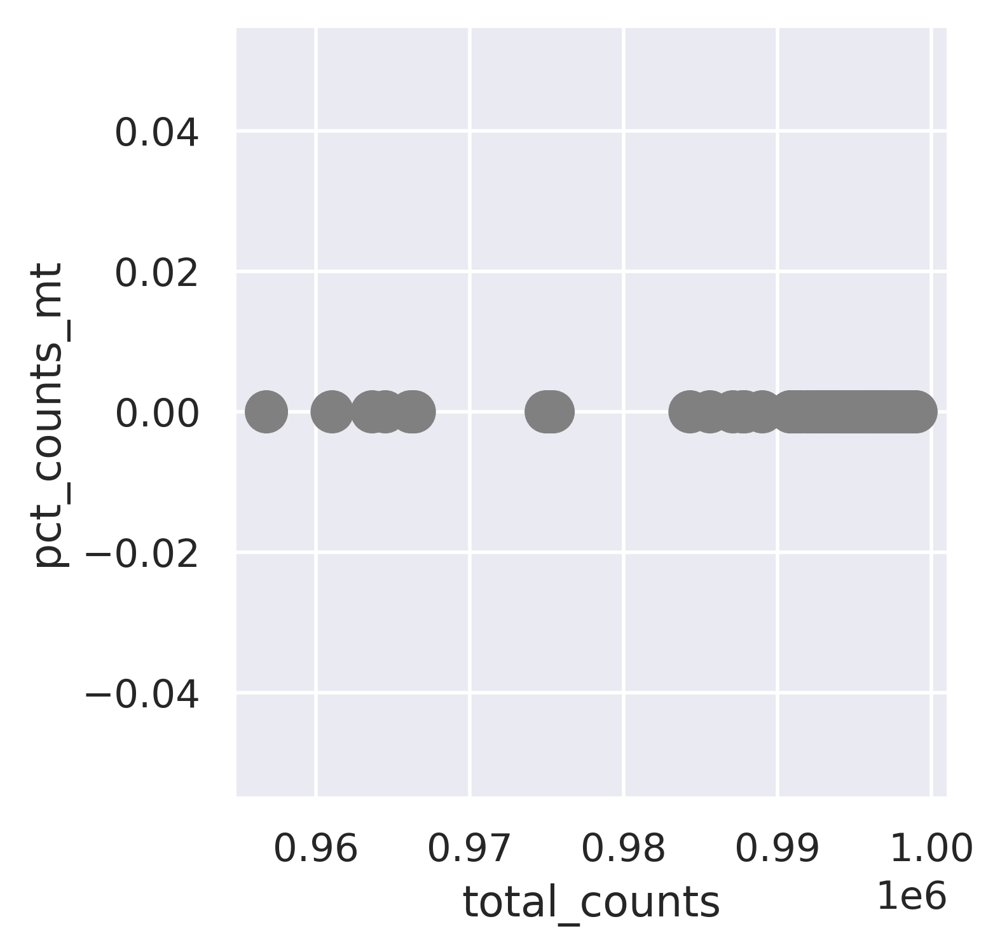

<Figure size 1600x1200 with 0 Axes>

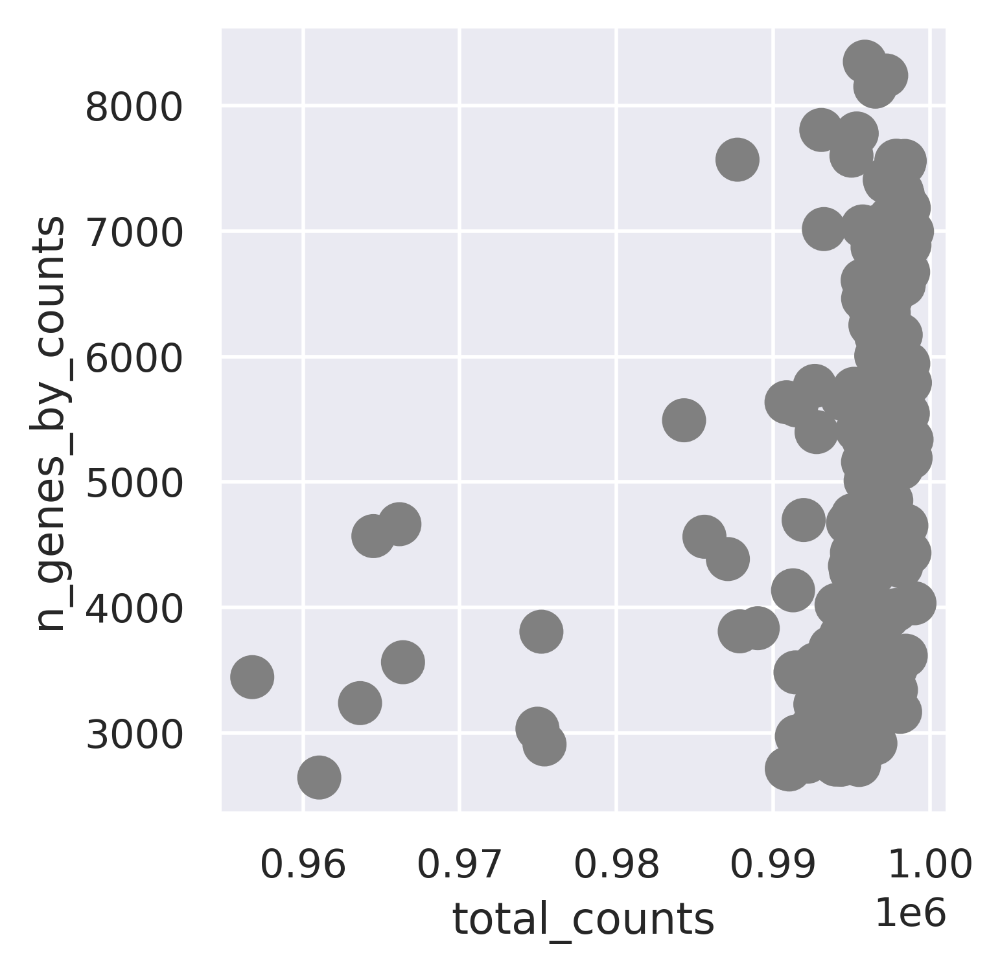

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (197, 12753)
1895
#----------------------------------------------
Deal with MGH110...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (359, 19135)


<Figure size 3000x600 with 0 Axes>

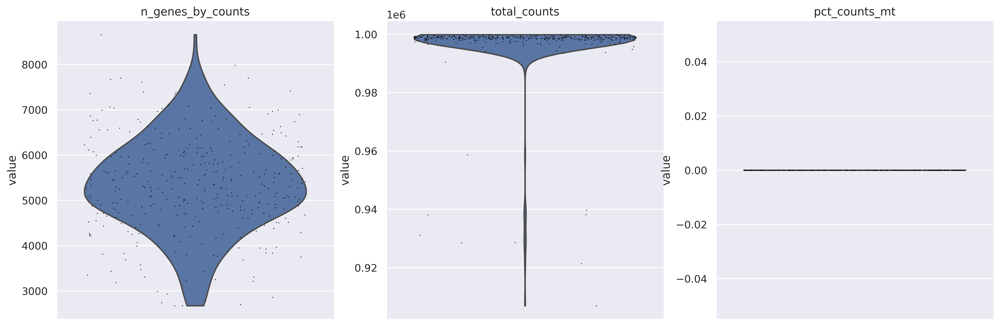

<Figure size 1600x1200 with 0 Axes>

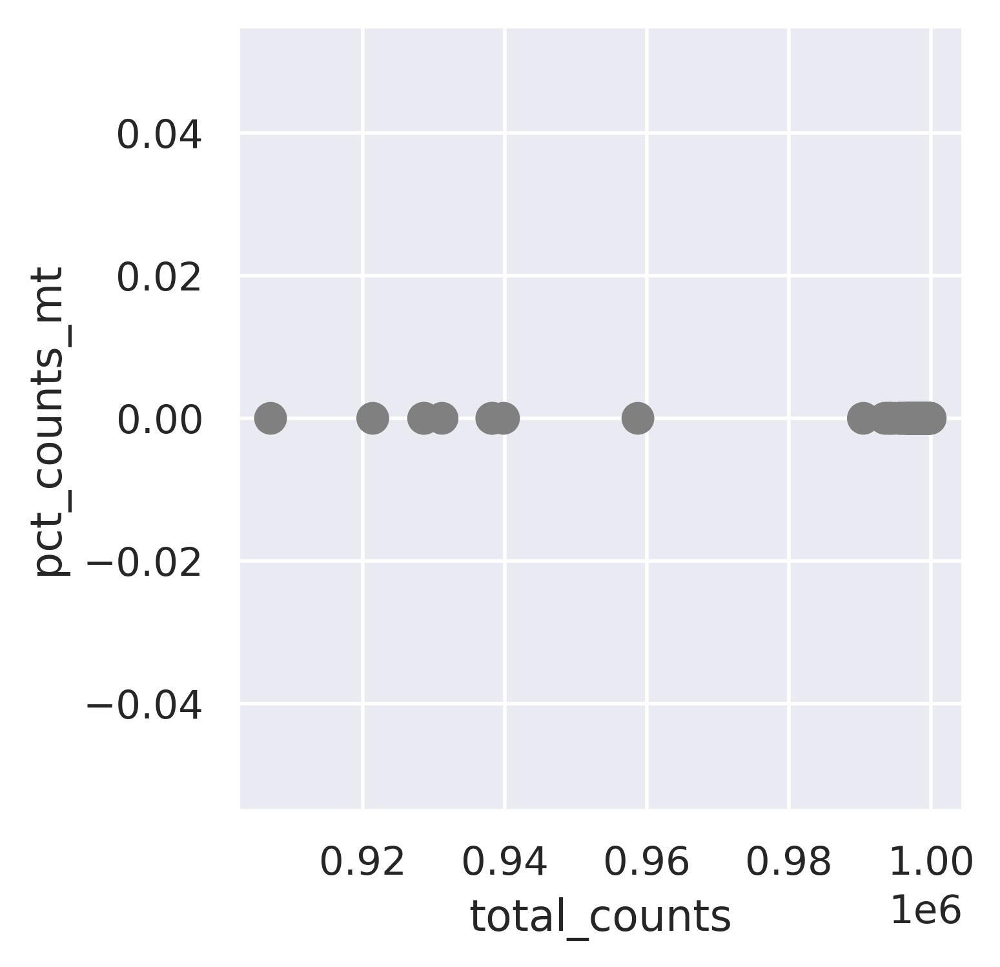

<Figure size 1600x1200 with 0 Axes>

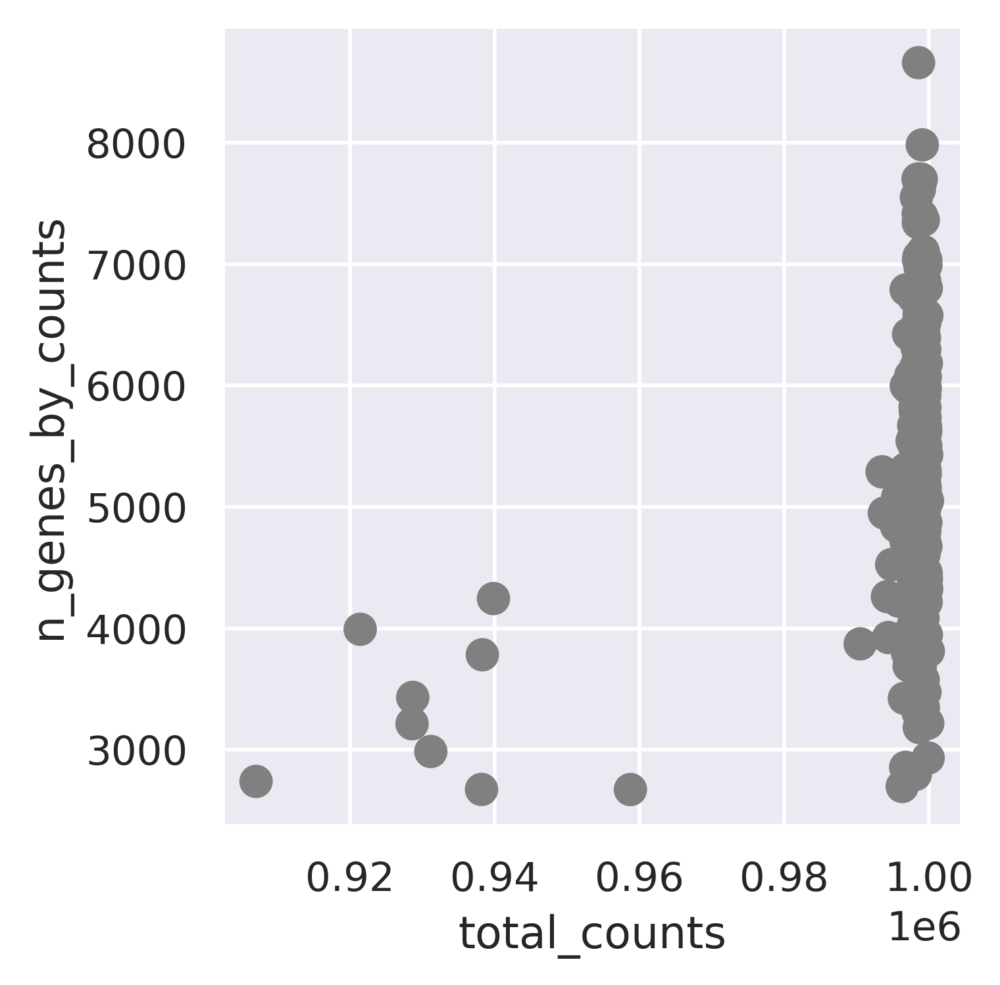

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (358, 13817)
2253
#----------------------------------------------
Deal with MGH113...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (260, 19135)


<Figure size 3000x600 with 0 Axes>

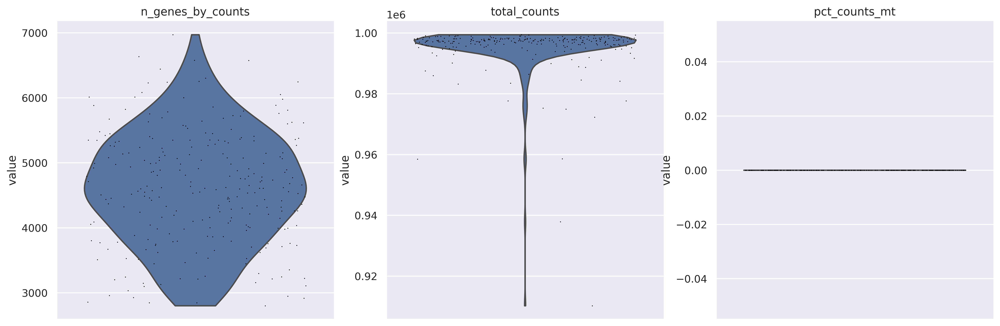

<Figure size 1600x1200 with 0 Axes>

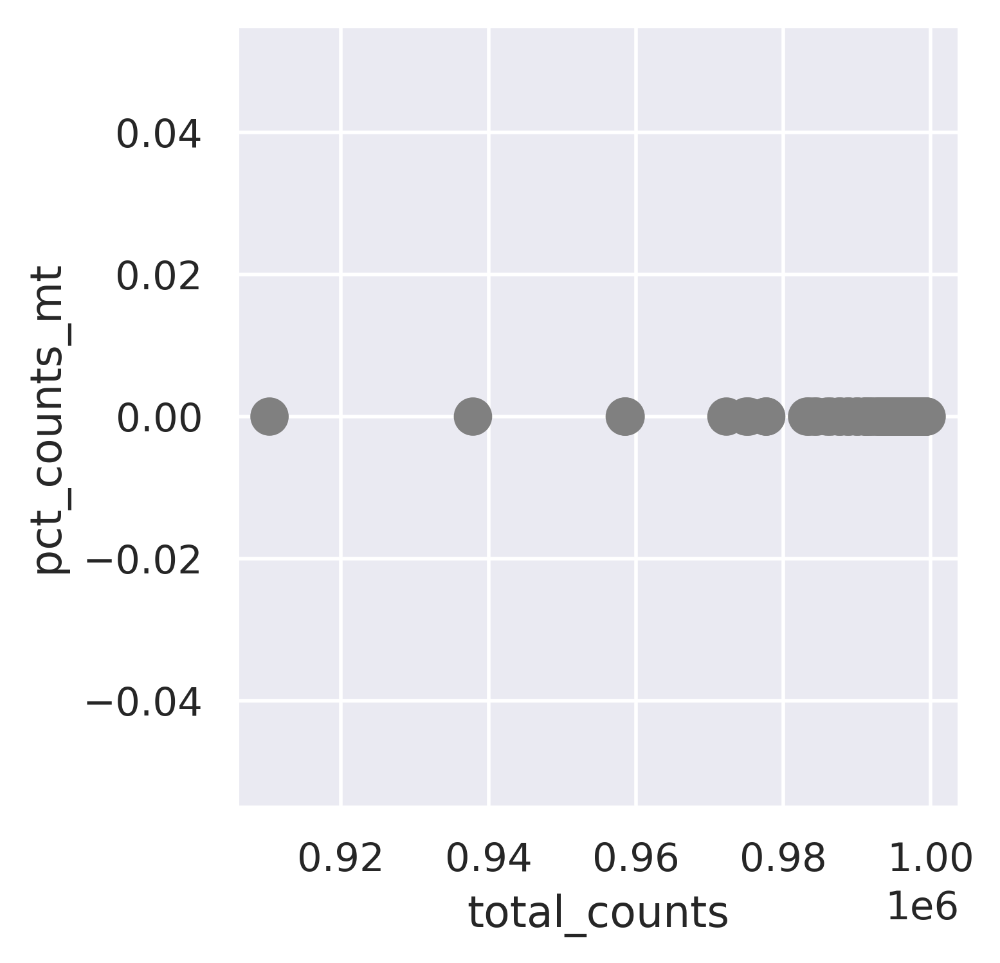

<Figure size 1600x1200 with 0 Axes>

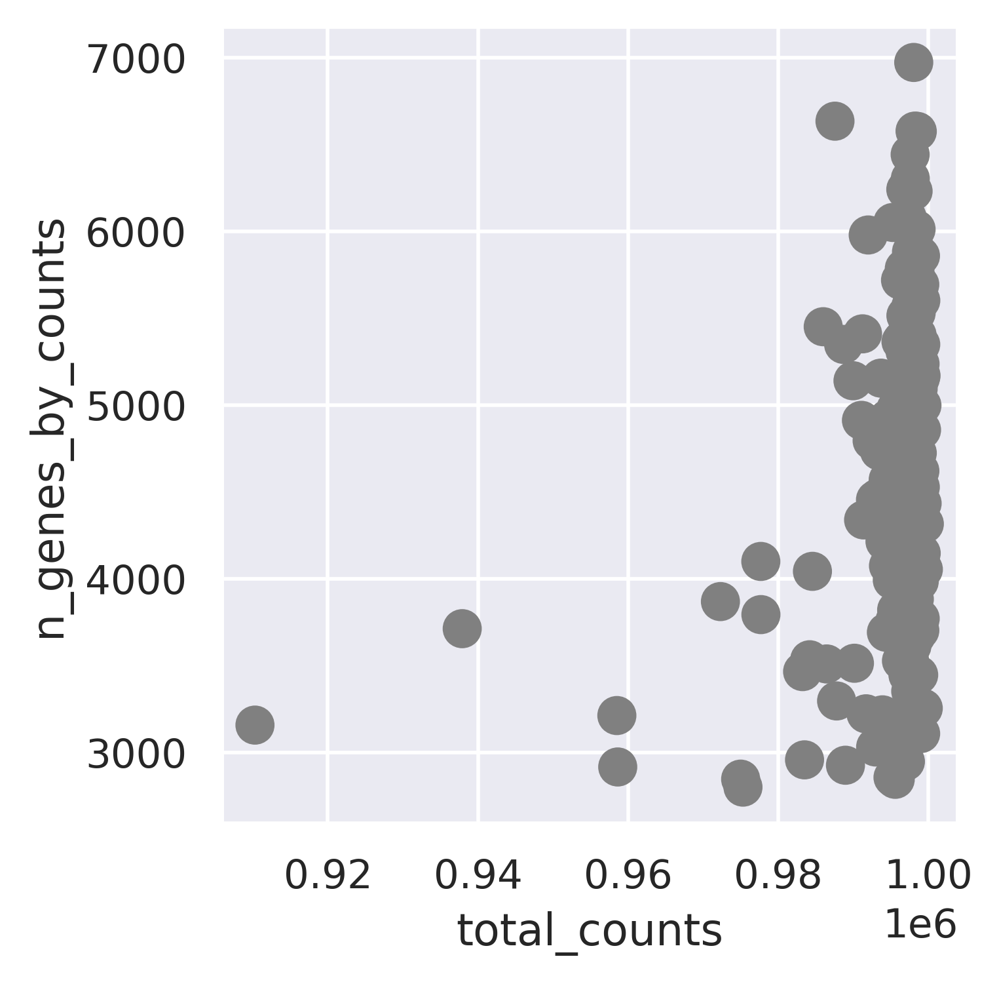

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (260, 13176)
2513
#----------------------------------------------
Deal with MGH115...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (165, 19135)


<Figure size 3000x600 with 0 Axes>

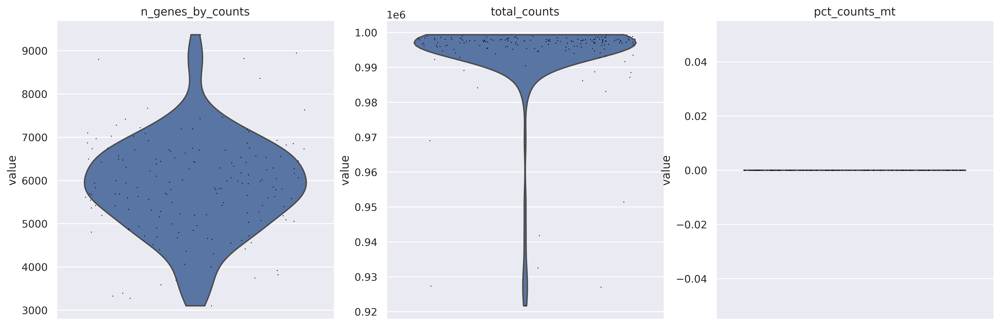

<Figure size 1600x1200 with 0 Axes>

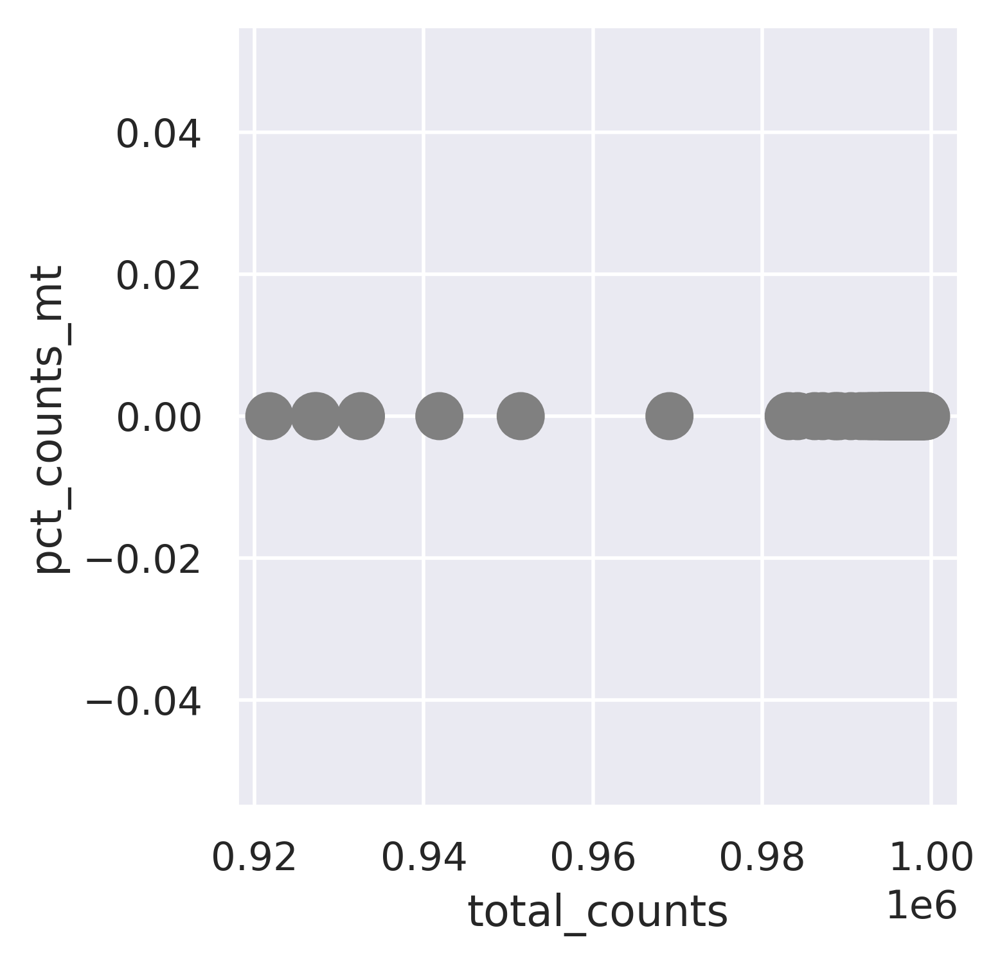

<Figure size 1600x1200 with 0 Axes>

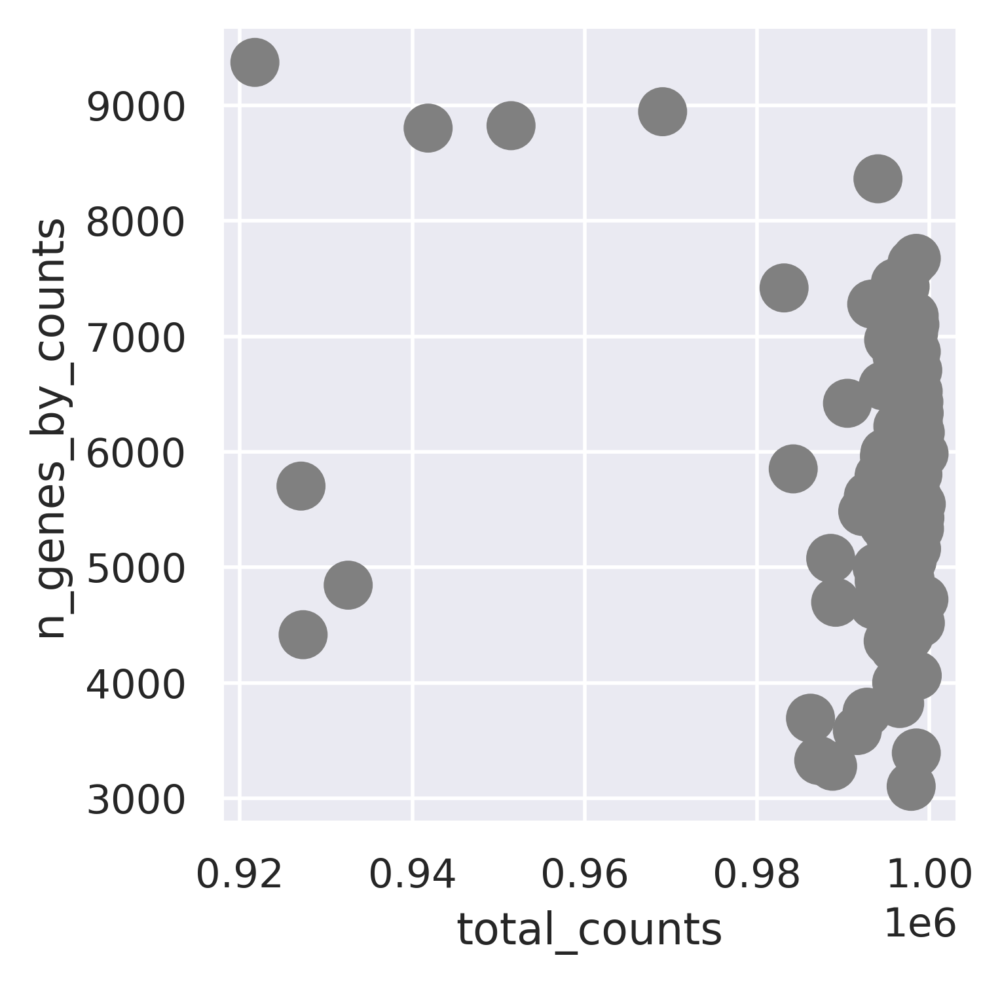

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (160, 12662)
2673
#----------------------------------------------
Deal with MGH121...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (297, 19135)


<Figure size 3000x600 with 0 Axes>

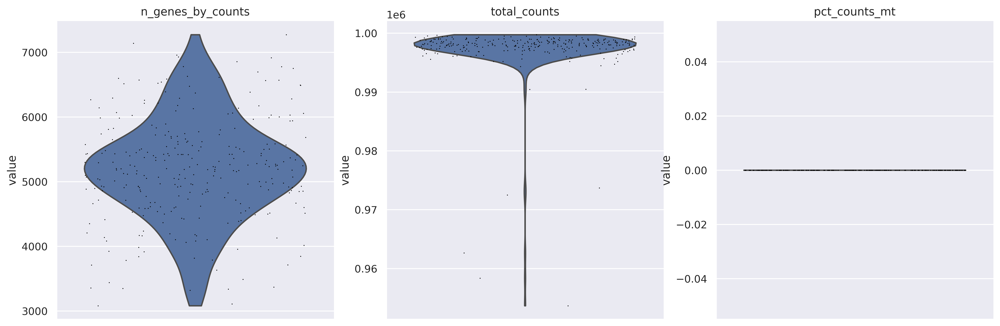

<Figure size 1600x1200 with 0 Axes>

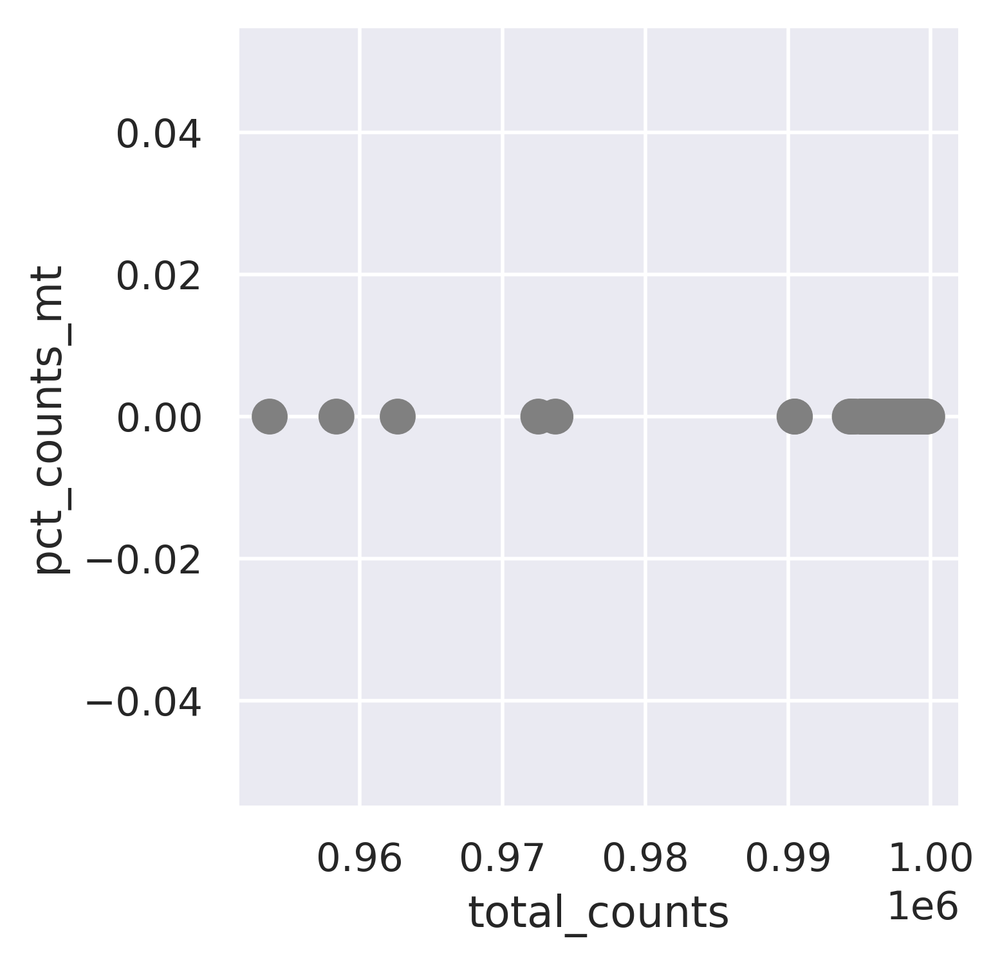

<Figure size 1600x1200 with 0 Axes>

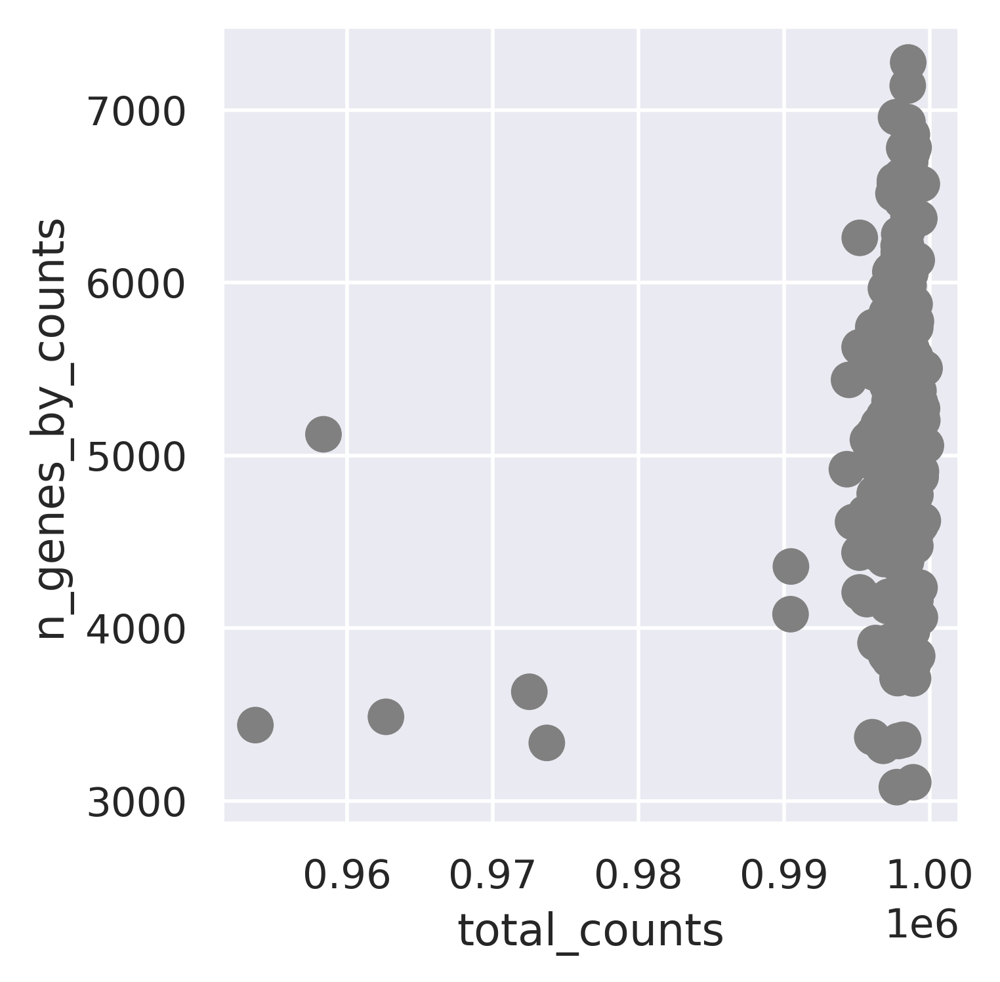

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (297, 13040)
2970
#----------------------------------------------
Deal with MGH122...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (273, 19135)


<Figure size 3000x600 with 0 Axes>

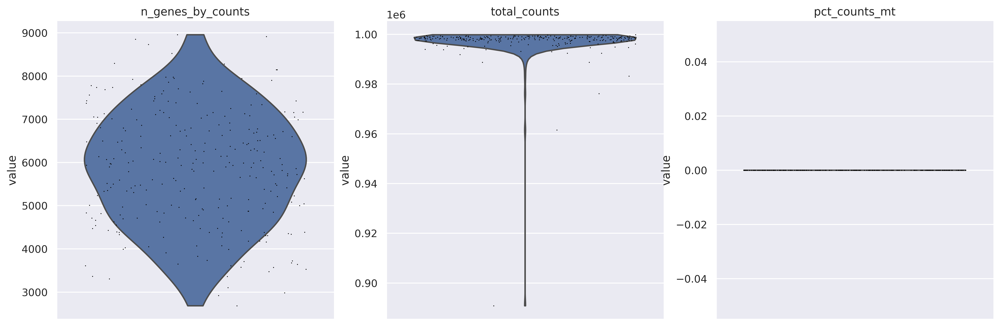

<Figure size 1600x1200 with 0 Axes>

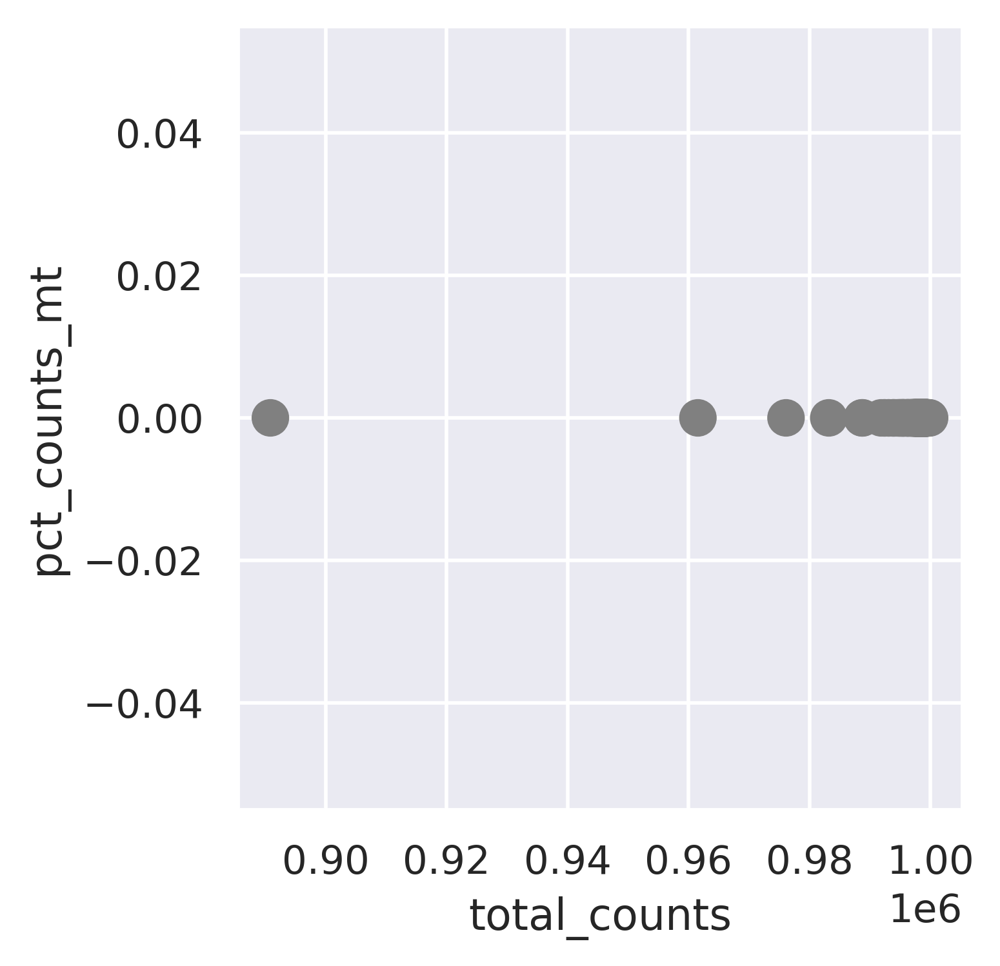

<Figure size 1600x1200 with 0 Axes>

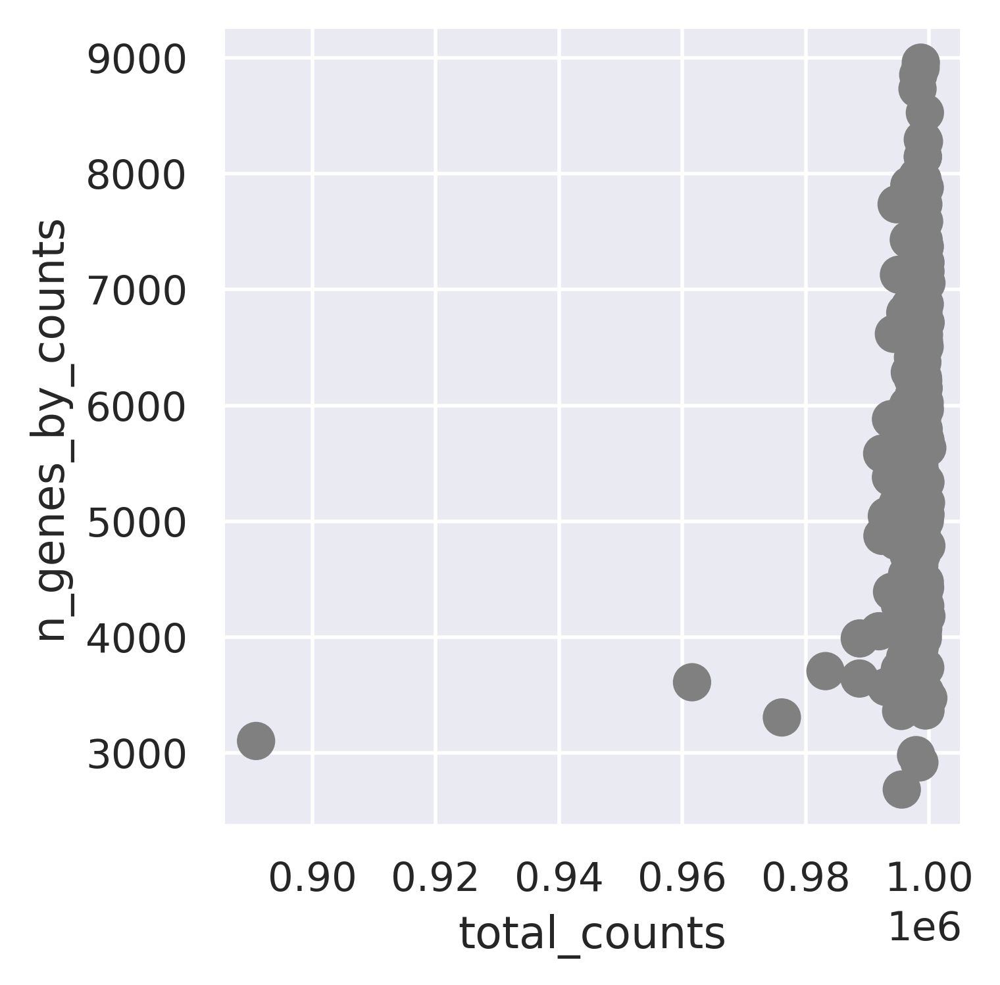

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (264, 14140)
3234
#----------------------------------------------
Deal with MGH124...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (370, 19135)


<Figure size 3000x600 with 0 Axes>

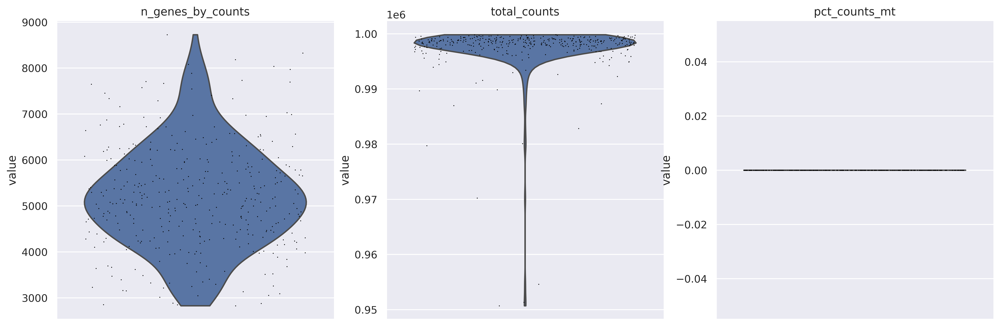

<Figure size 1600x1200 with 0 Axes>

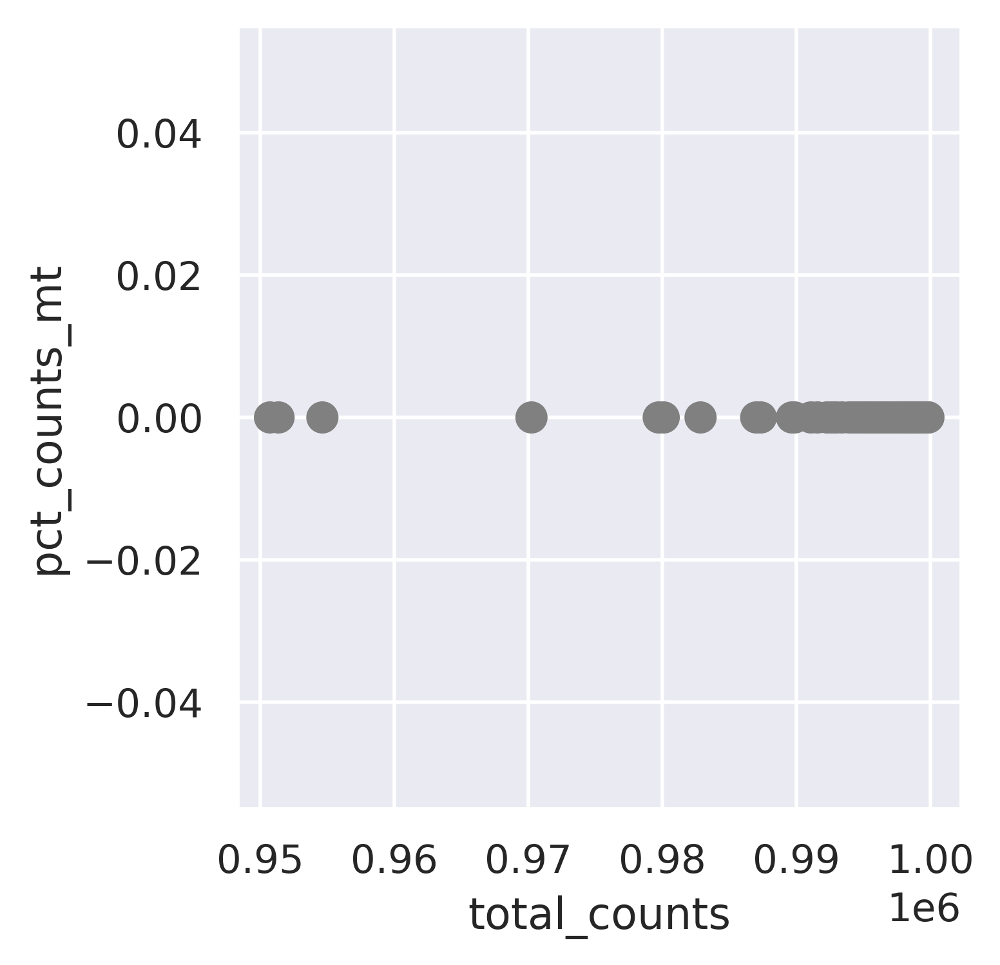

<Figure size 1600x1200 with 0 Axes>

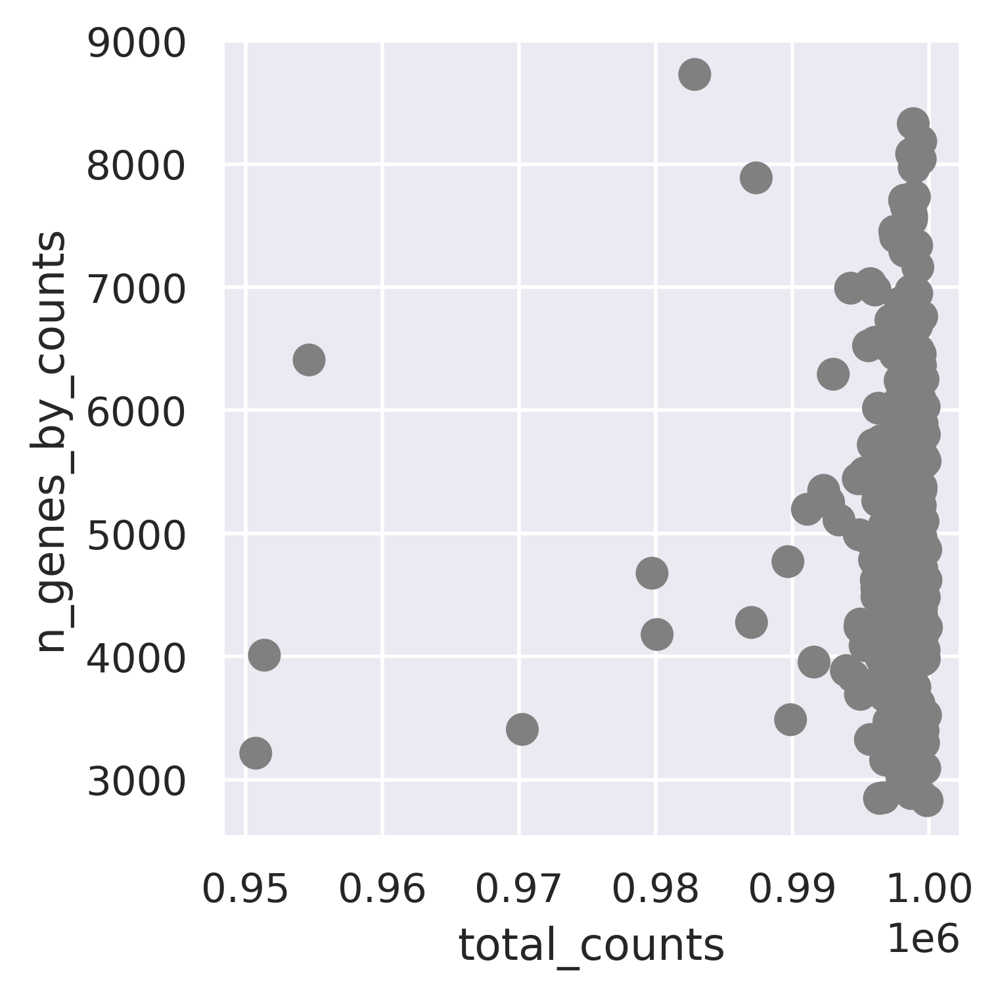

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (365, 14161)
3599
#----------------------------------------------
Deal with MGH125...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (399, 19135)


<Figure size 3000x600 with 0 Axes>

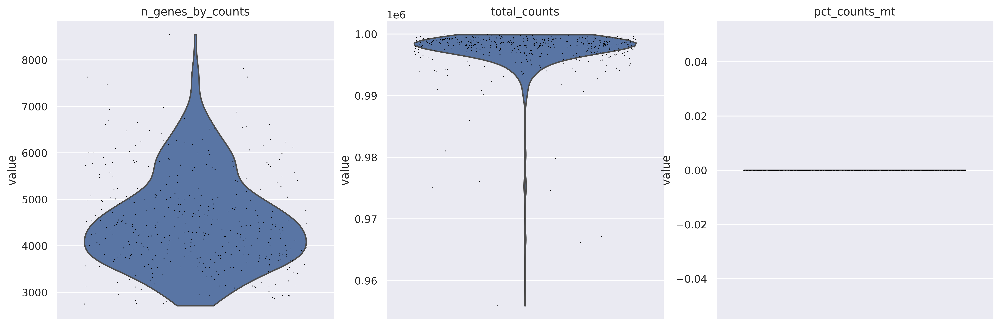

<Figure size 1600x1200 with 0 Axes>

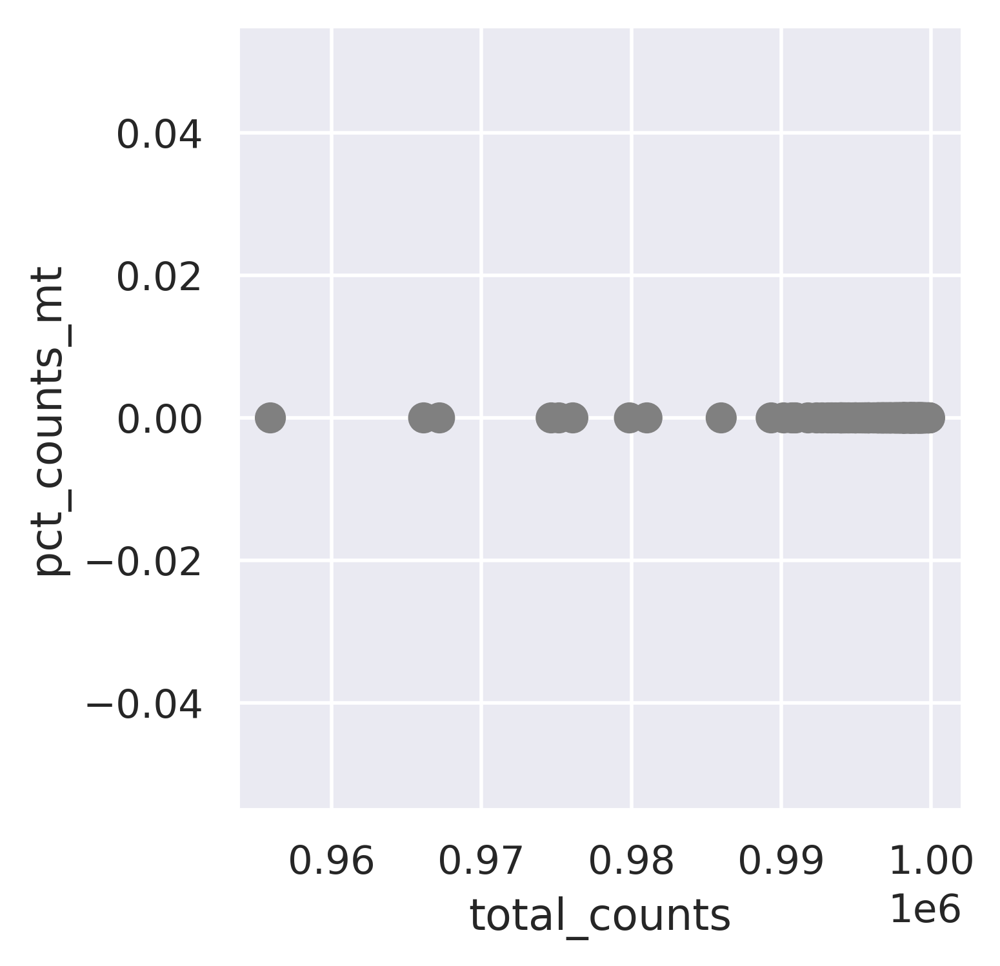

<Figure size 1600x1200 with 0 Axes>

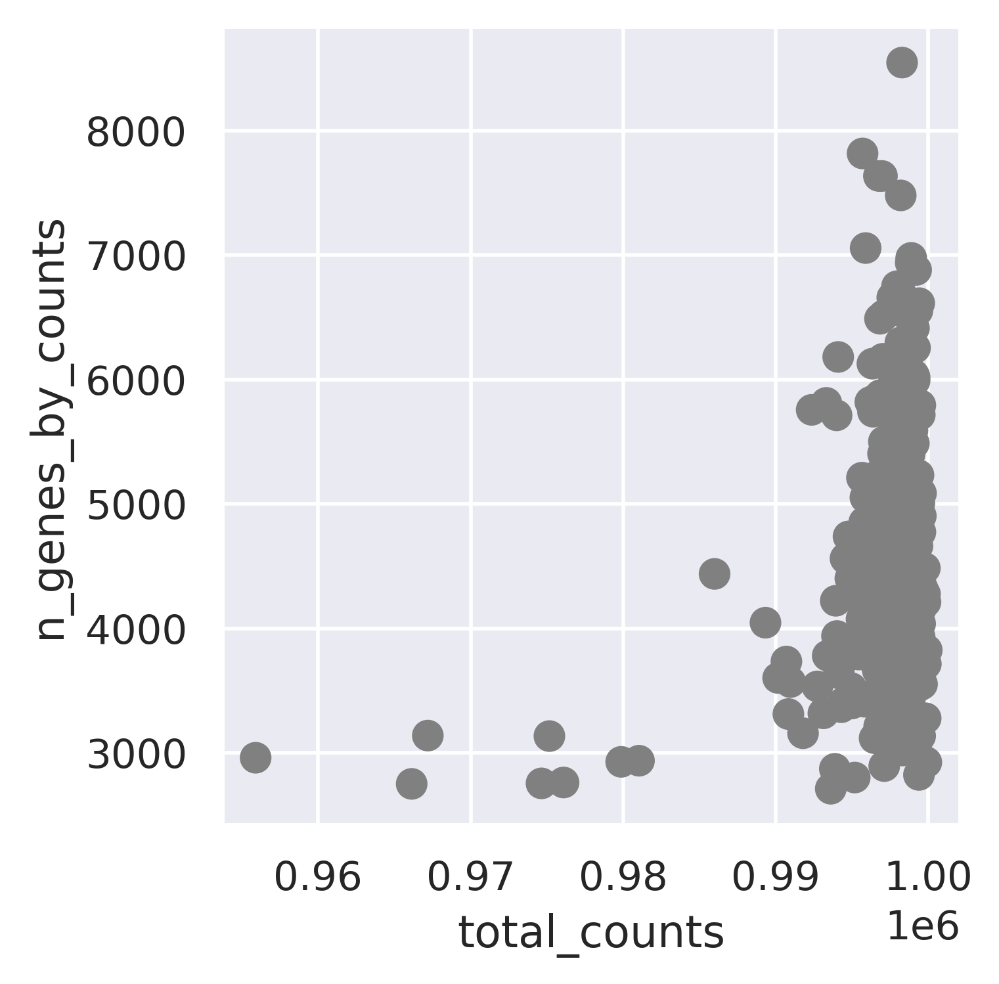

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (398, 13768)
3997
#----------------------------------------------
Deal with BT749...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (317, 19135)


<Figure size 3000x600 with 0 Axes>

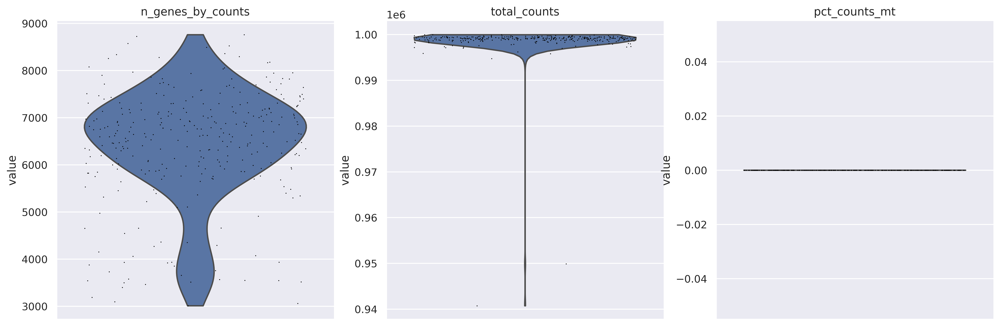

<Figure size 1600x1200 with 0 Axes>

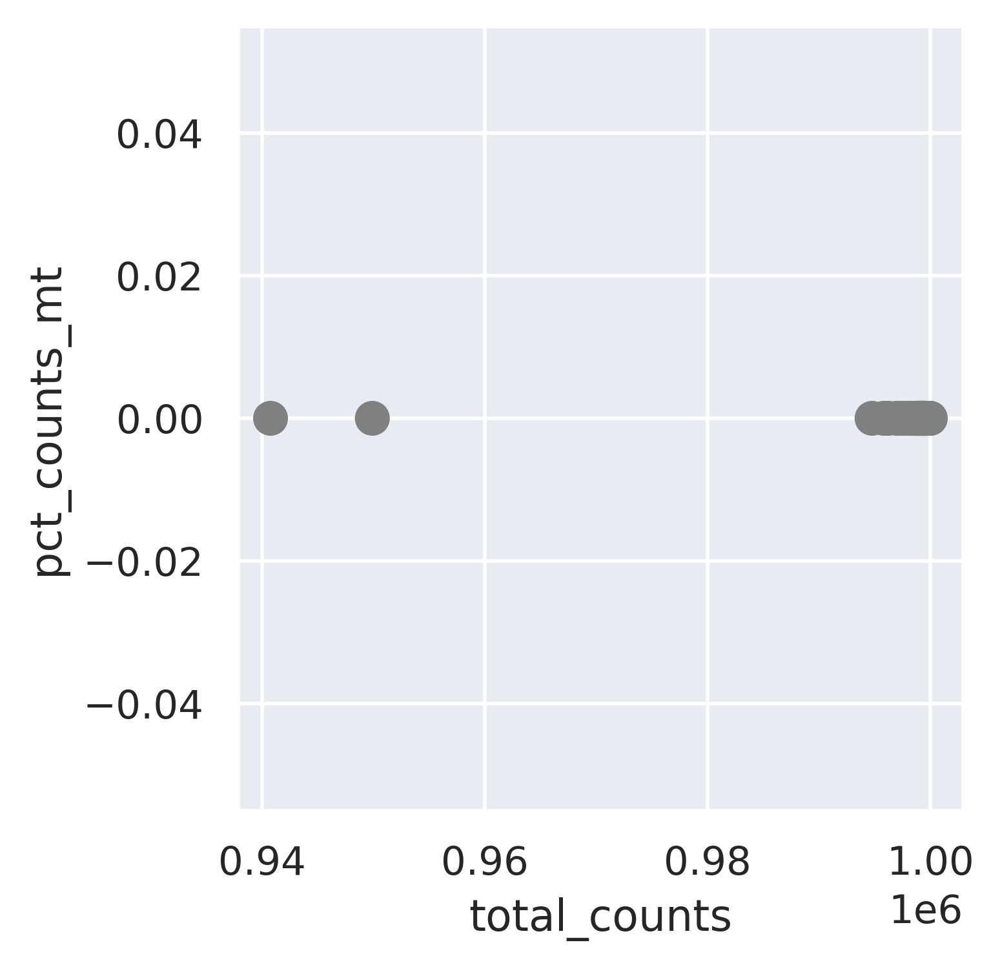

<Figure size 1600x1200 with 0 Axes>

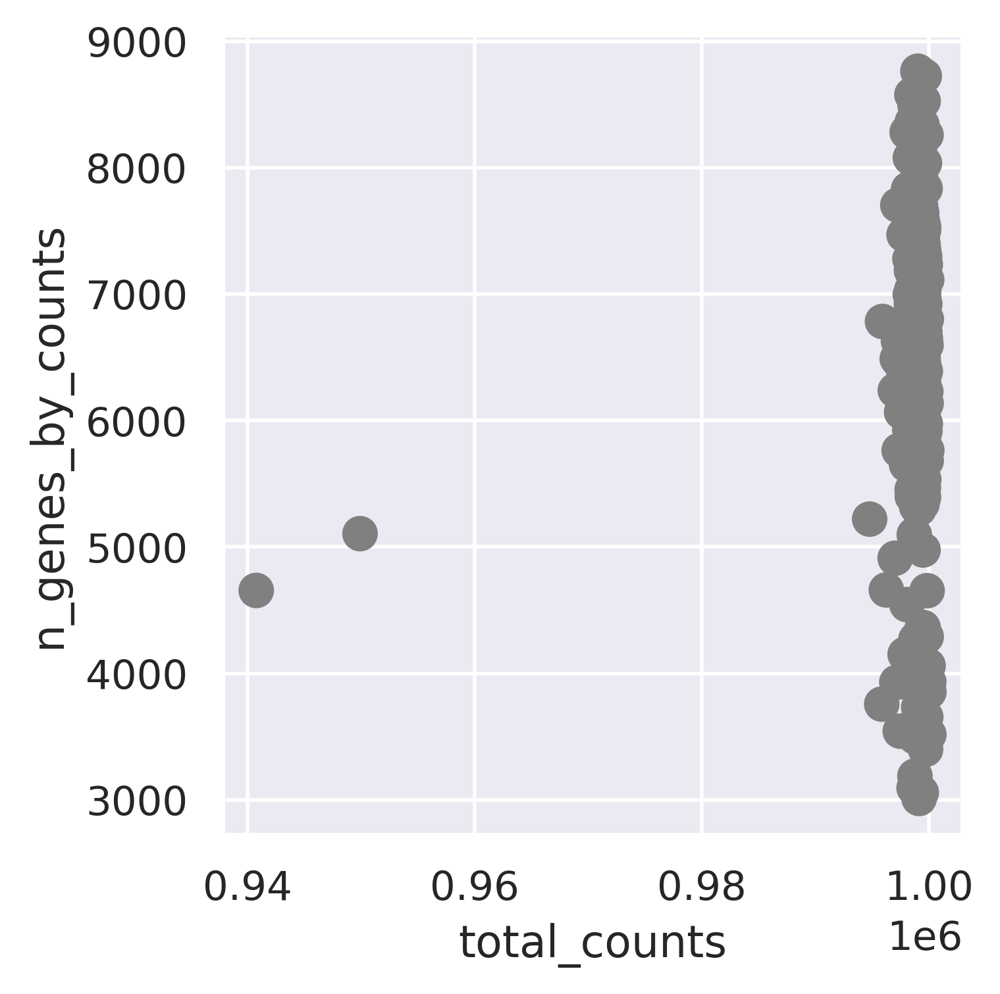

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (302, 13592)
4299
#----------------------------------------------
Deal with BT771...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (339, 19135)


<Figure size 3000x600 with 0 Axes>

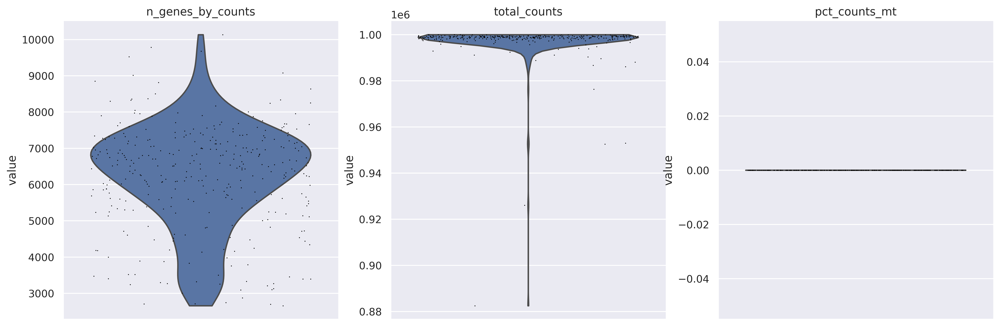

<Figure size 1600x1200 with 0 Axes>

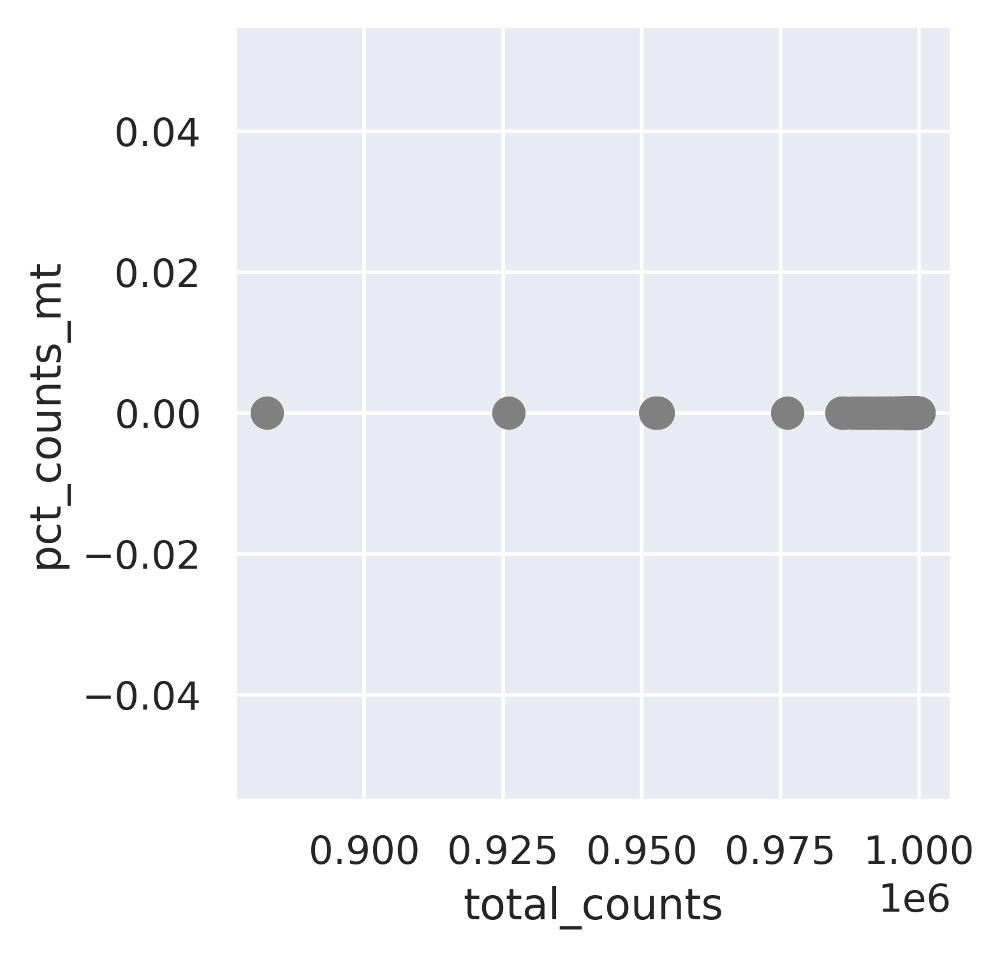

<Figure size 1600x1200 with 0 Axes>

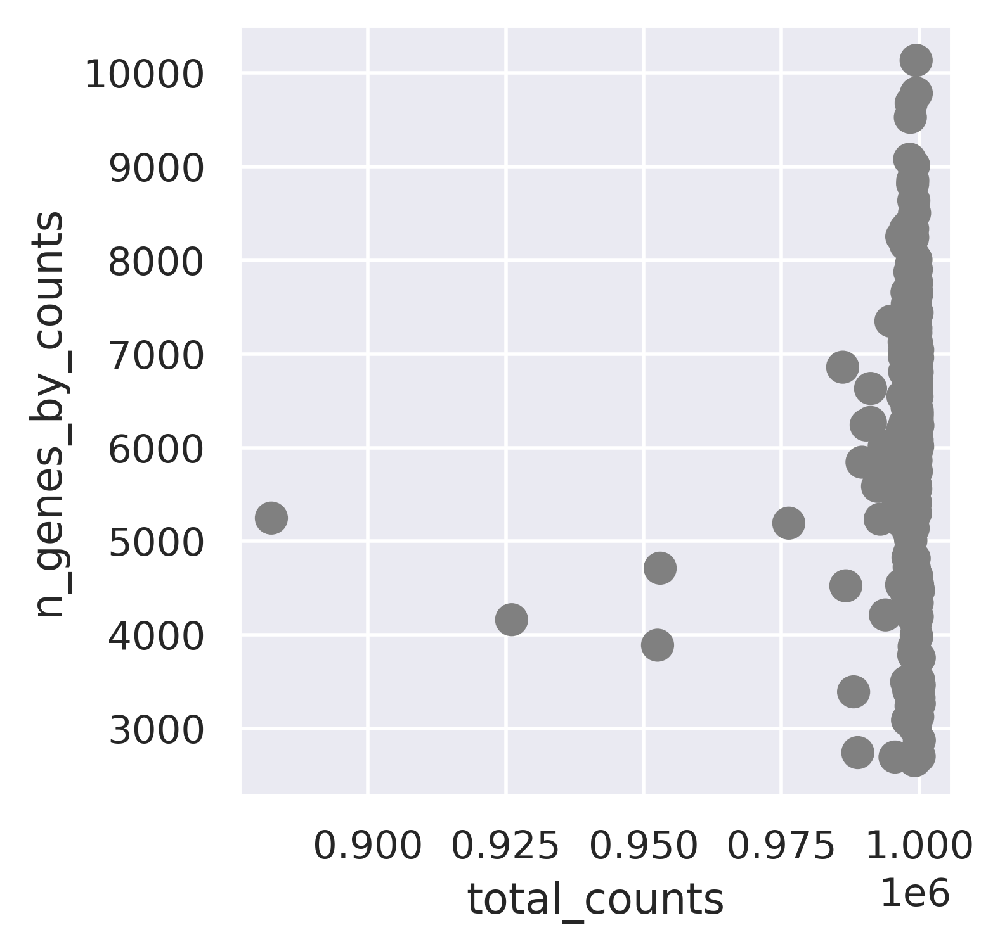

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (319, 14602)
4618
#----------------------------------------------
Deal with BT830...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (220, 19135)


<Figure size 3000x600 with 0 Axes>

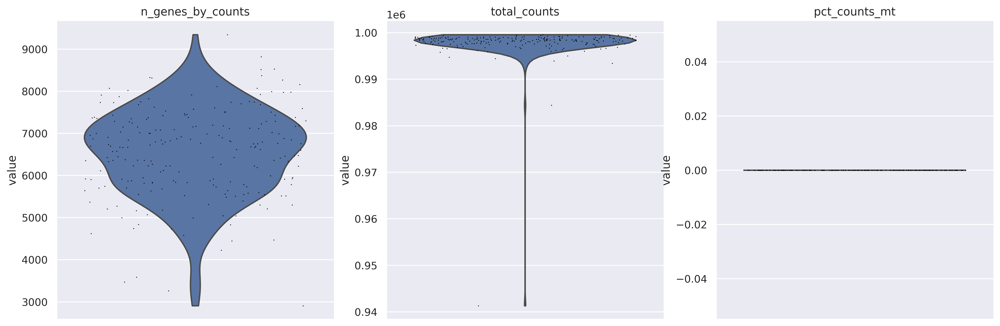

<Figure size 1600x1200 with 0 Axes>

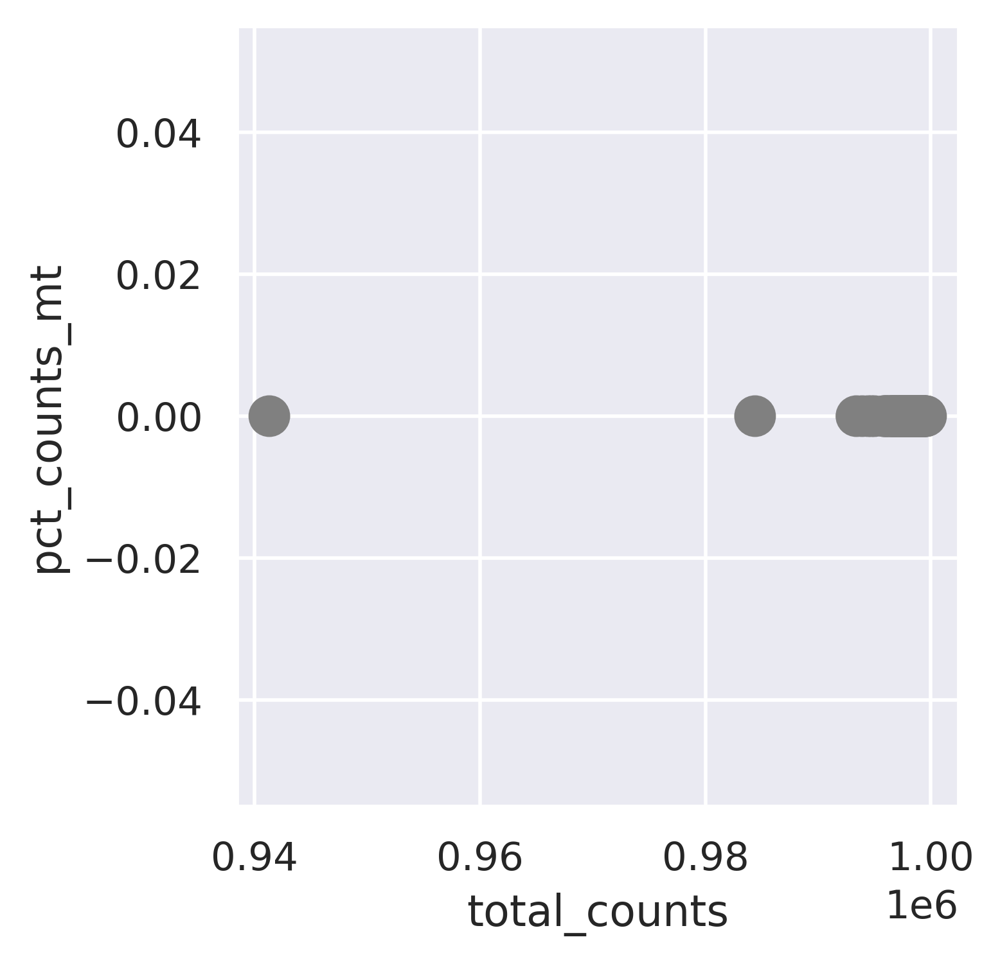

<Figure size 1600x1200 with 0 Axes>

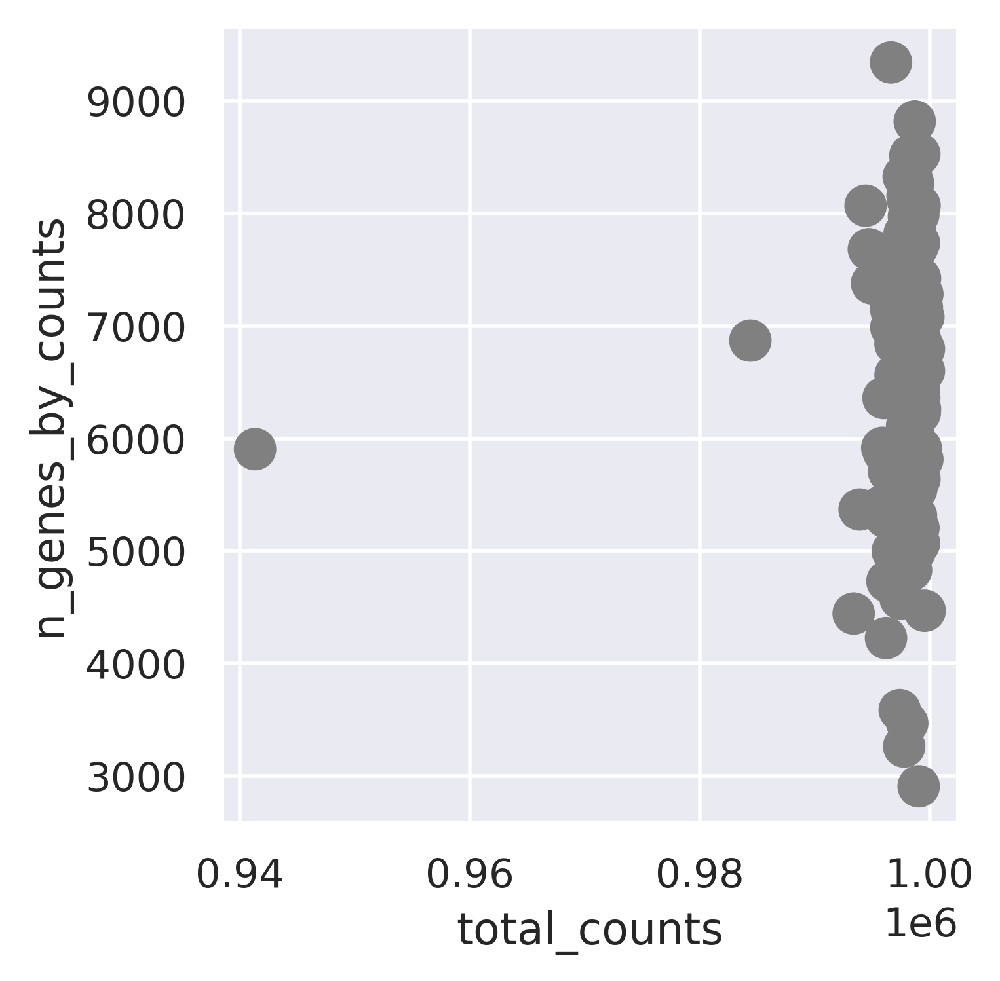

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (207, 13333)
4825
#----------------------------------------------
Deal with BT85...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (245, 19135)


<Figure size 3000x600 with 0 Axes>

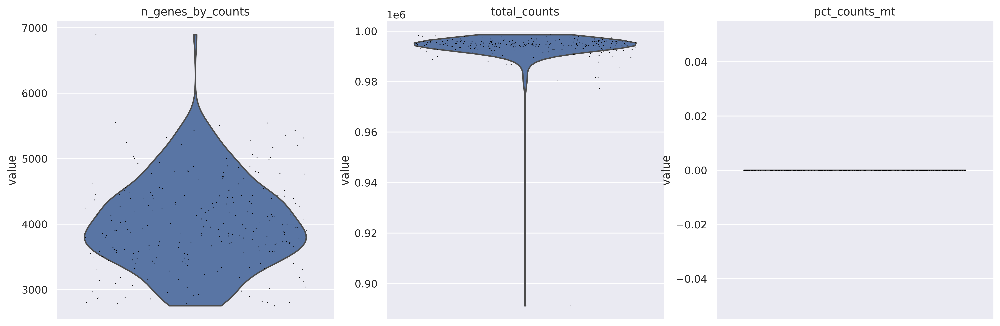

<Figure size 1600x1200 with 0 Axes>

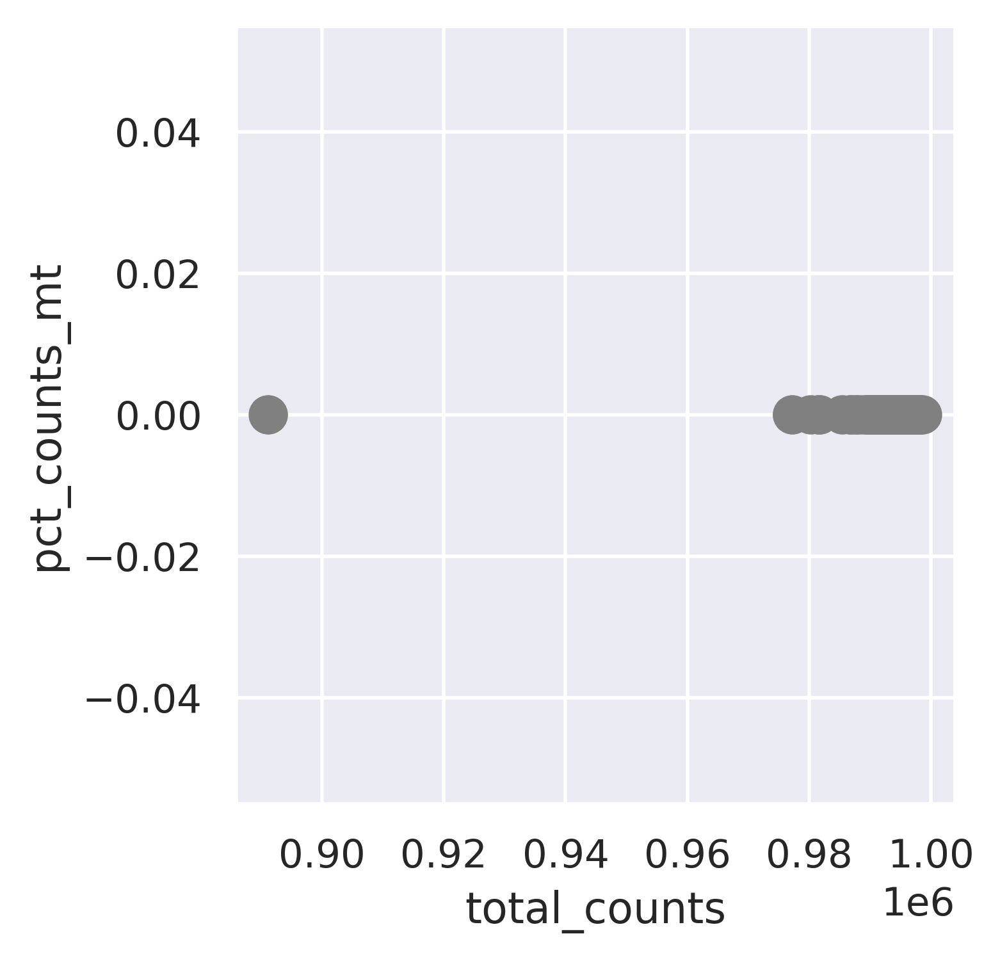

<Figure size 1600x1200 with 0 Axes>

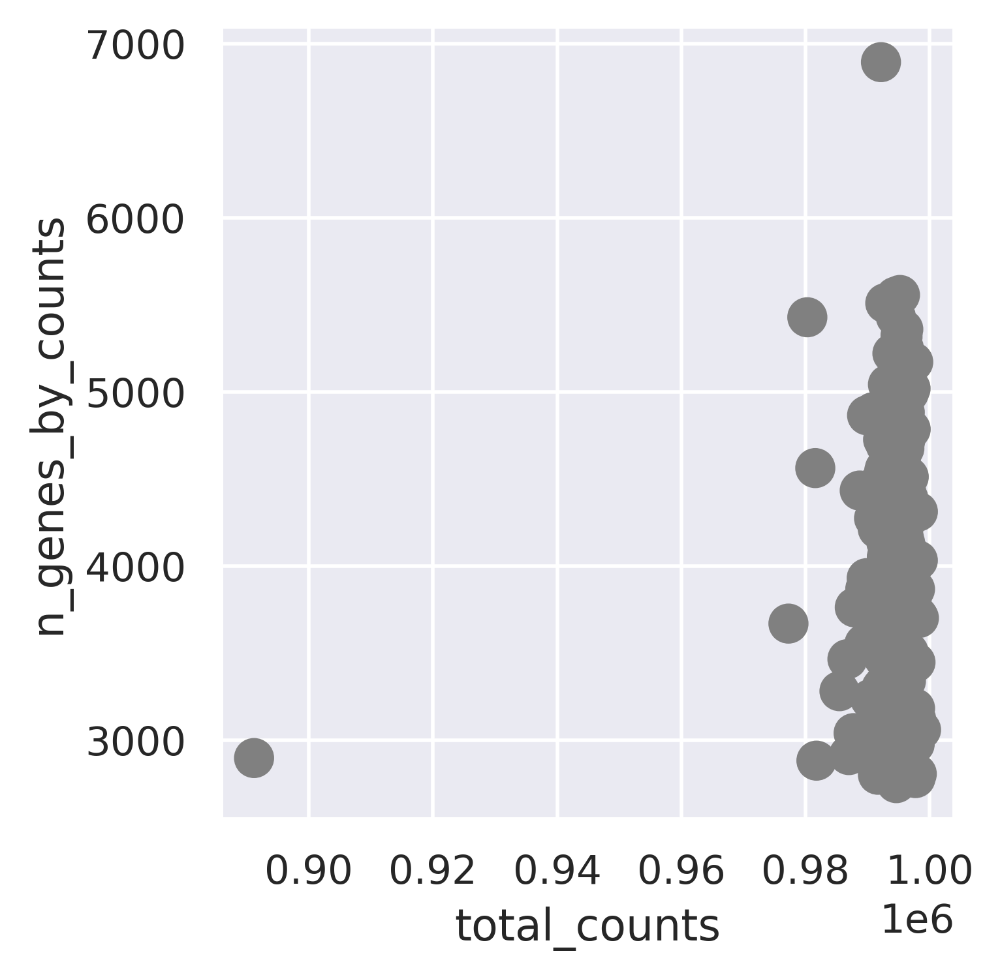

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (245, 11310)
5070
#----------------------------------------------
Deal with BT1160...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (335, 19135)


<Figure size 3000x600 with 0 Axes>

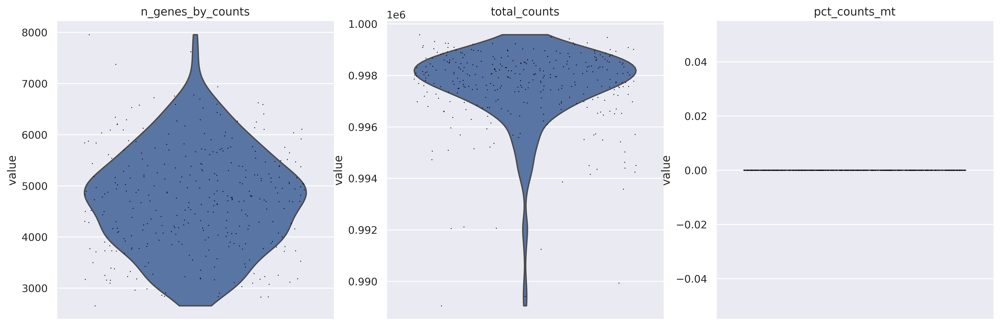

<Figure size 1600x1200 with 0 Axes>

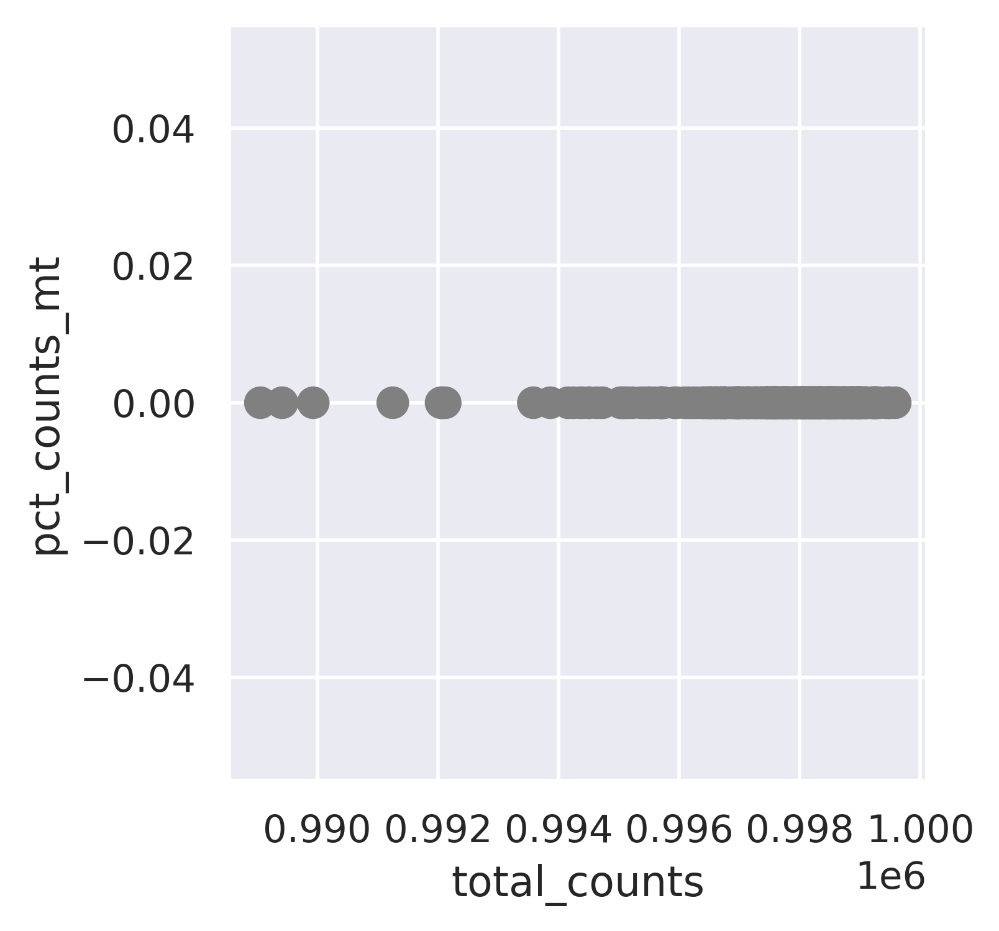

<Figure size 1600x1200 with 0 Axes>

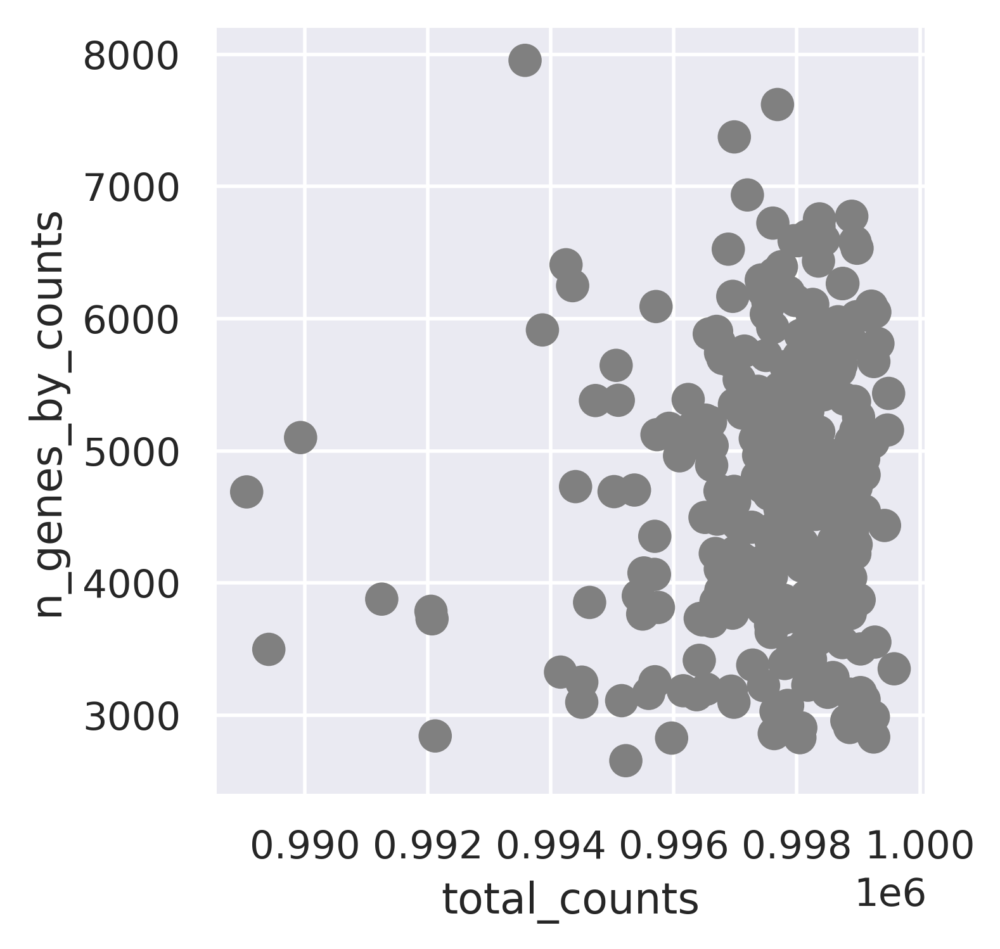

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (335, 12842)
5405
5405
5405
#----------------------------------------------
Deal with BT920...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (301, 19135)


<Figure size 3000x600 with 0 Axes>

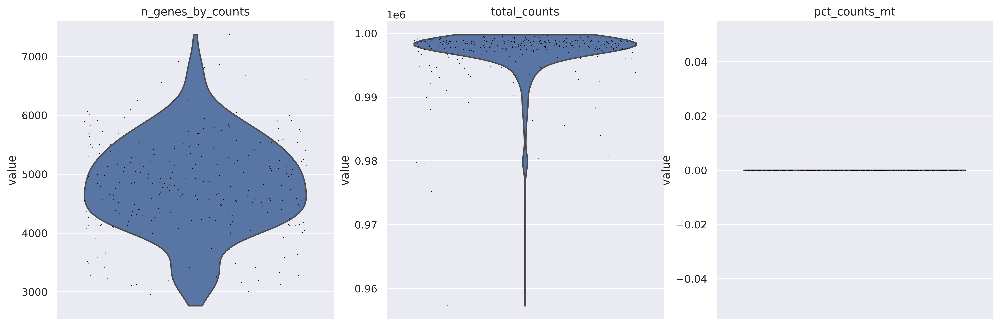

<Figure size 1600x1200 with 0 Axes>

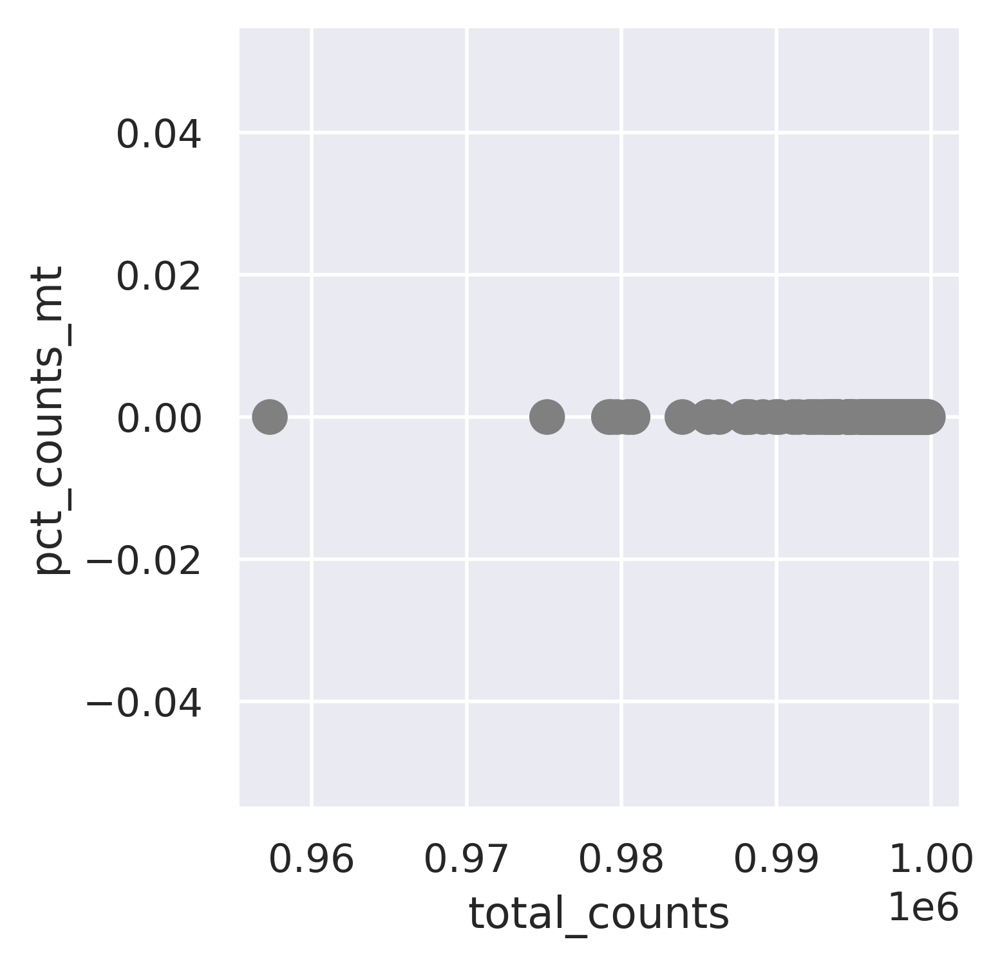

<Figure size 1600x1200 with 0 Axes>

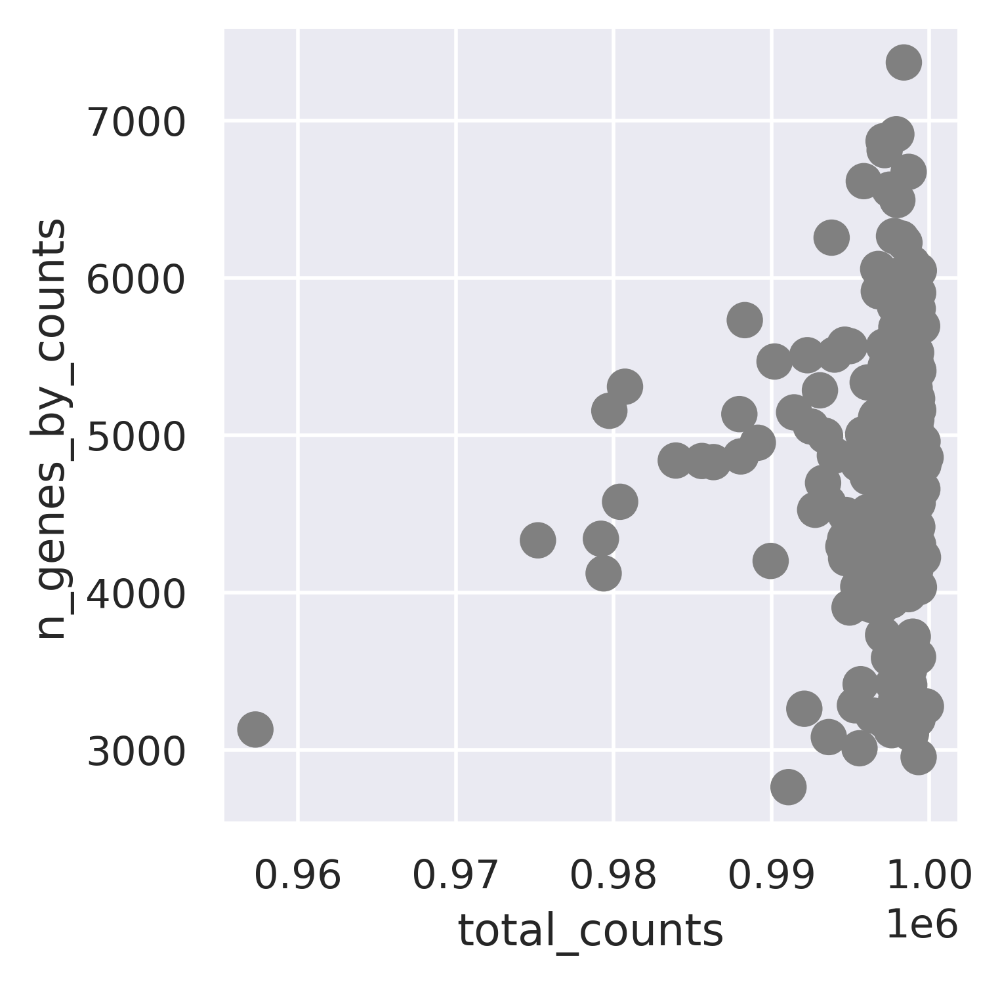

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (301, 12786)
5706
#----------------------------------------------
Deal with MGH128...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (184, 19135)


<Figure size 3000x600 with 0 Axes>

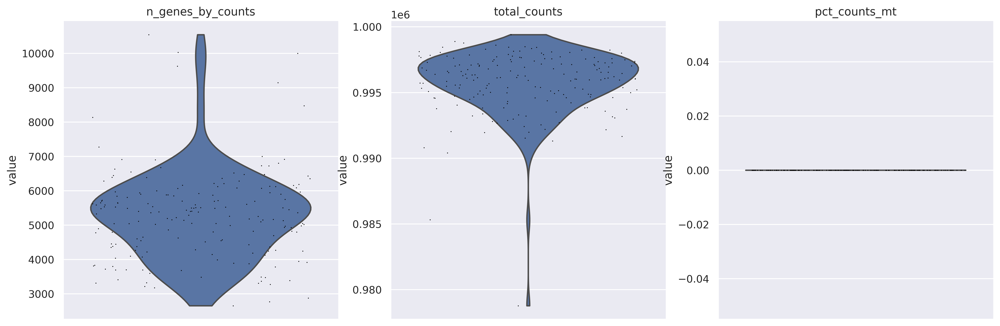

<Figure size 1600x1200 with 0 Axes>

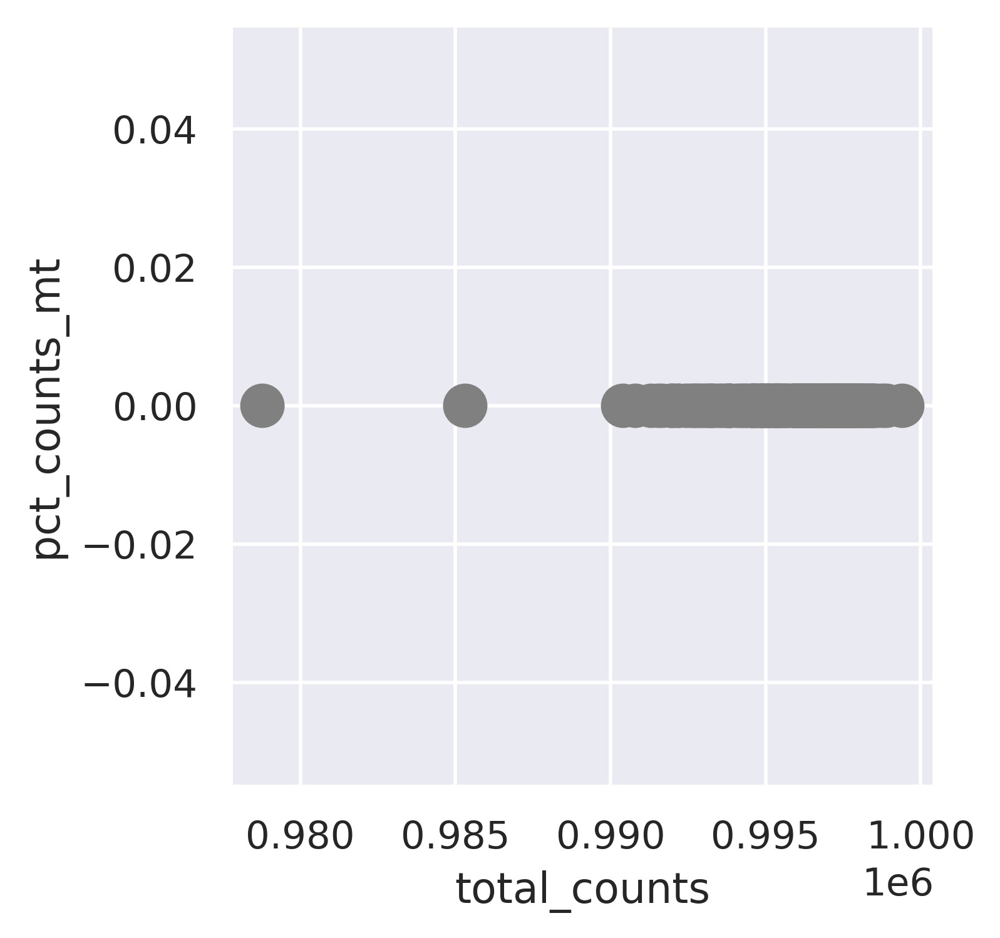

<Figure size 1600x1200 with 0 Axes>

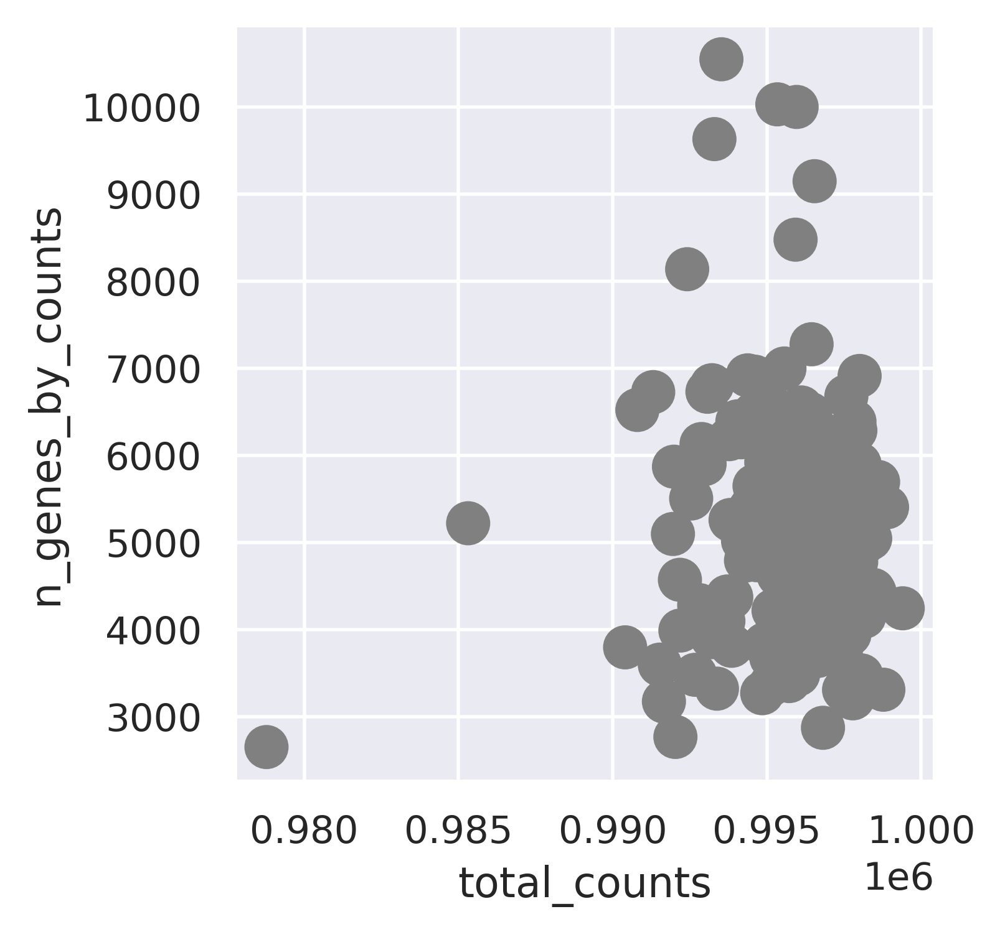

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (177, 13049)
5883
#----------------------------------------------
Deal with MGH129...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (192, 19135)


<Figure size 3000x600 with 0 Axes>

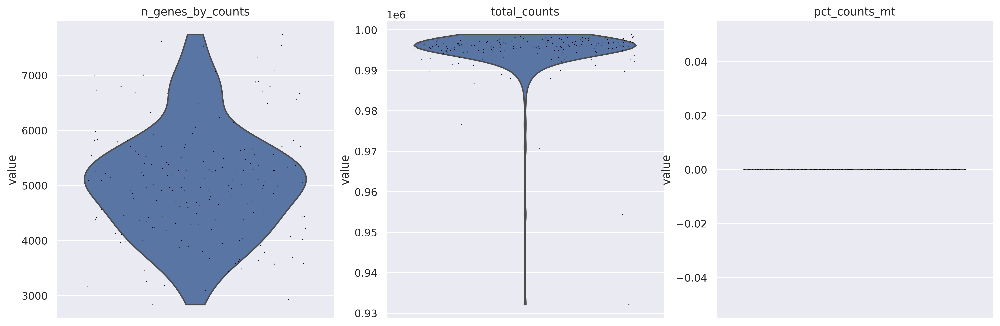

<Figure size 1600x1200 with 0 Axes>

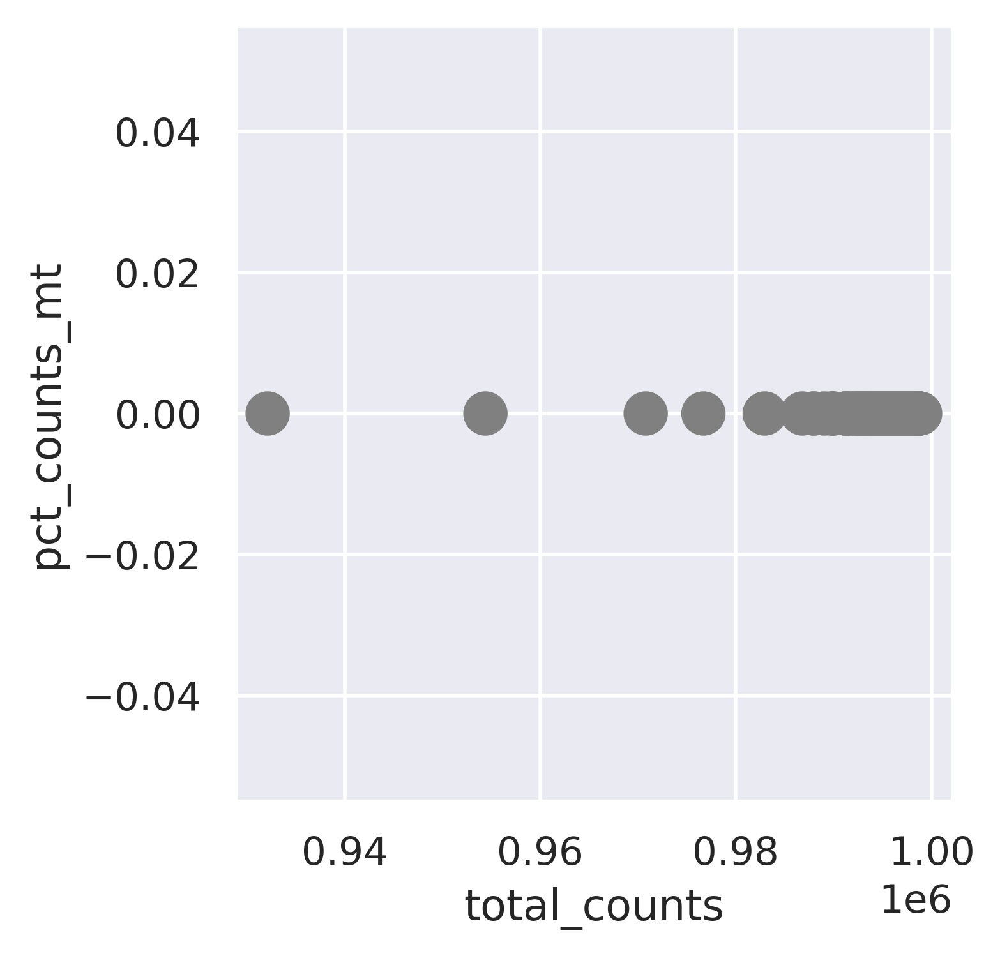

<Figure size 1600x1200 with 0 Axes>

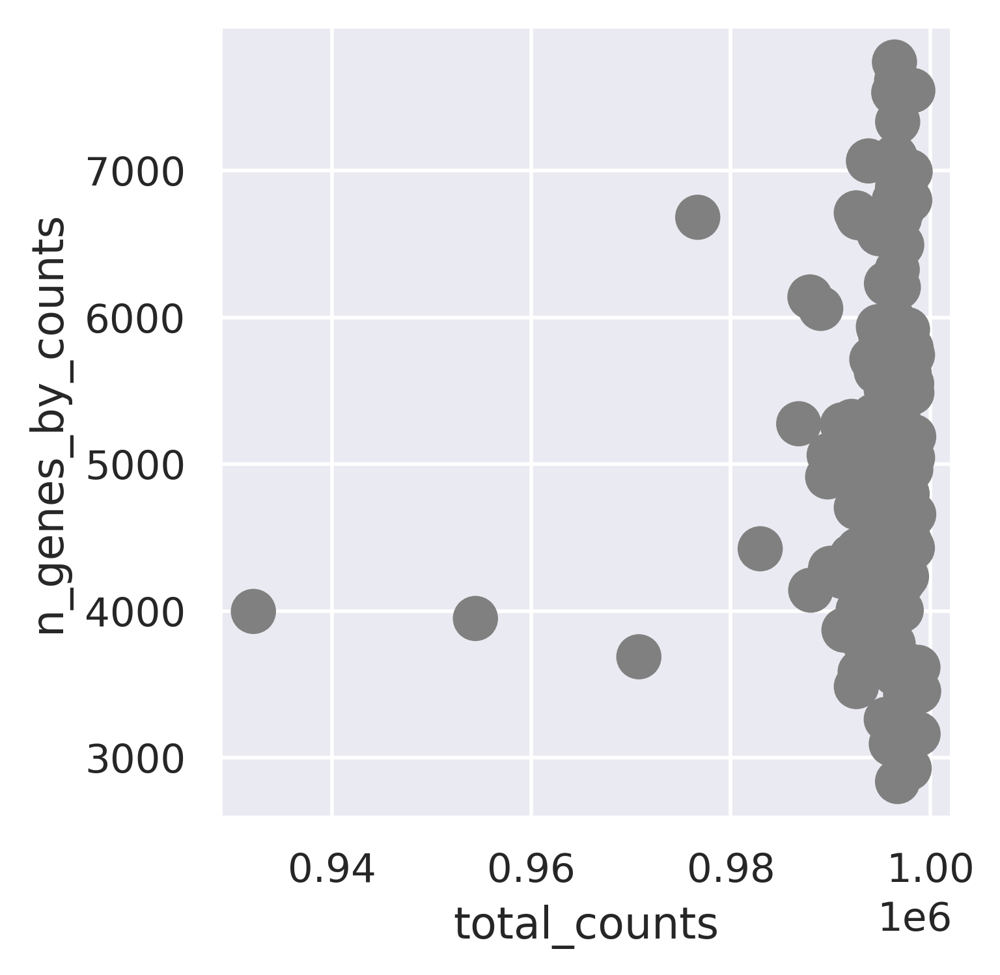

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (192, 12393)
6075
#----------------------------------------------
Deal with MGH136...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (231, 19135)


<Figure size 3000x600 with 0 Axes>

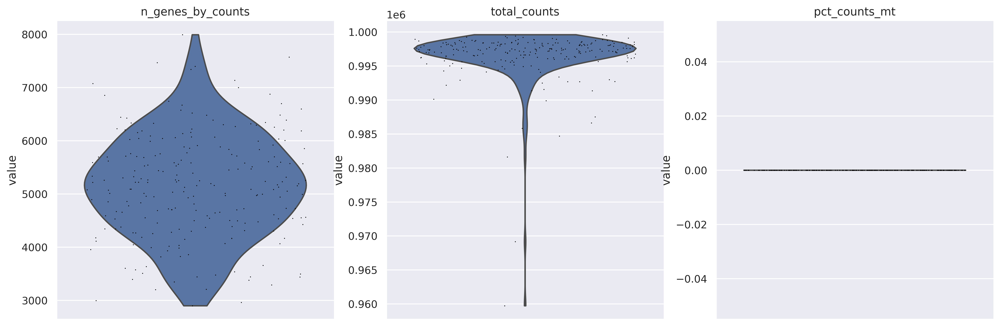

<Figure size 1600x1200 with 0 Axes>

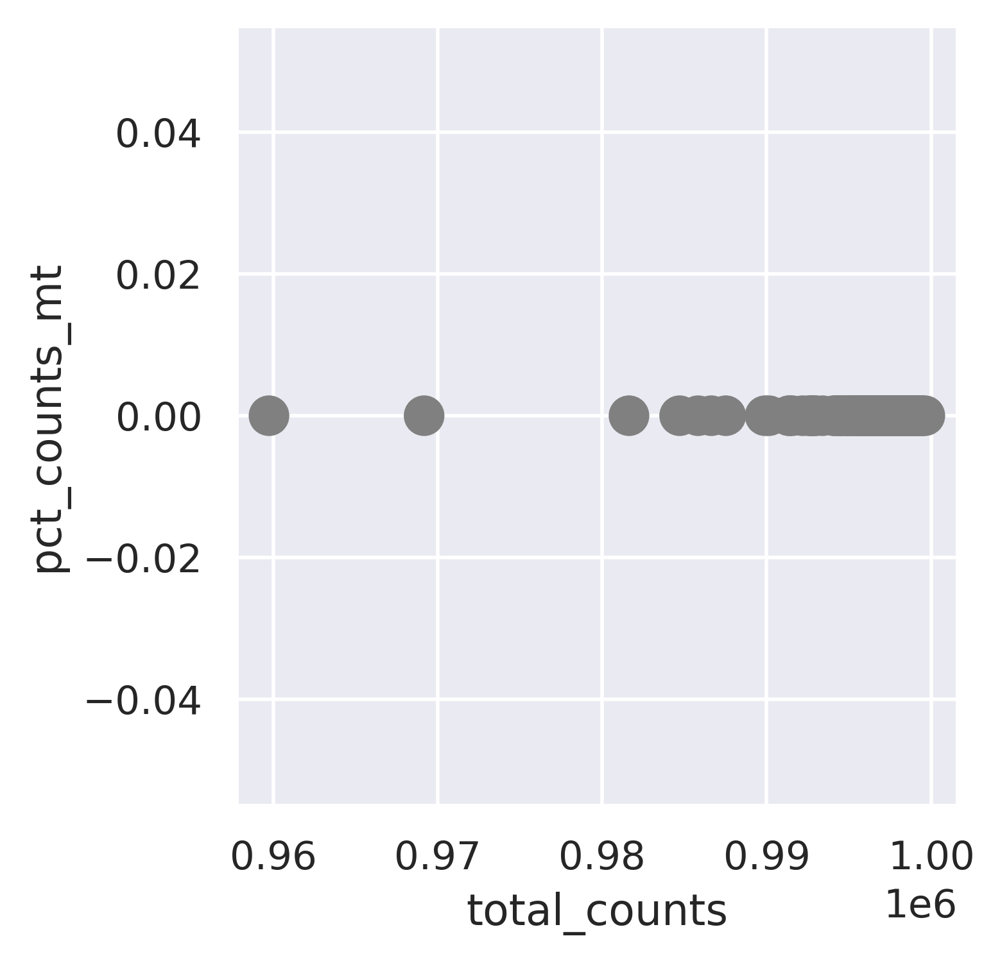

<Figure size 1600x1200 with 0 Axes>

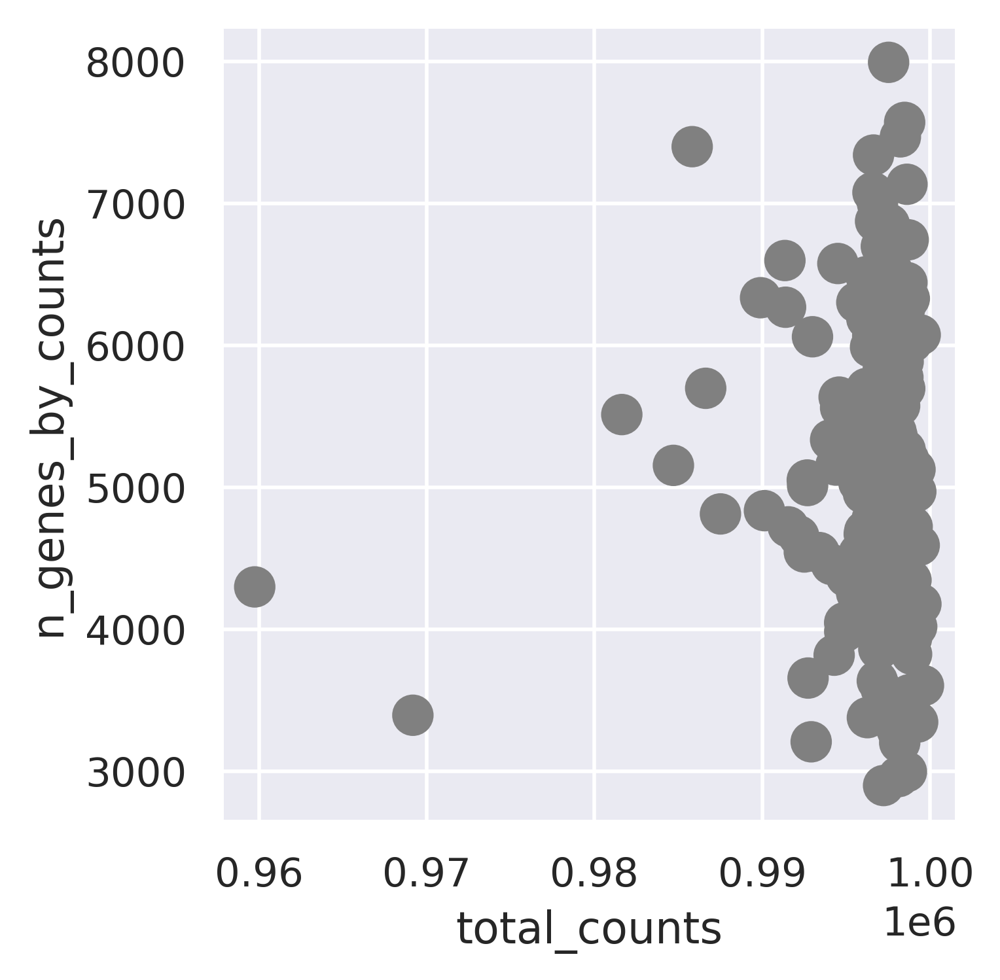

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (231, 12797)
6306
#----------------------------------------------
Deal with MGH143...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (274, 19135)


<Figure size 3000x600 with 0 Axes>

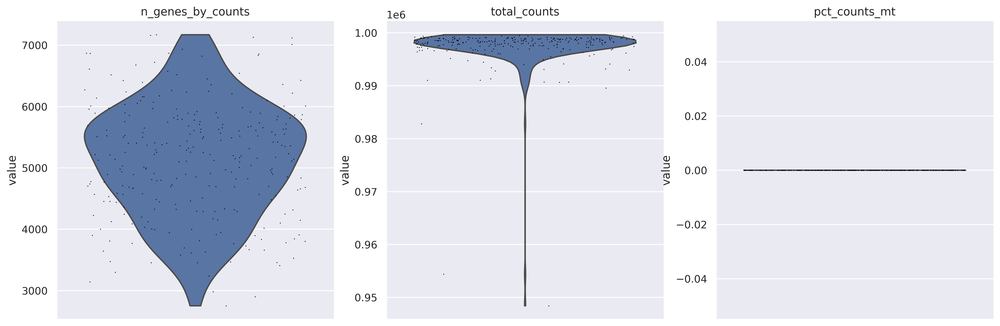

<Figure size 1600x1200 with 0 Axes>

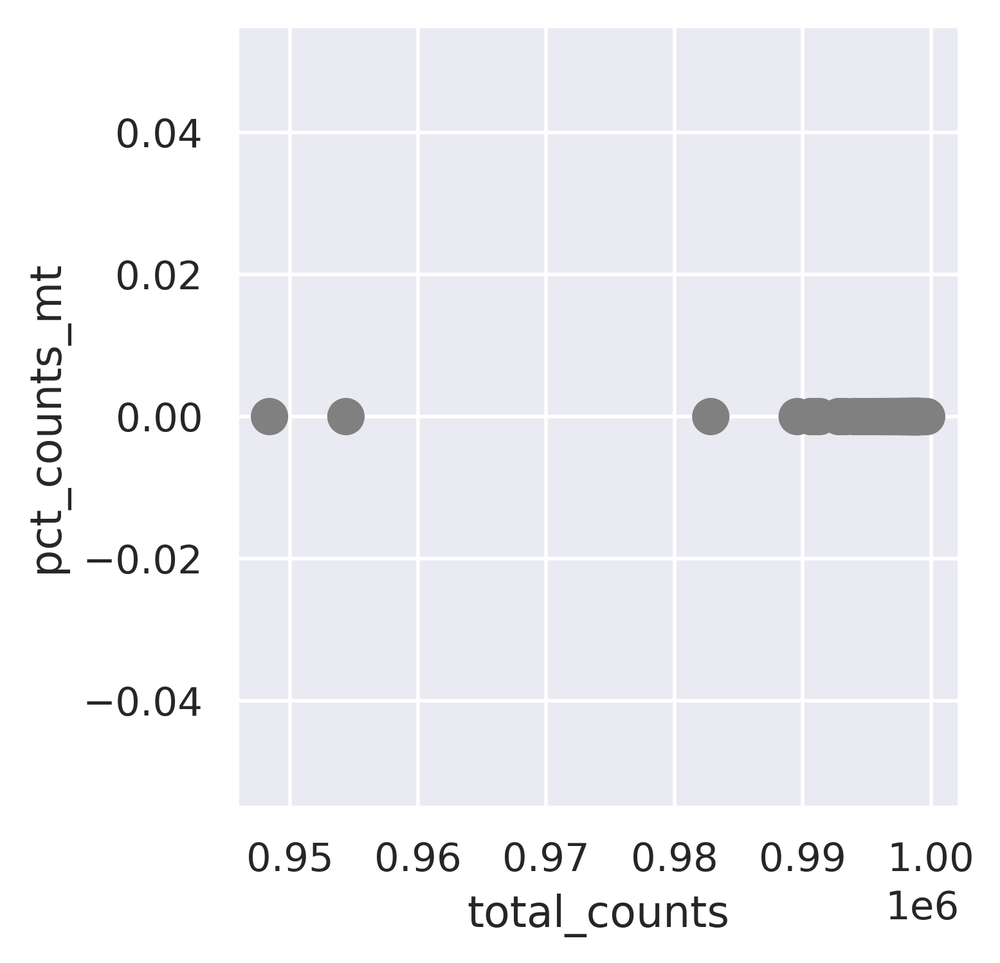

<Figure size 1600x1200 with 0 Axes>

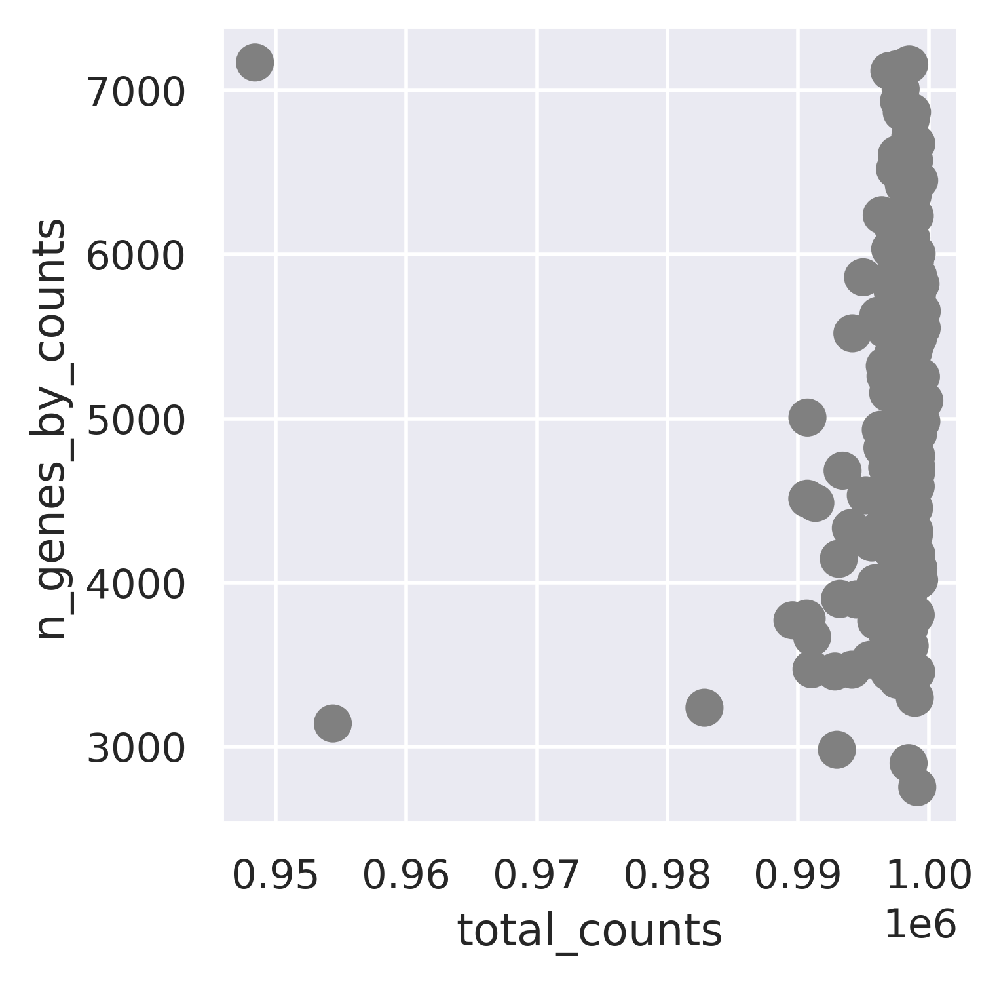

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (274, 12631)
6580
#----------------------------------------------
Deal with MGH151...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (163, 19135)


<Figure size 3000x600 with 0 Axes>

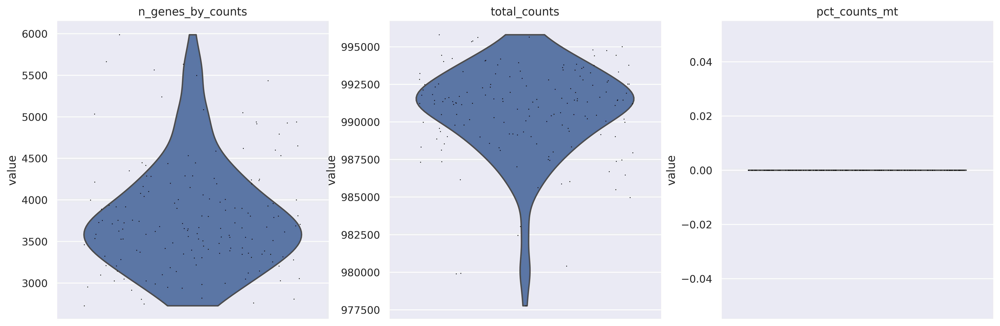

<Figure size 1600x1200 with 0 Axes>

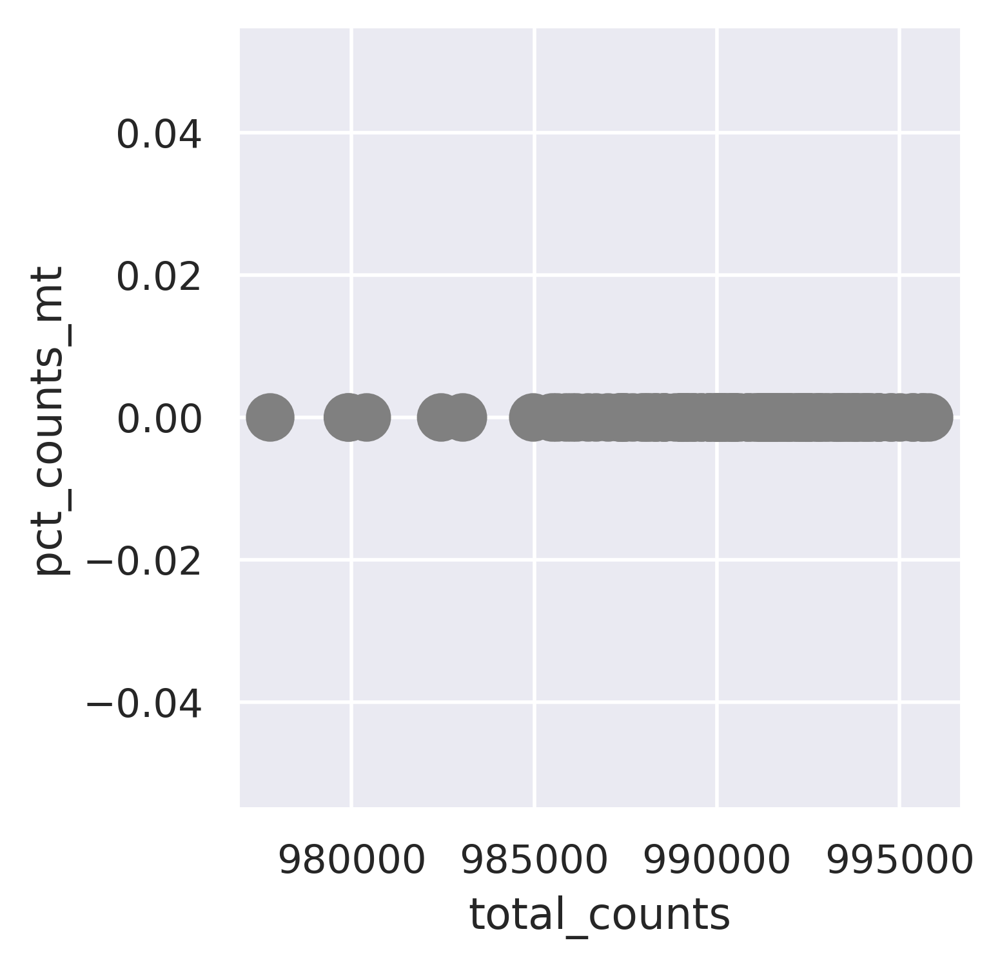

<Figure size 1600x1200 with 0 Axes>

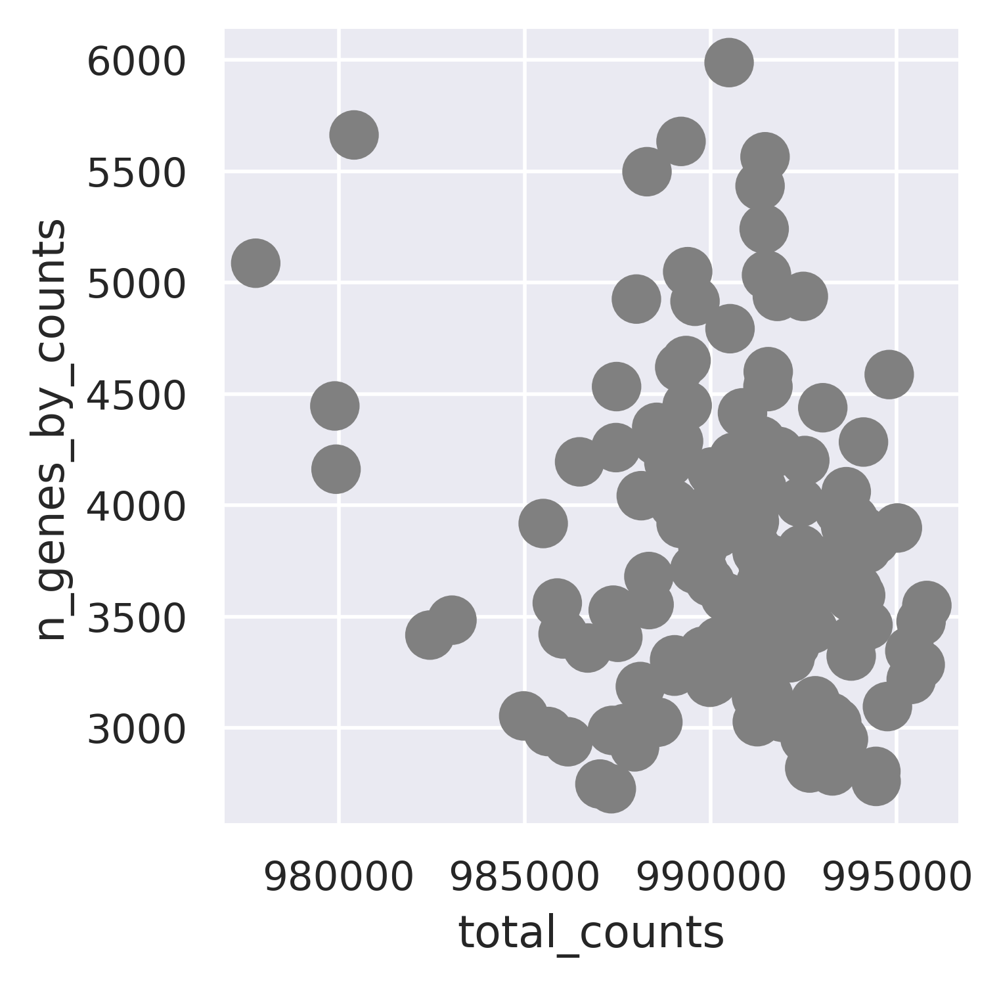

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (163, 11326)
6743
#----------------------------------------------
Deal with MGH152...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (229, 19135)


<Figure size 3000x600 with 0 Axes>

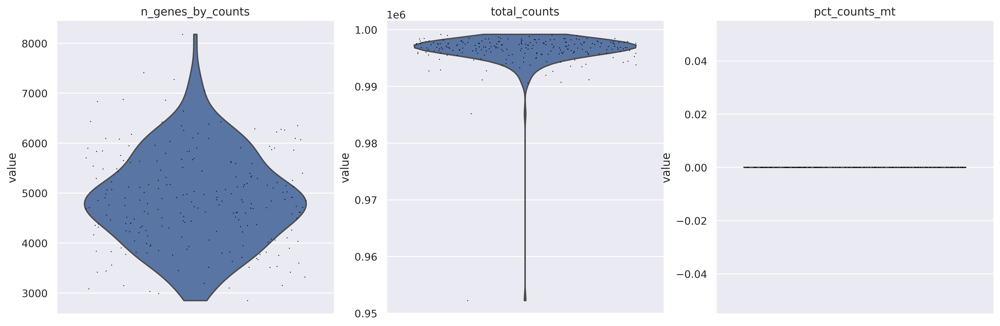

<Figure size 1600x1200 with 0 Axes>

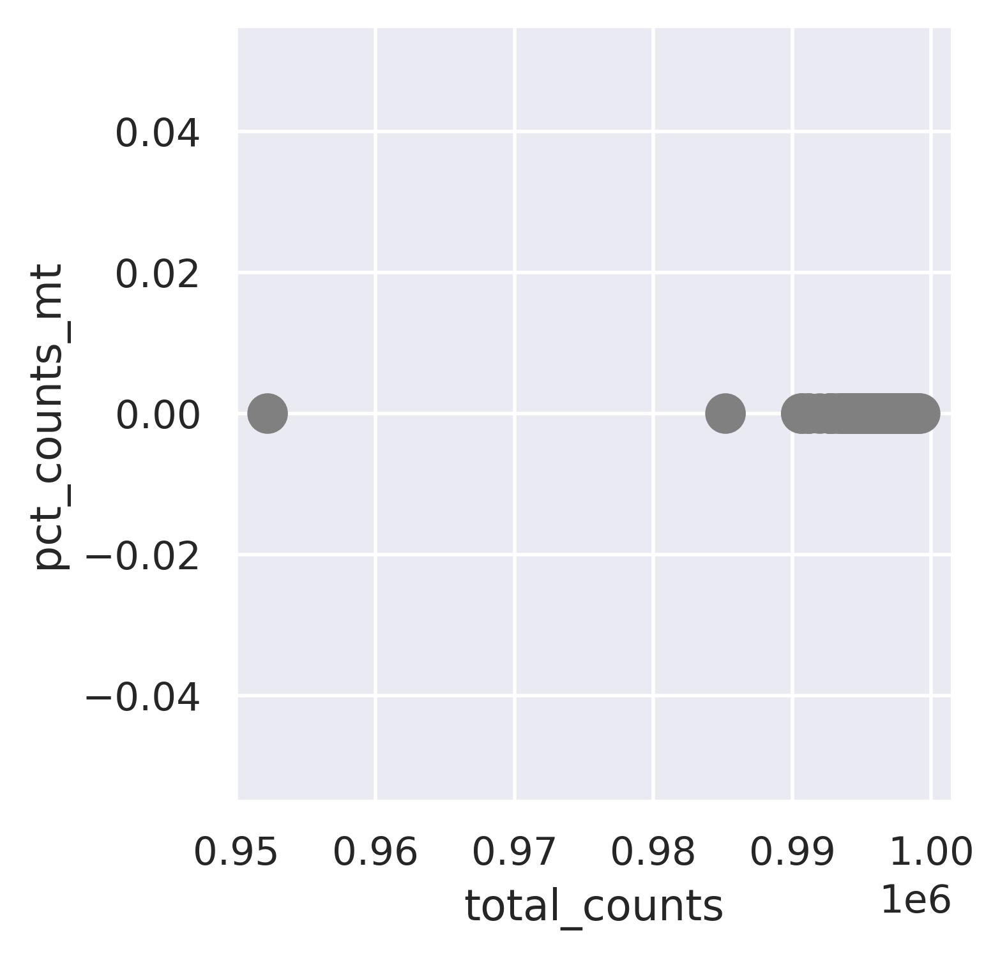

<Figure size 1600x1200 with 0 Axes>

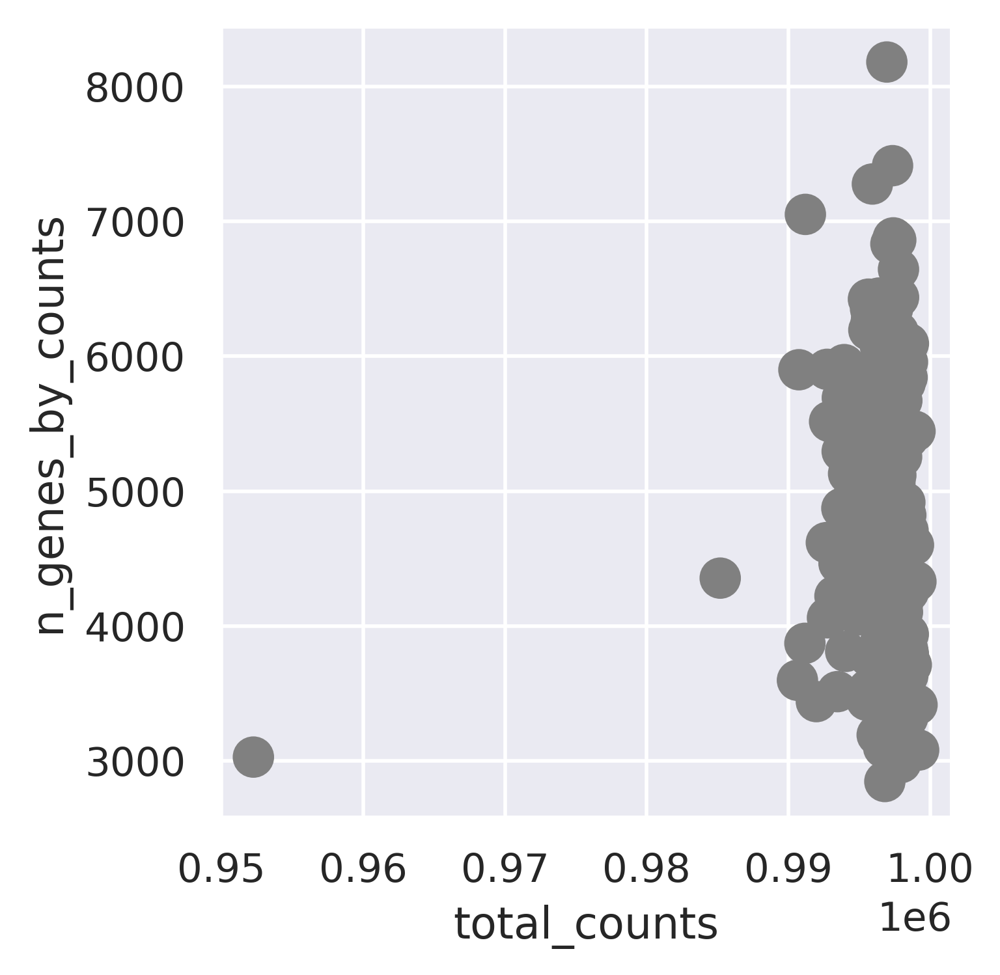

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (228, 12895)
6971
#----------------------------------------------
Deal with MGH66...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (436, 19135)


<Figure size 3000x600 with 0 Axes>

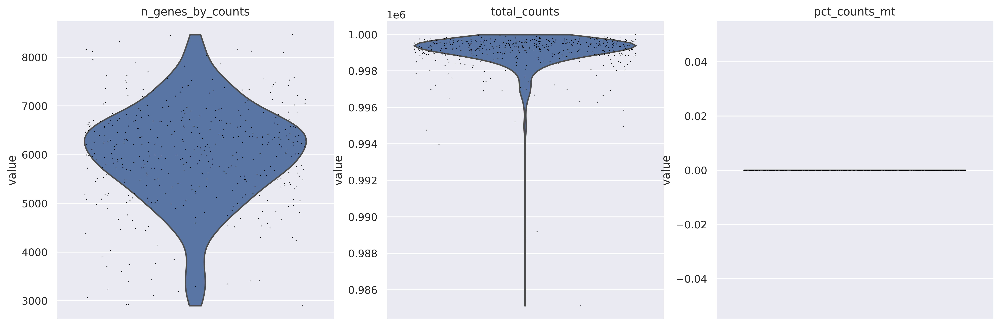

<Figure size 1600x1200 with 0 Axes>

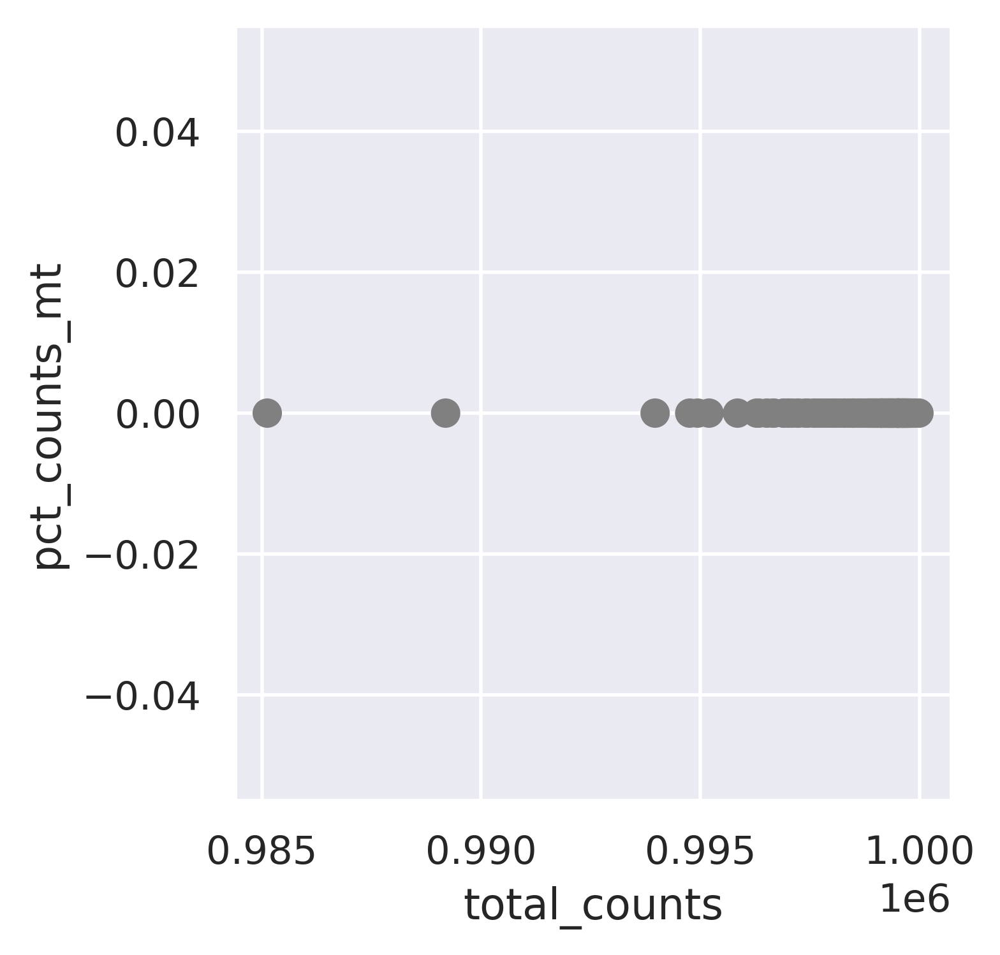

<Figure size 1600x1200 with 0 Axes>

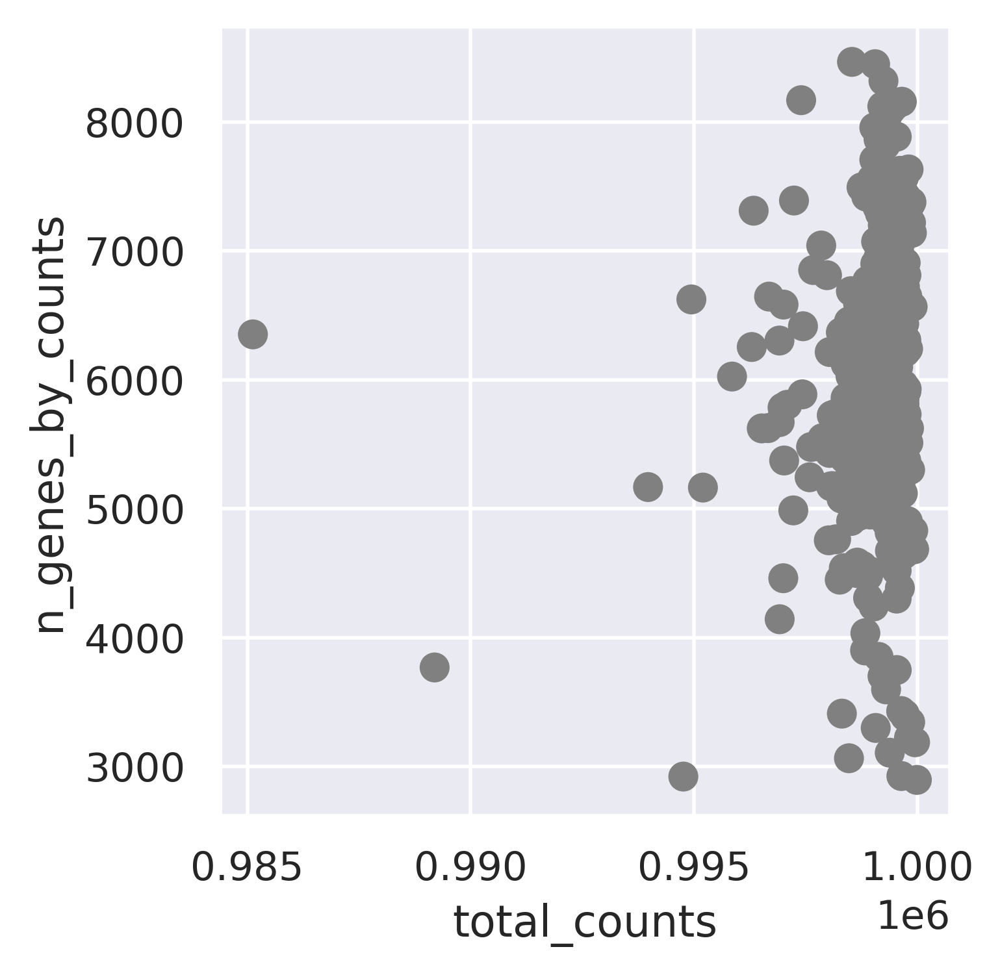

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (427, 14032)
7398
#----------------------------------------------
Deal with 102...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1822, 19135)


<Figure size 3000x600 with 0 Axes>

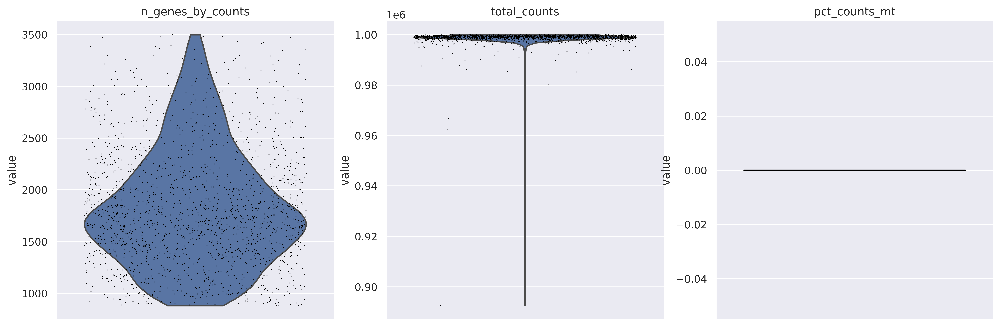

<Figure size 1600x1200 with 0 Axes>

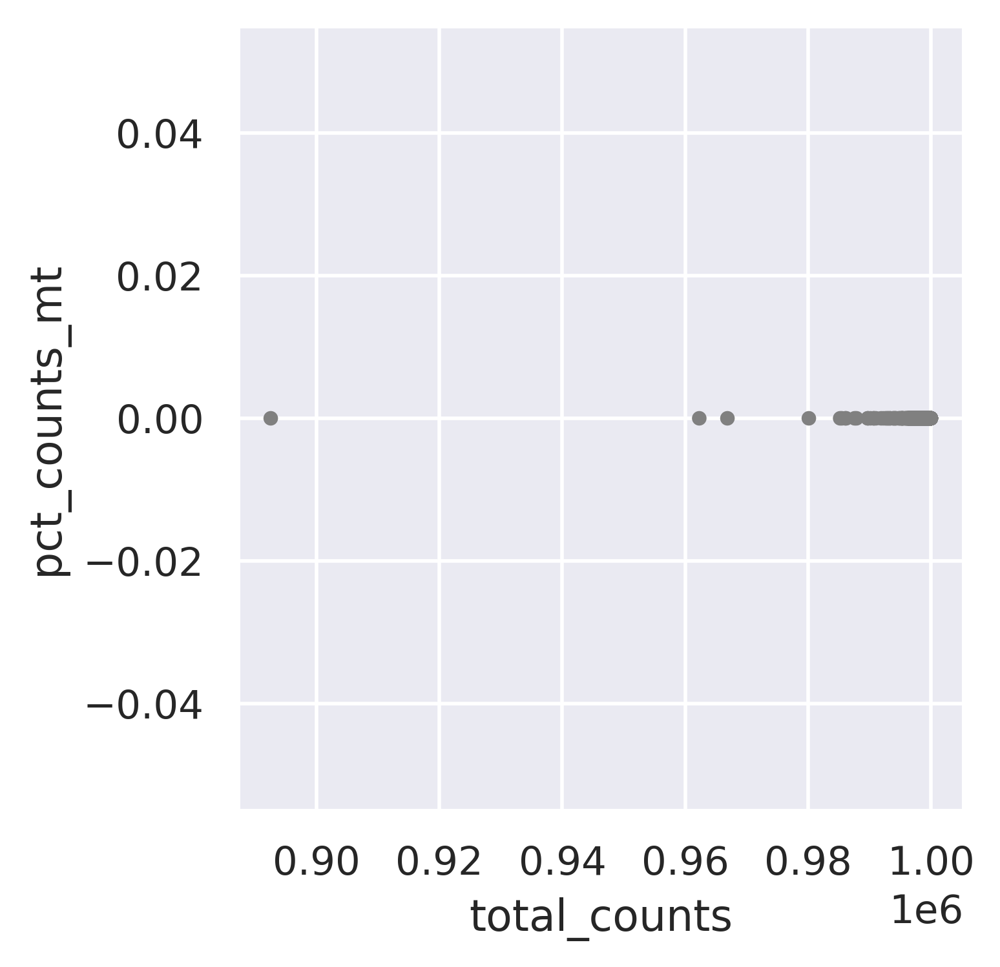

<Figure size 1600x1200 with 0 Axes>

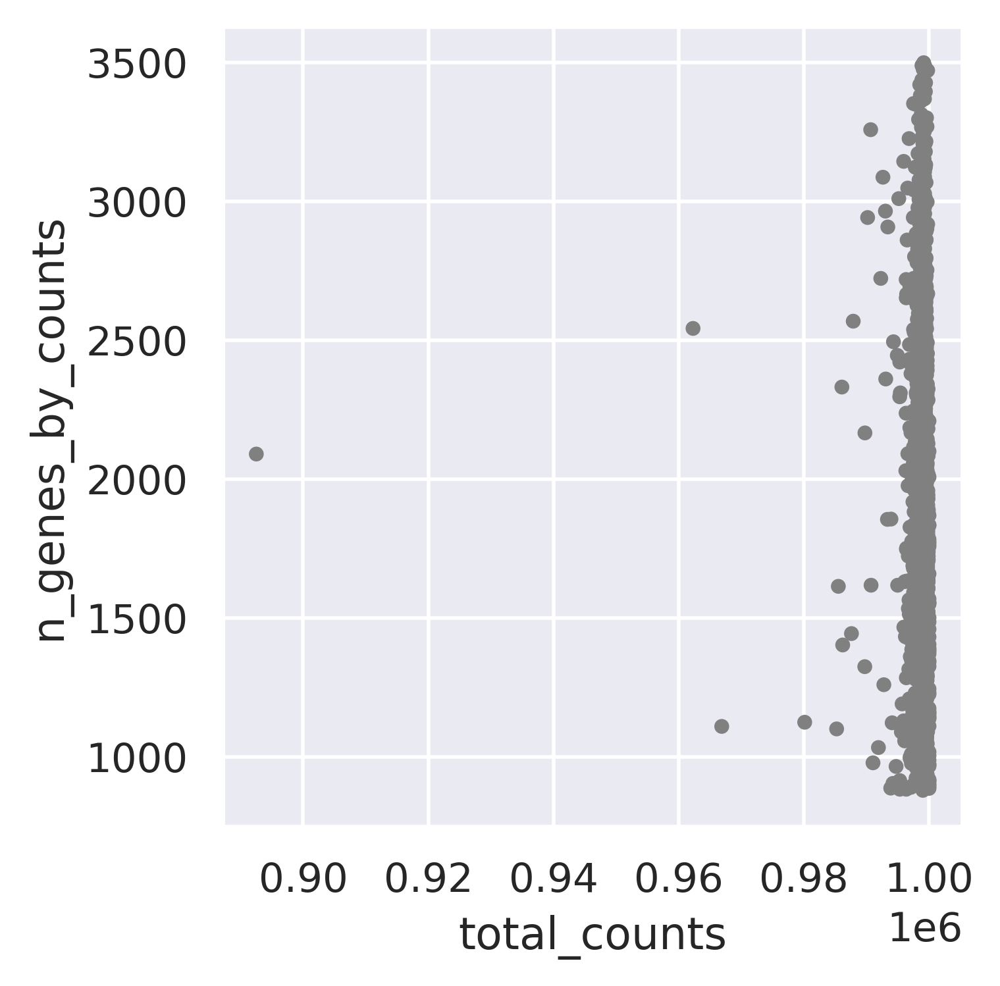

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1822, 12915)
9220
#----------------------------------------------
Deal with 143...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (2314, 19135)


<Figure size 3000x600 with 0 Axes>

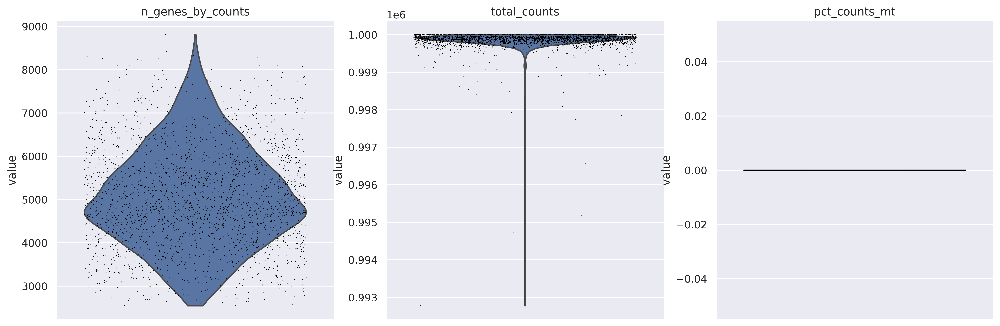

<Figure size 1600x1200 with 0 Axes>

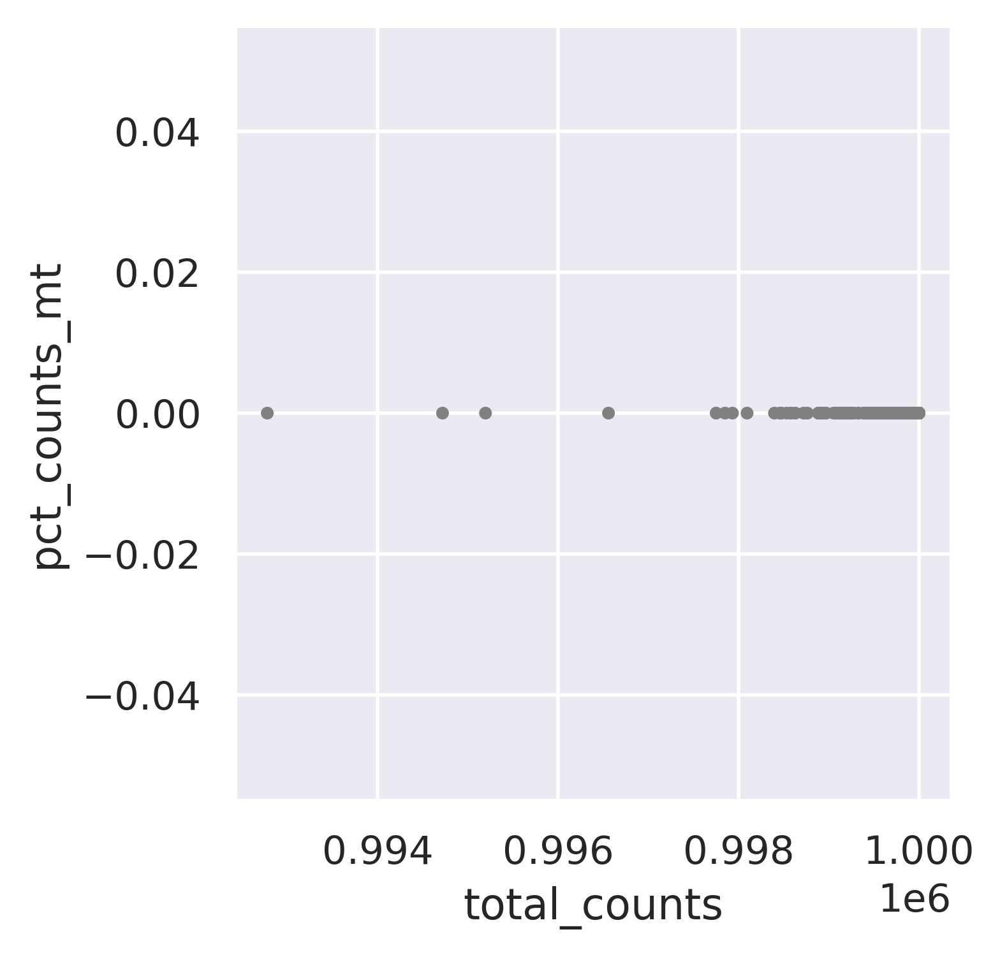

<Figure size 1600x1200 with 0 Axes>

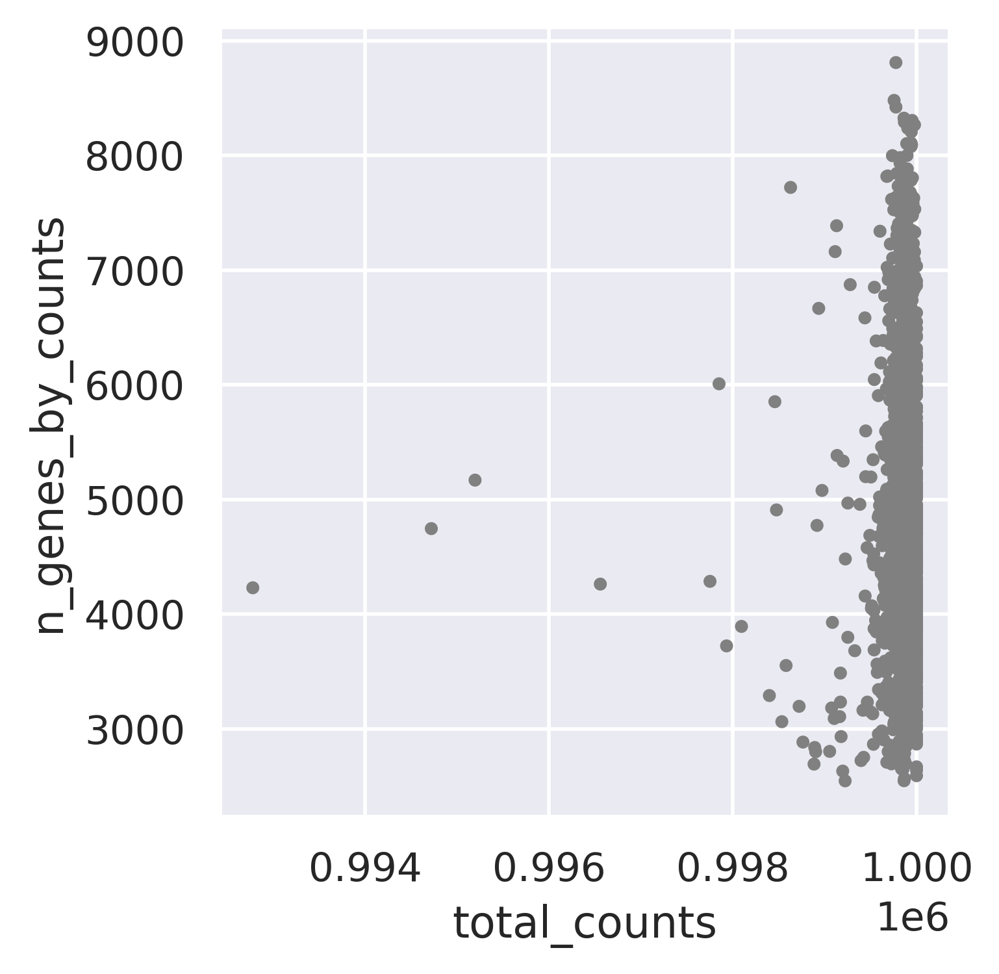

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (2298, 13937)
11518
#----------------------------------------------
Deal with 105...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (4127, 19135)


<Figure size 3000x600 with 0 Axes>

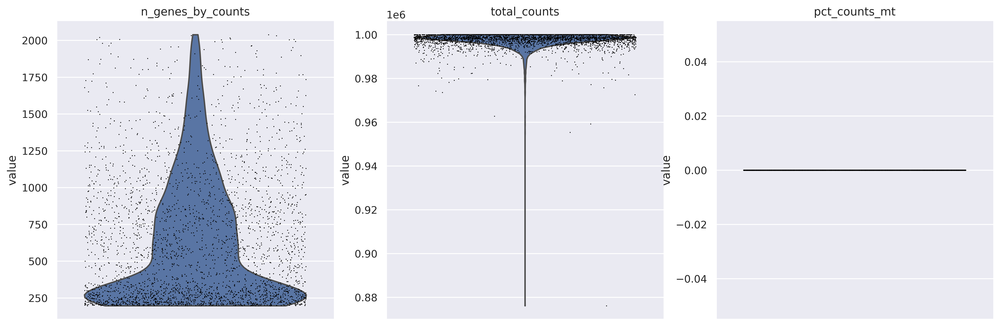

<Figure size 1600x1200 with 0 Axes>

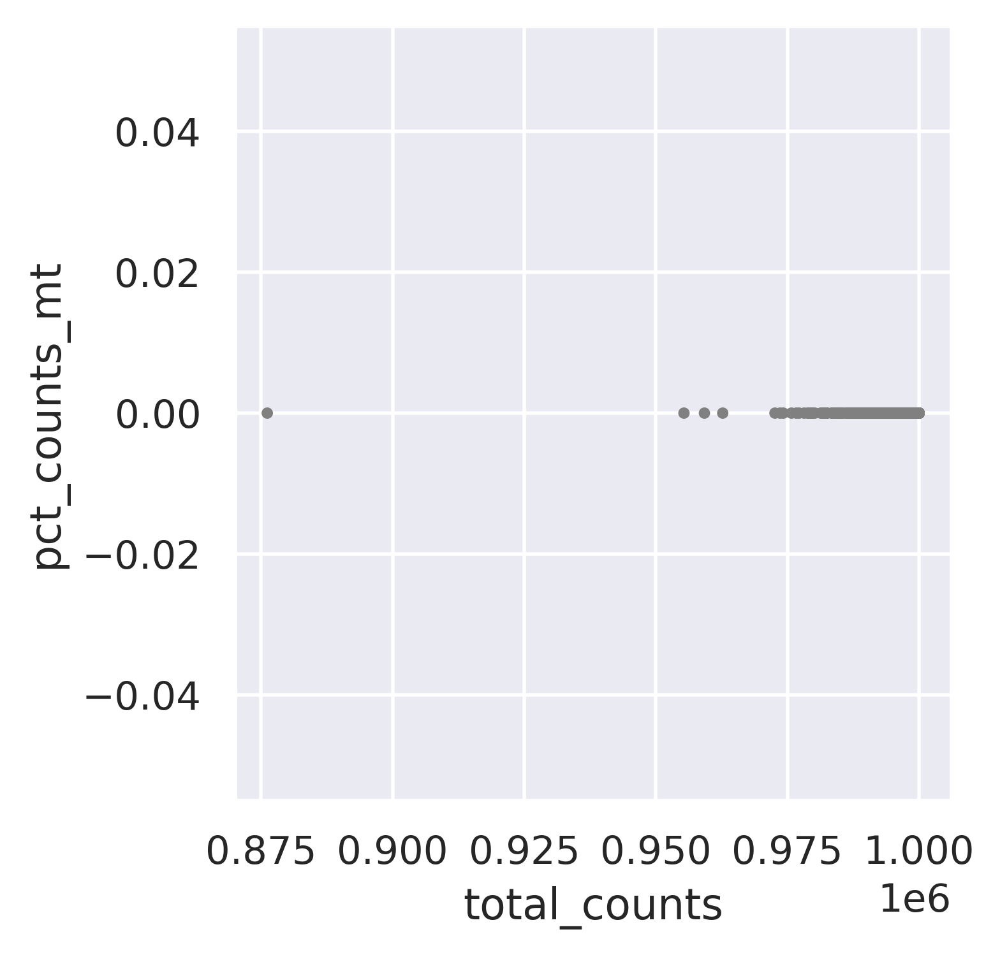

<Figure size 1600x1200 with 0 Axes>

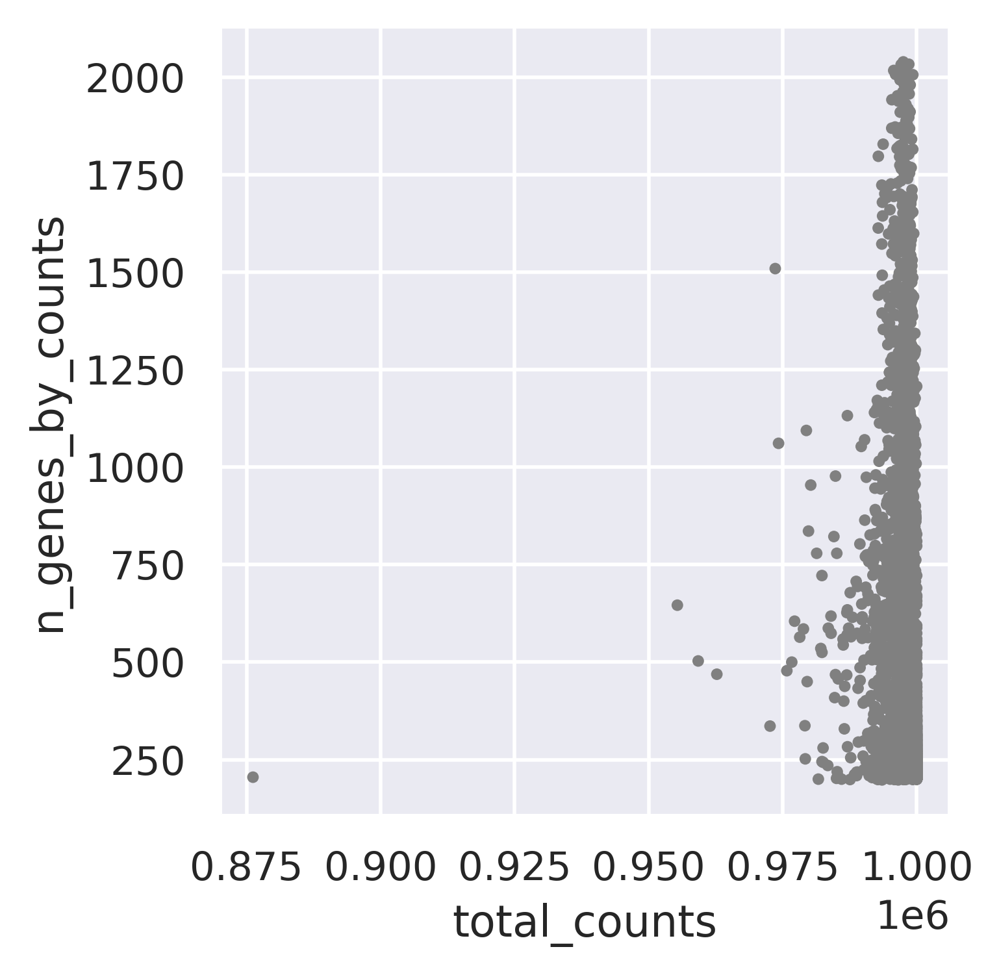

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (2902, 11476)
14420
#----------------------------------------------
Deal with 105A...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1386, 19135)


<Figure size 3000x600 with 0 Axes>

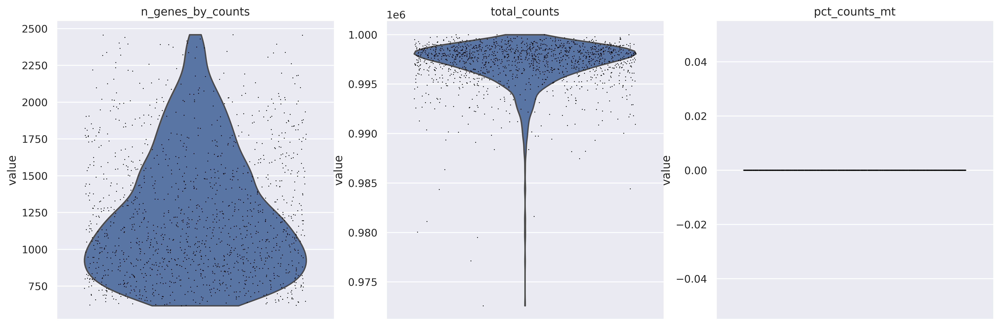

<Figure size 1600x1200 with 0 Axes>

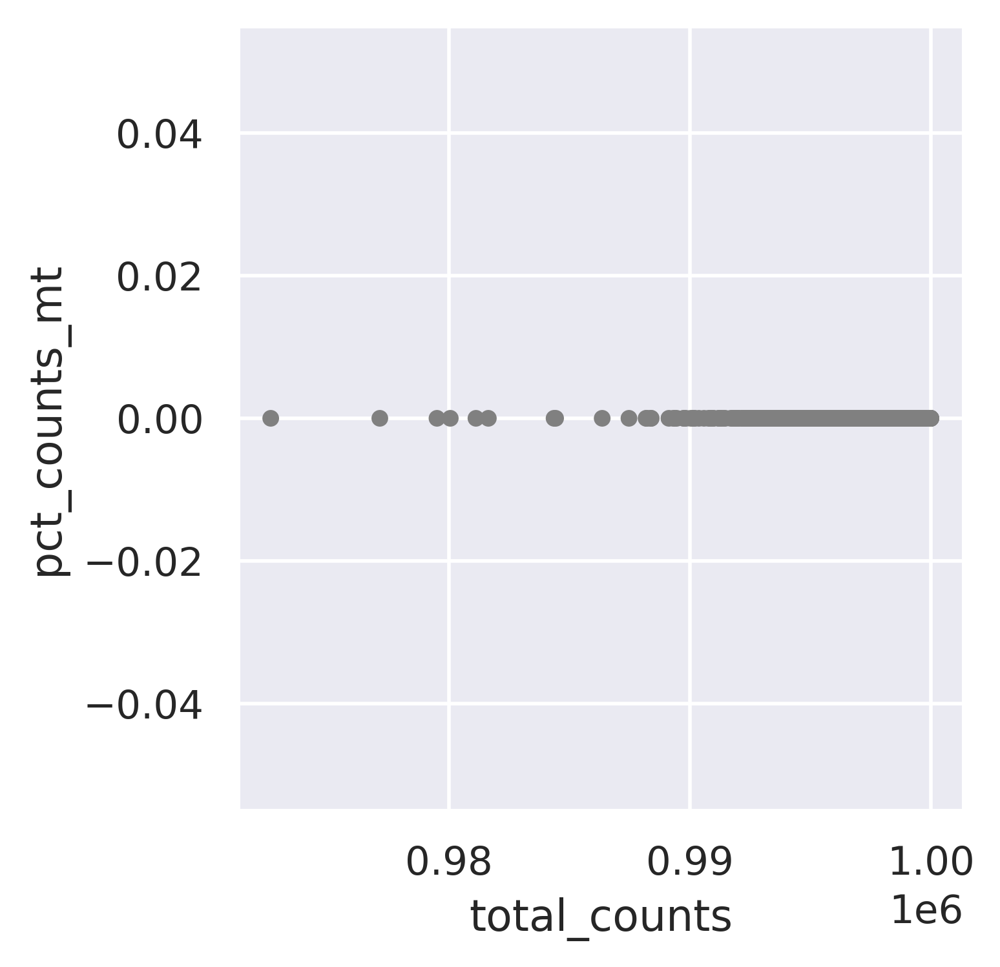

<Figure size 1600x1200 with 0 Axes>

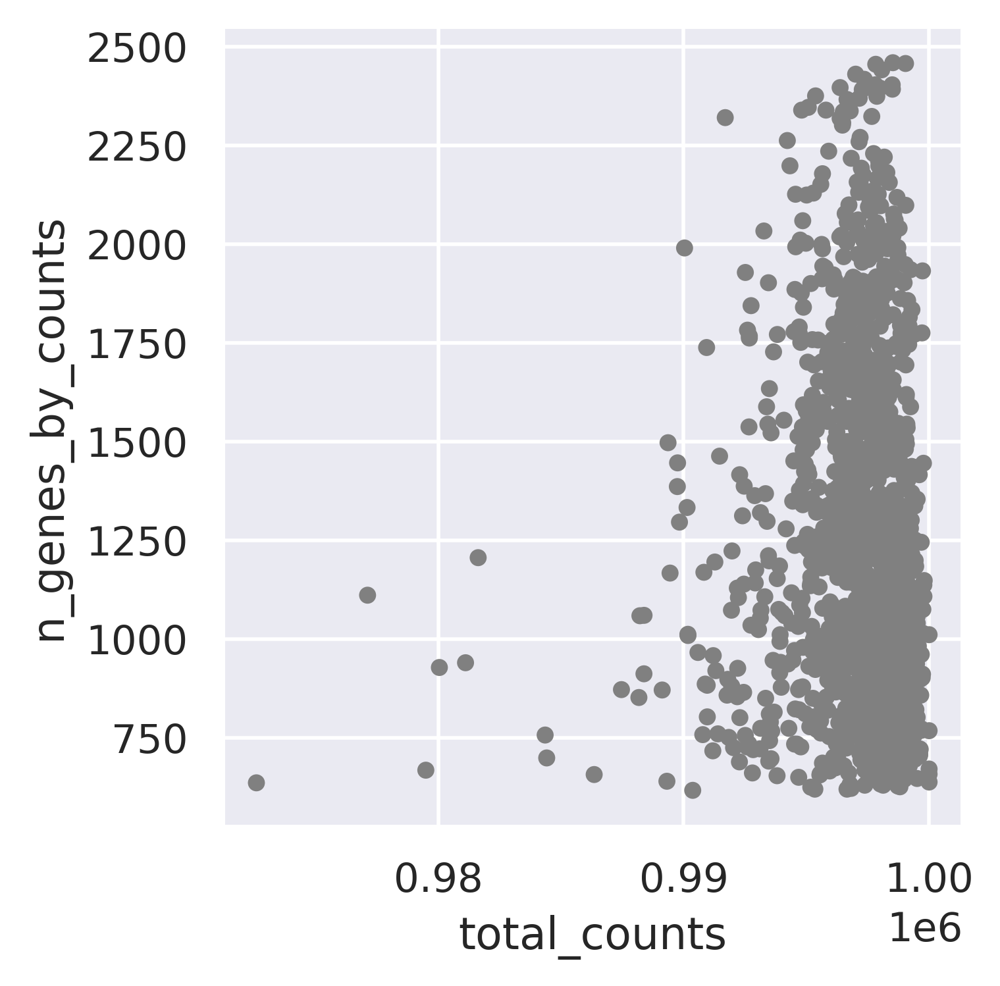

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1386, 11108)
15806
#----------------------------------------------
Deal with 114...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (473, 19135)


<Figure size 3000x600 with 0 Axes>

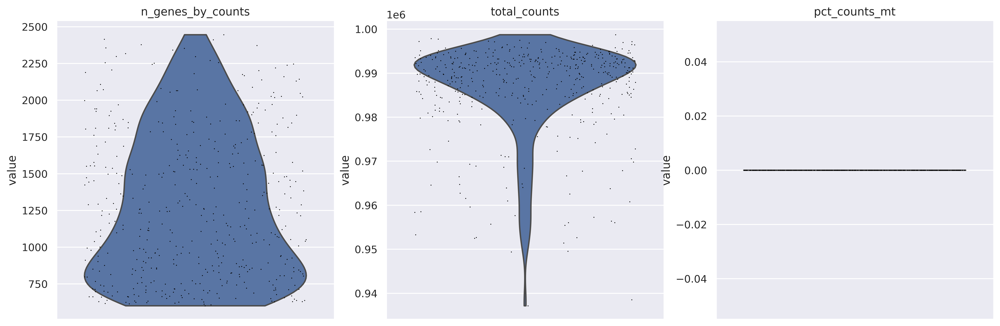

<Figure size 1600x1200 with 0 Axes>

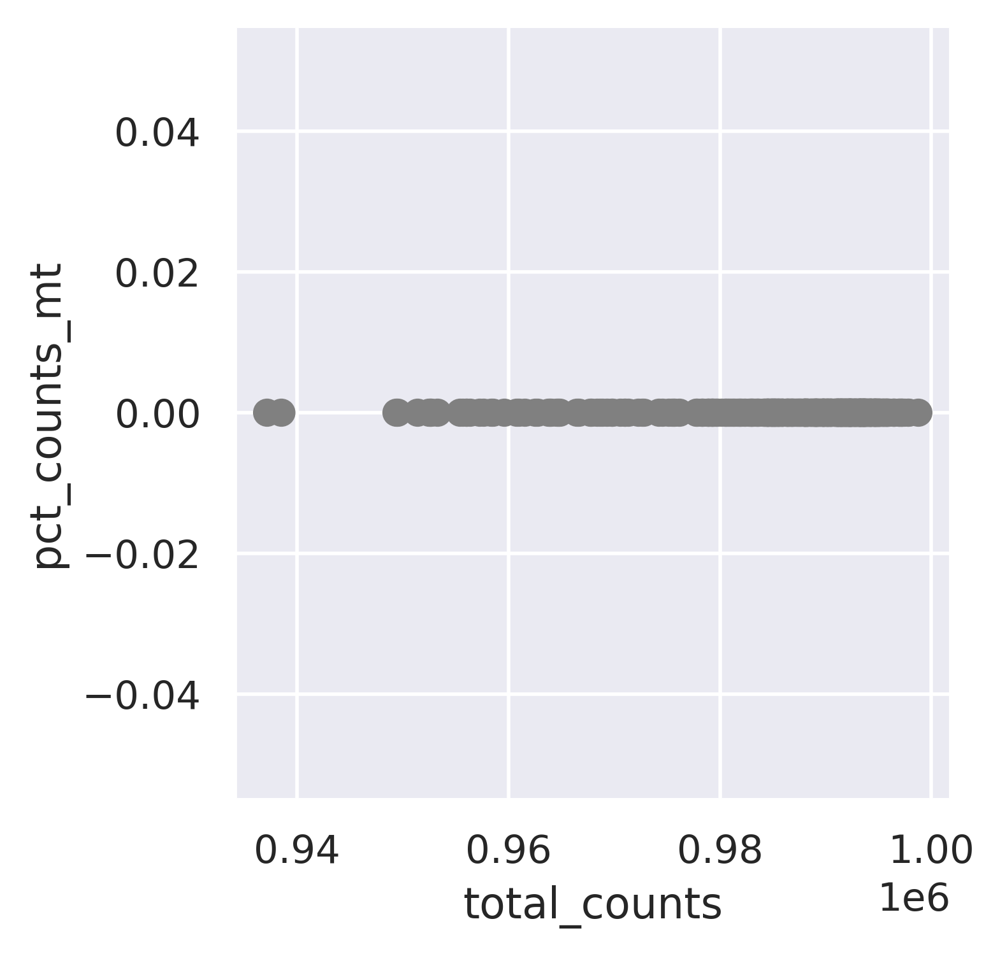

<Figure size 1600x1200 with 0 Axes>

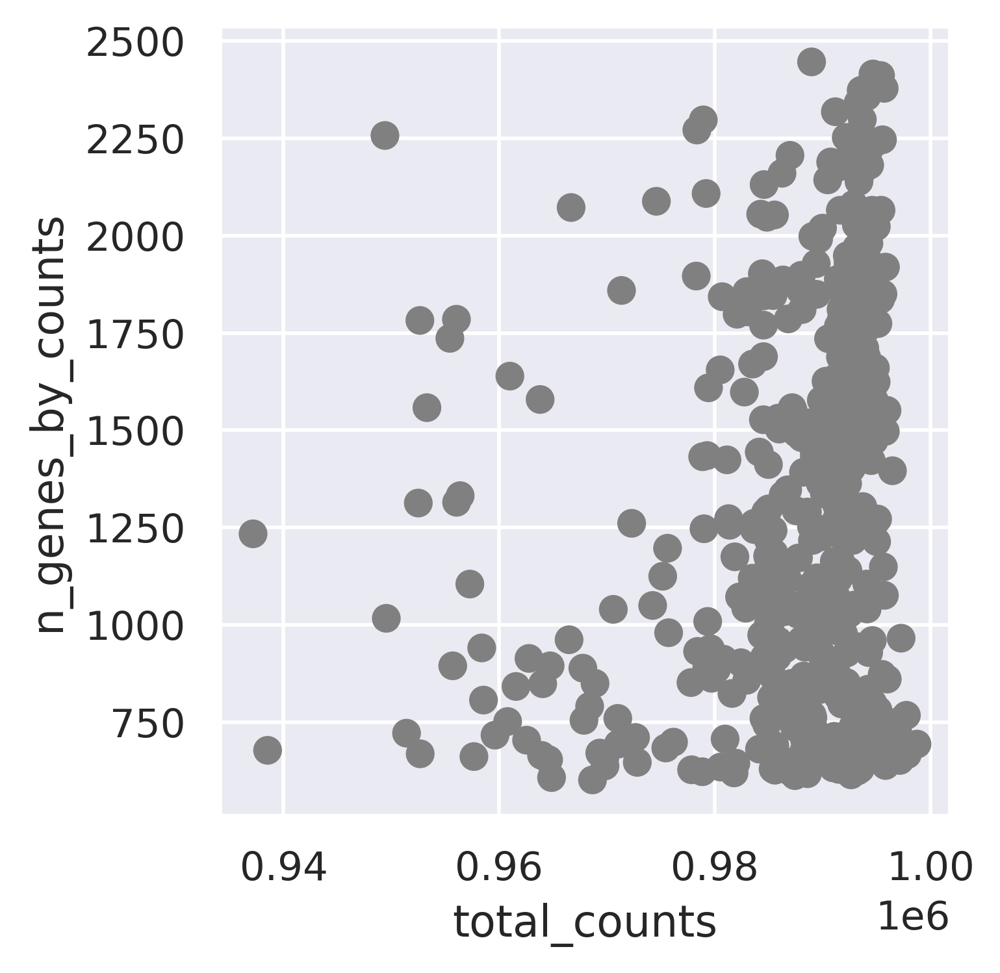

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (473, 9335)
16279
#----------------------------------------------
Deal with 115...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1283, 19135)


<Figure size 3000x600 with 0 Axes>

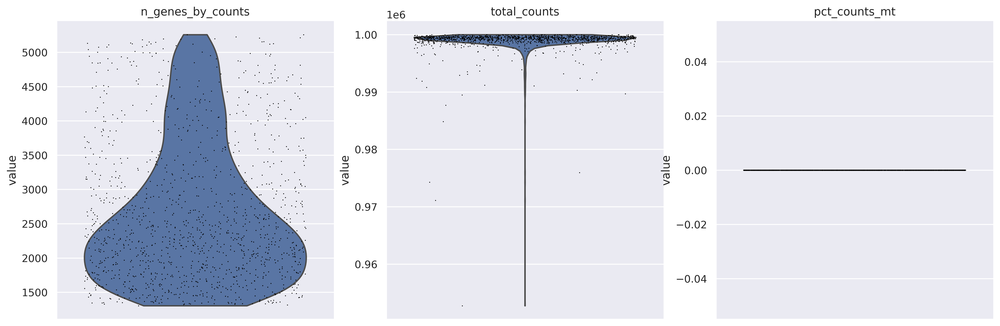

<Figure size 1600x1200 with 0 Axes>

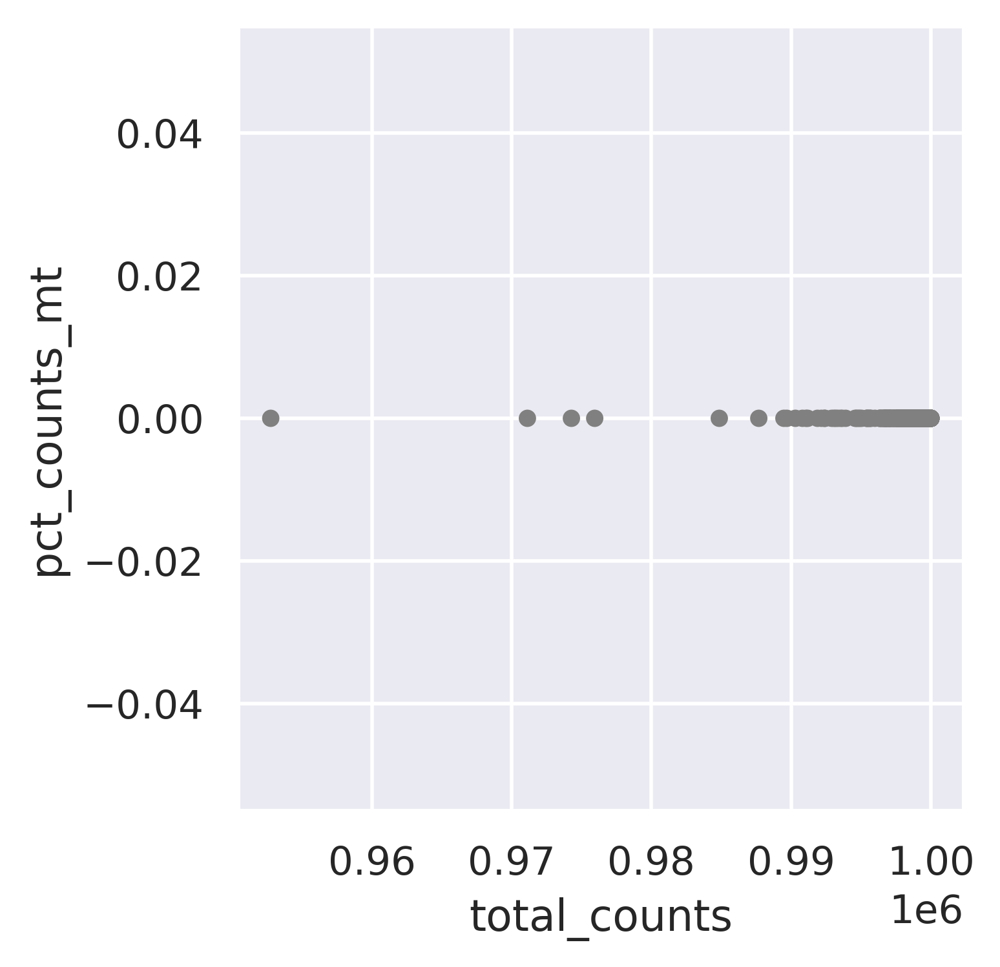

<Figure size 1600x1200 with 0 Axes>

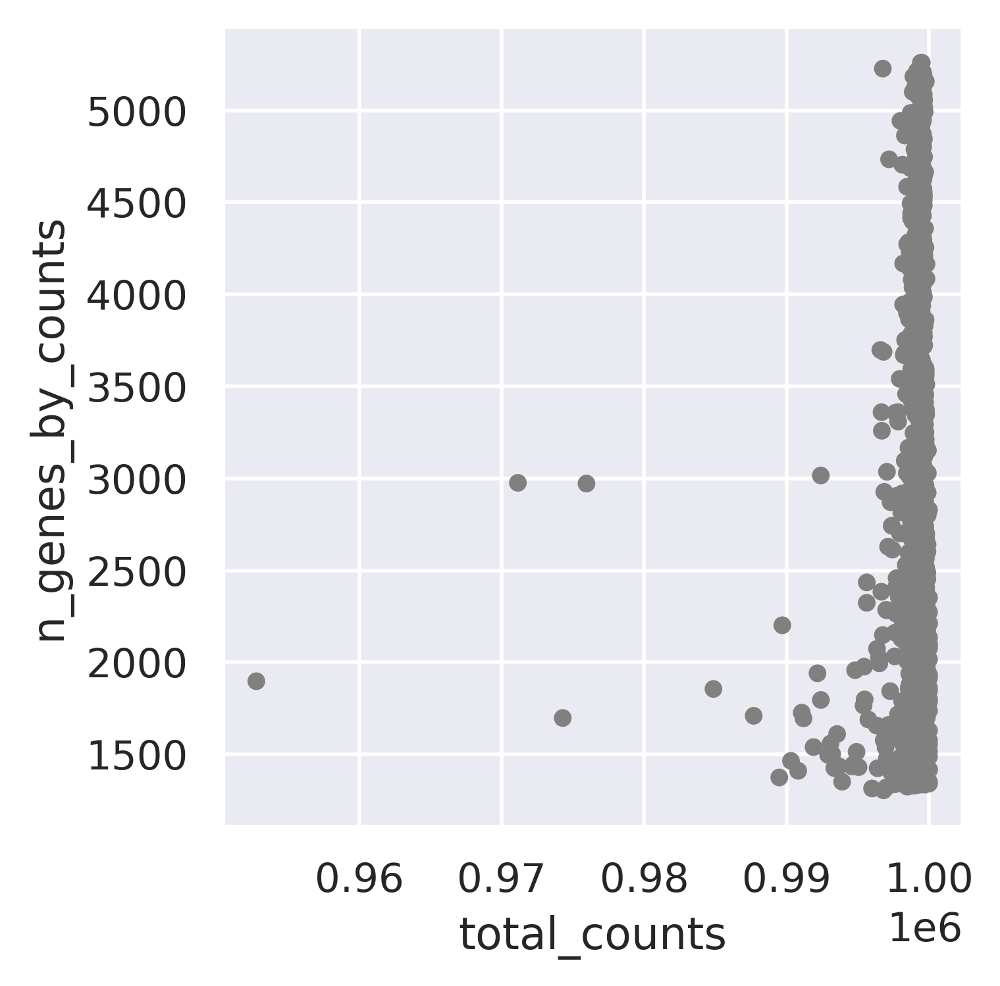

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1283, 12860)
17562
#----------------------------------------------
Deal with 118...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (539, 19135)


<Figure size 3000x600 with 0 Axes>

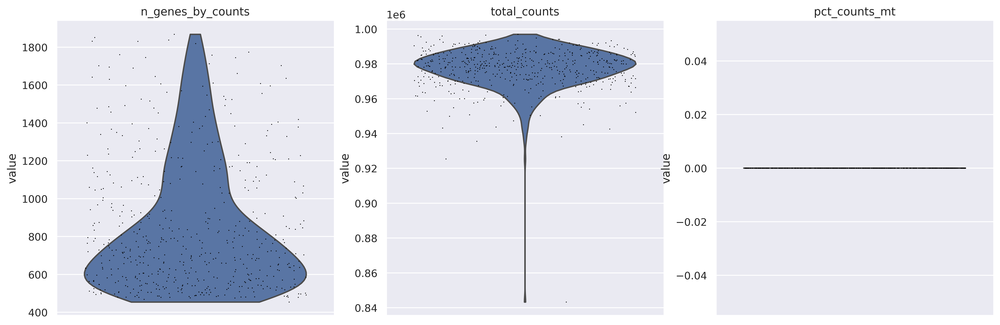

<Figure size 1600x1200 with 0 Axes>

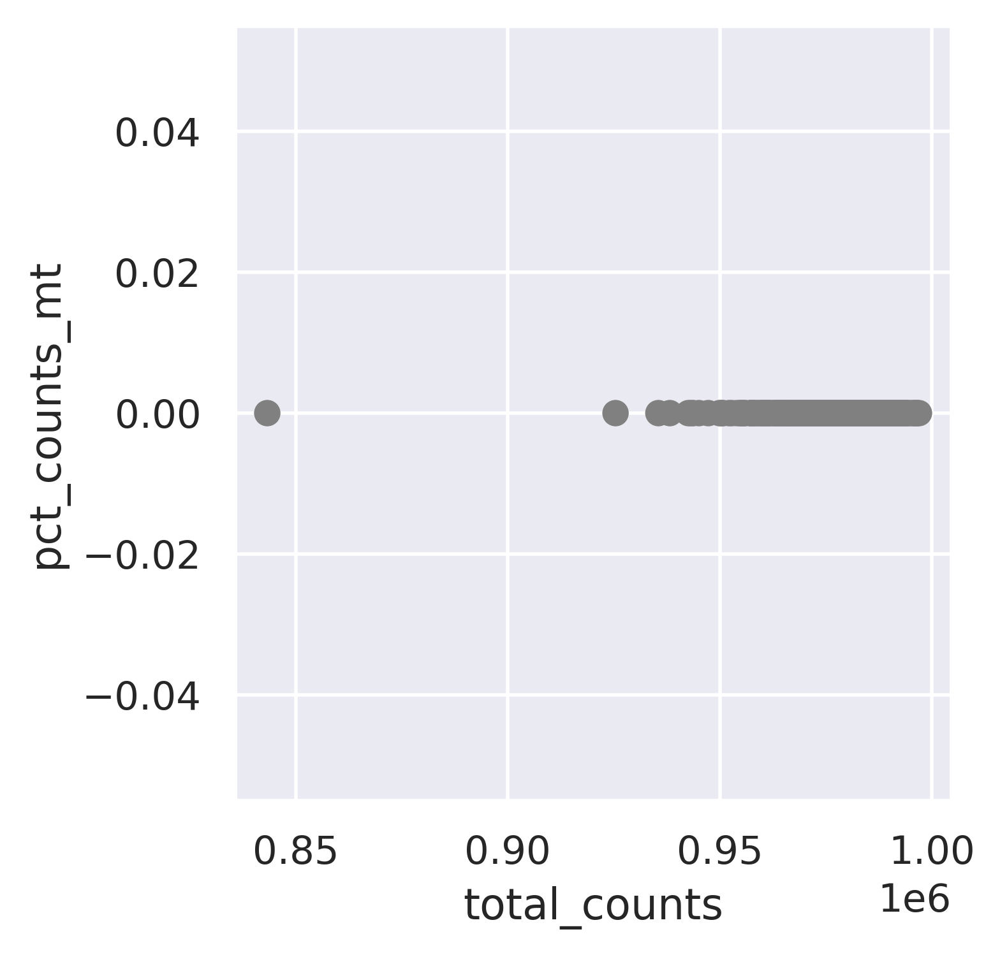

<Figure size 1600x1200 with 0 Axes>

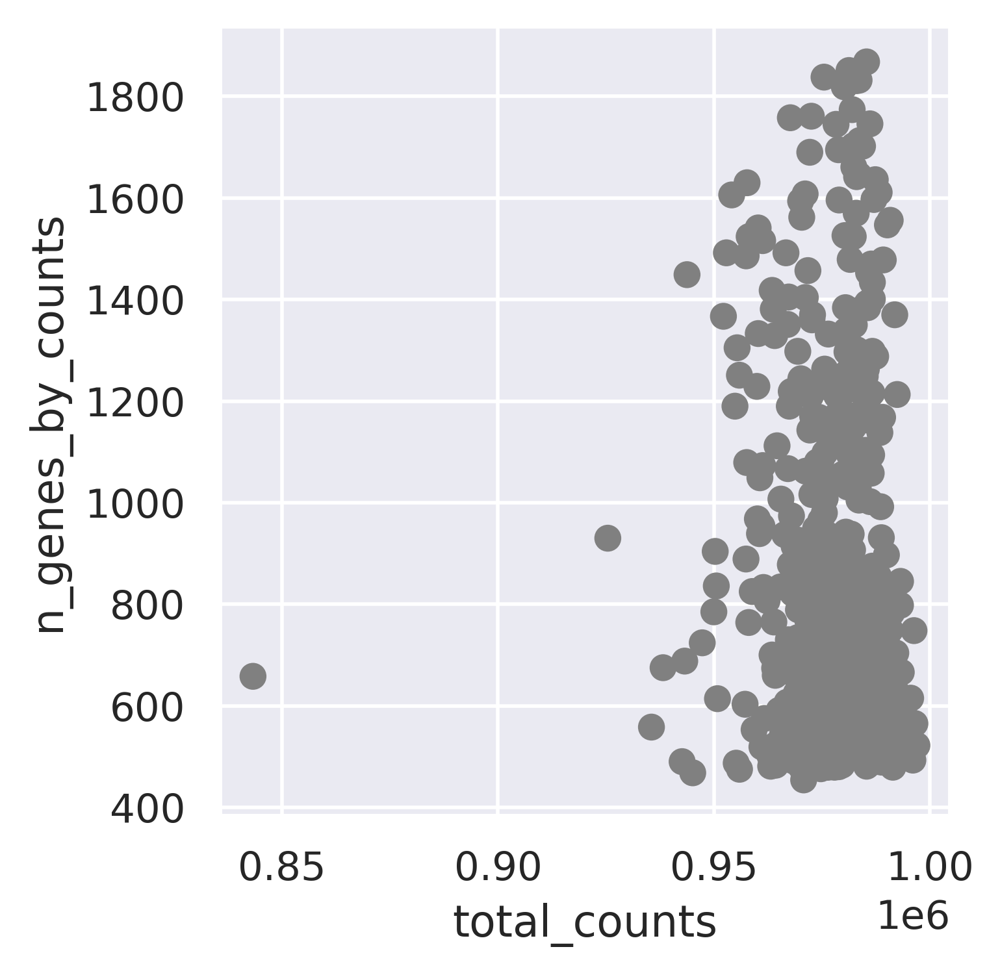

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (539, 8503)
18101
#----------------------------------------------
Deal with 124...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (2415, 19135)


<Figure size 3000x600 with 0 Axes>

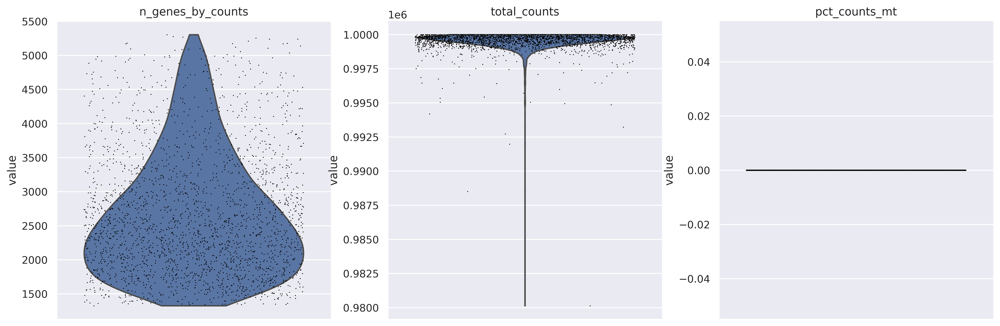

<Figure size 1600x1200 with 0 Axes>

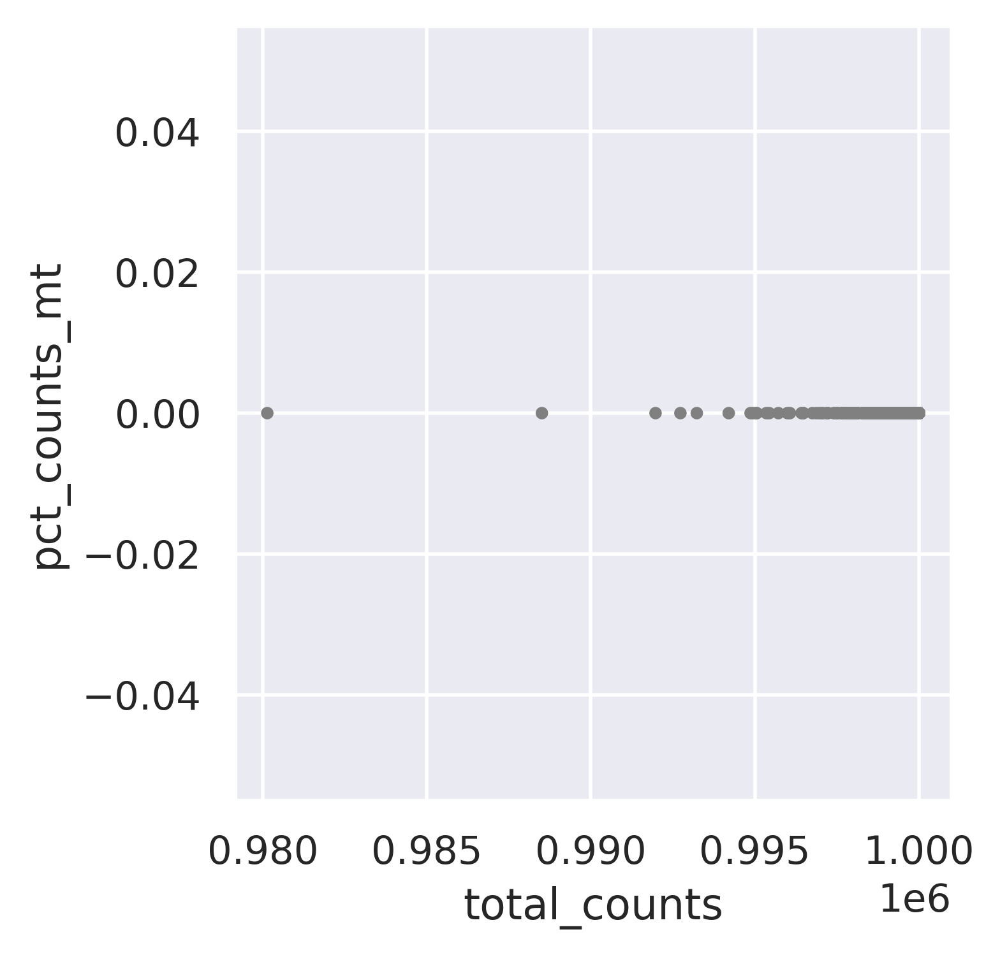

<Figure size 1600x1200 with 0 Axes>

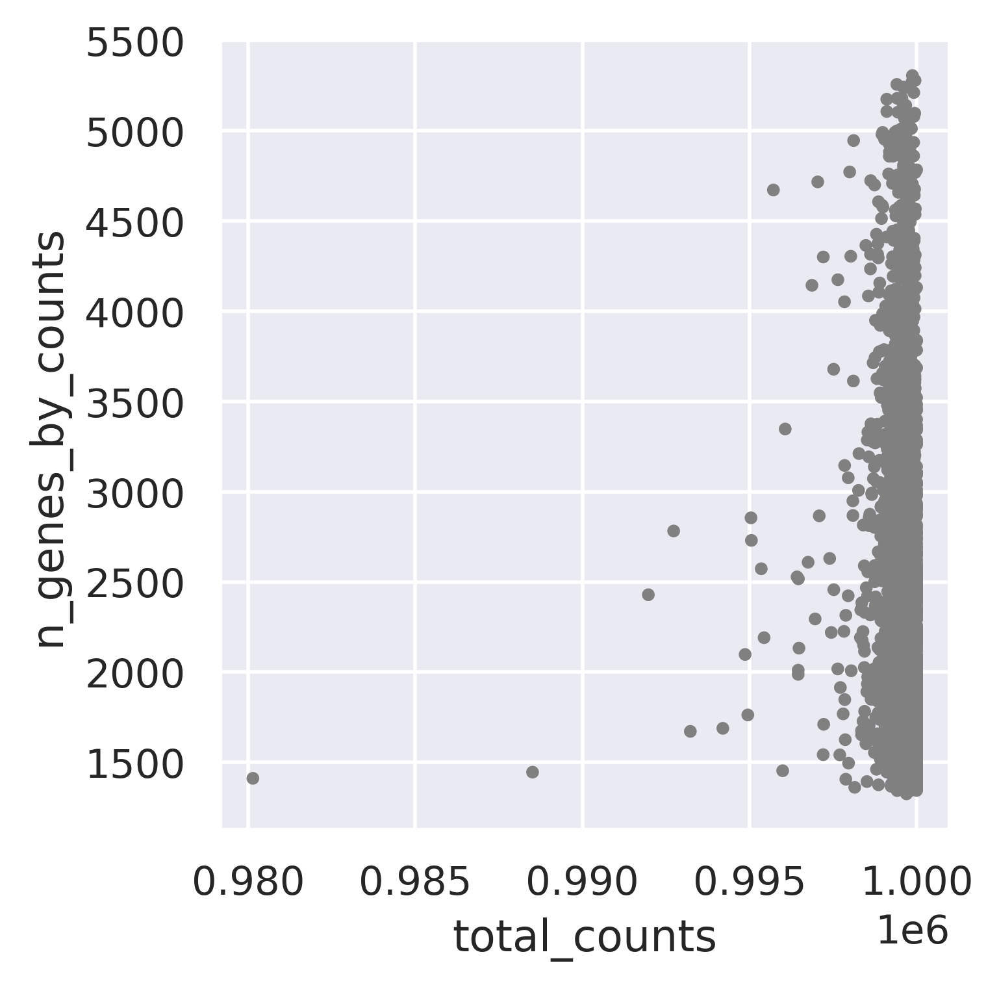

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (2415, 14067)
20516
#----------------------------------------------
Deal with 125...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1613, 19135)


<Figure size 3000x600 with 0 Axes>

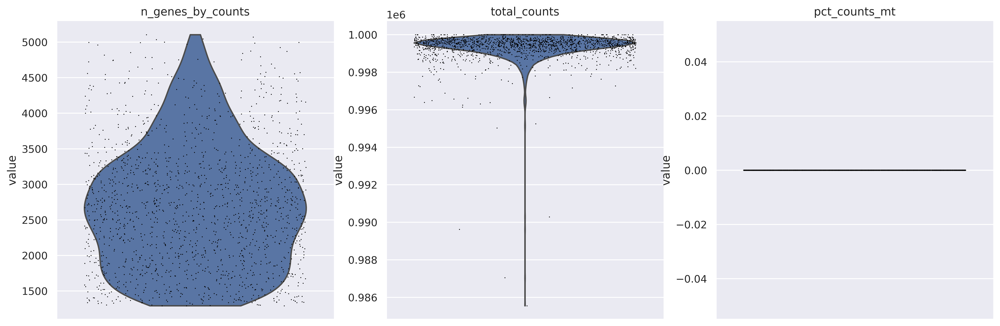

<Figure size 1600x1200 with 0 Axes>

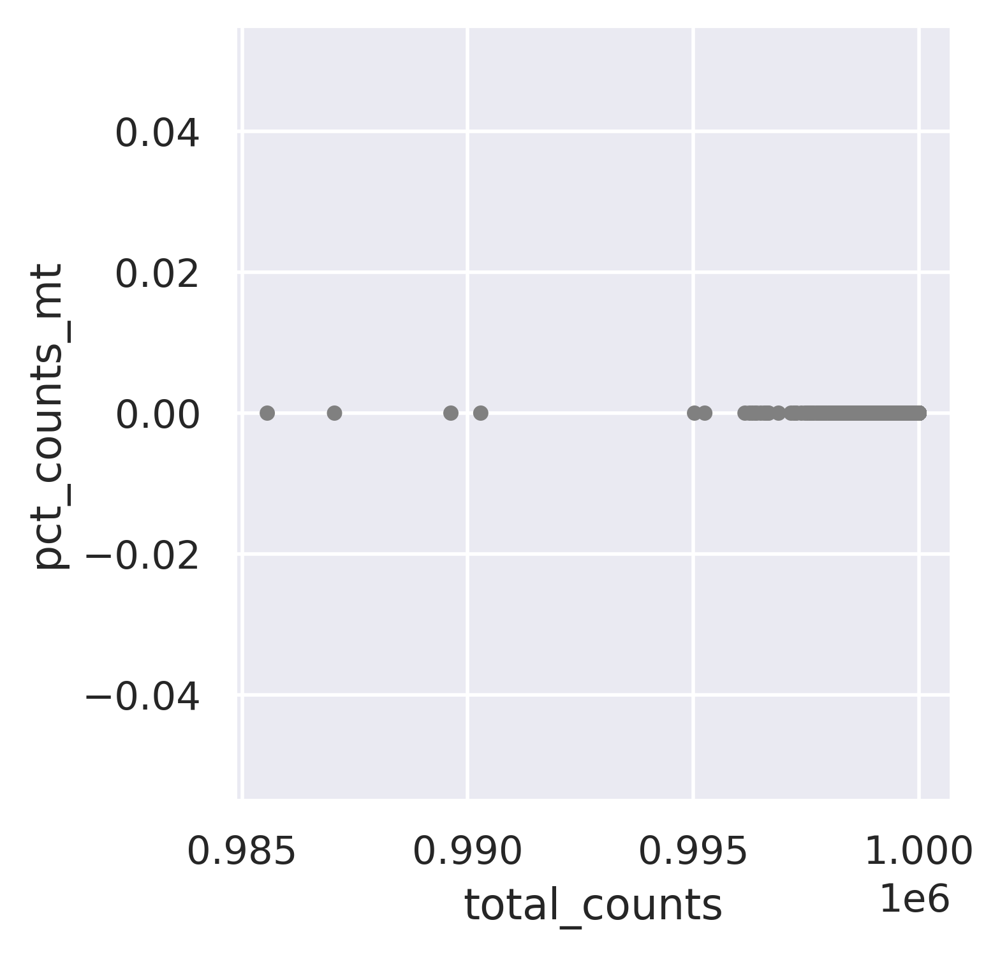

<Figure size 1600x1200 with 0 Axes>

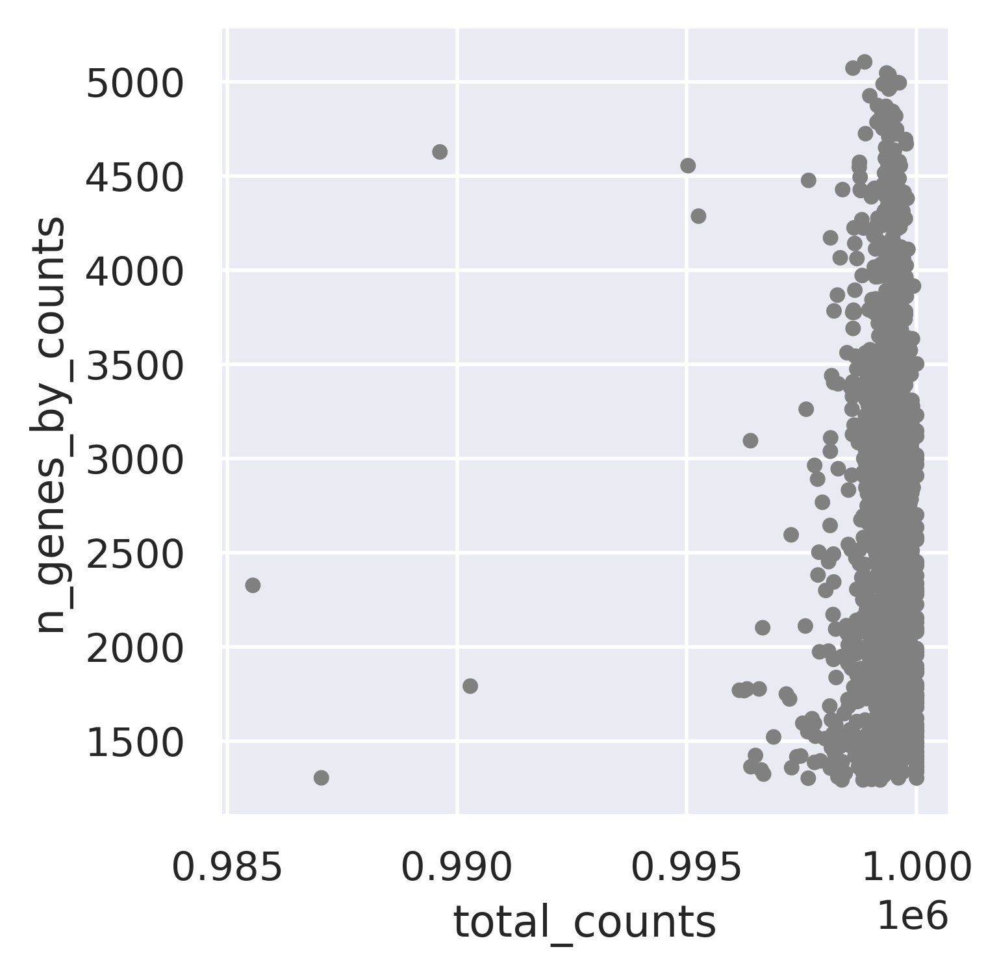

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1613, 13906)
22129
#----------------------------------------------
Deal with 126...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (229, 19135)


<Figure size 3000x600 with 0 Axes>

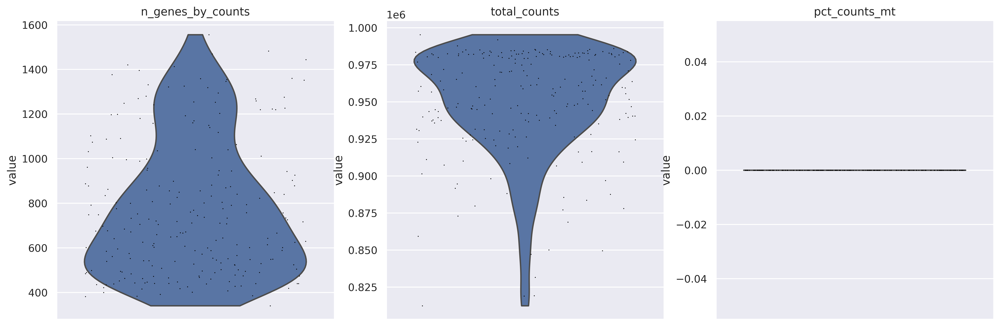

<Figure size 1600x1200 with 0 Axes>

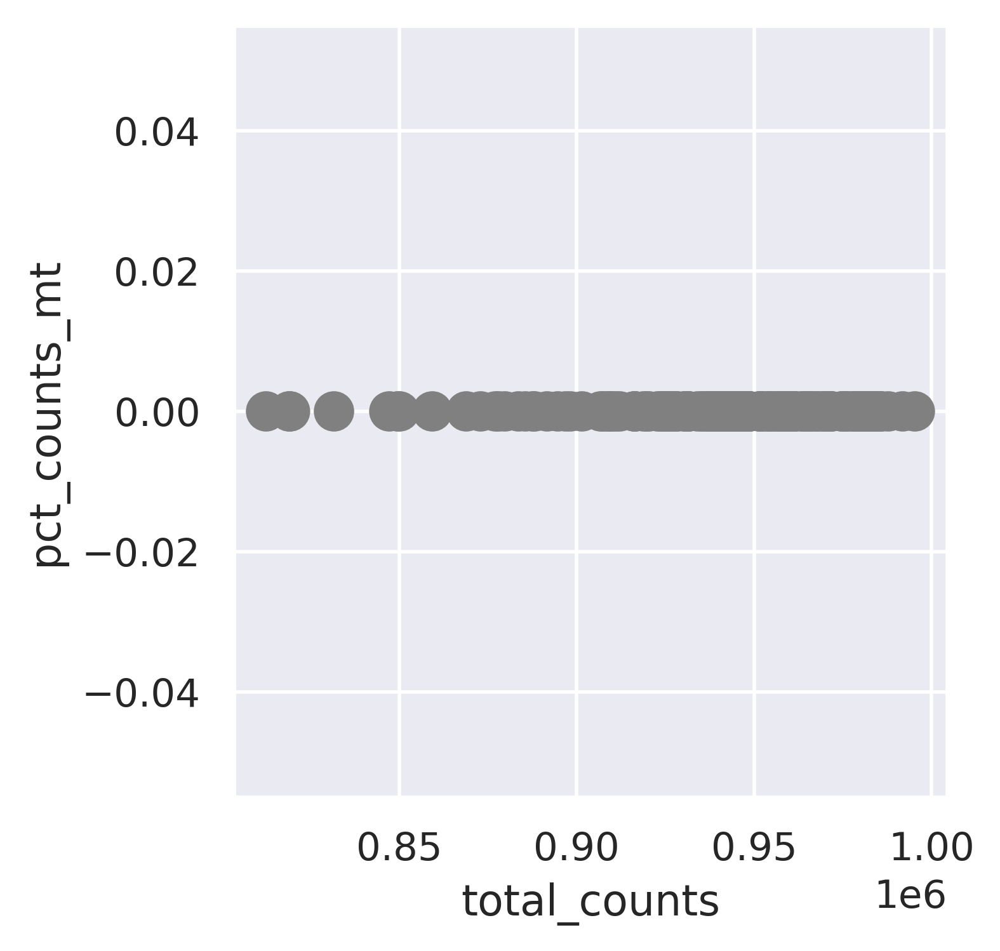

<Figure size 1600x1200 with 0 Axes>

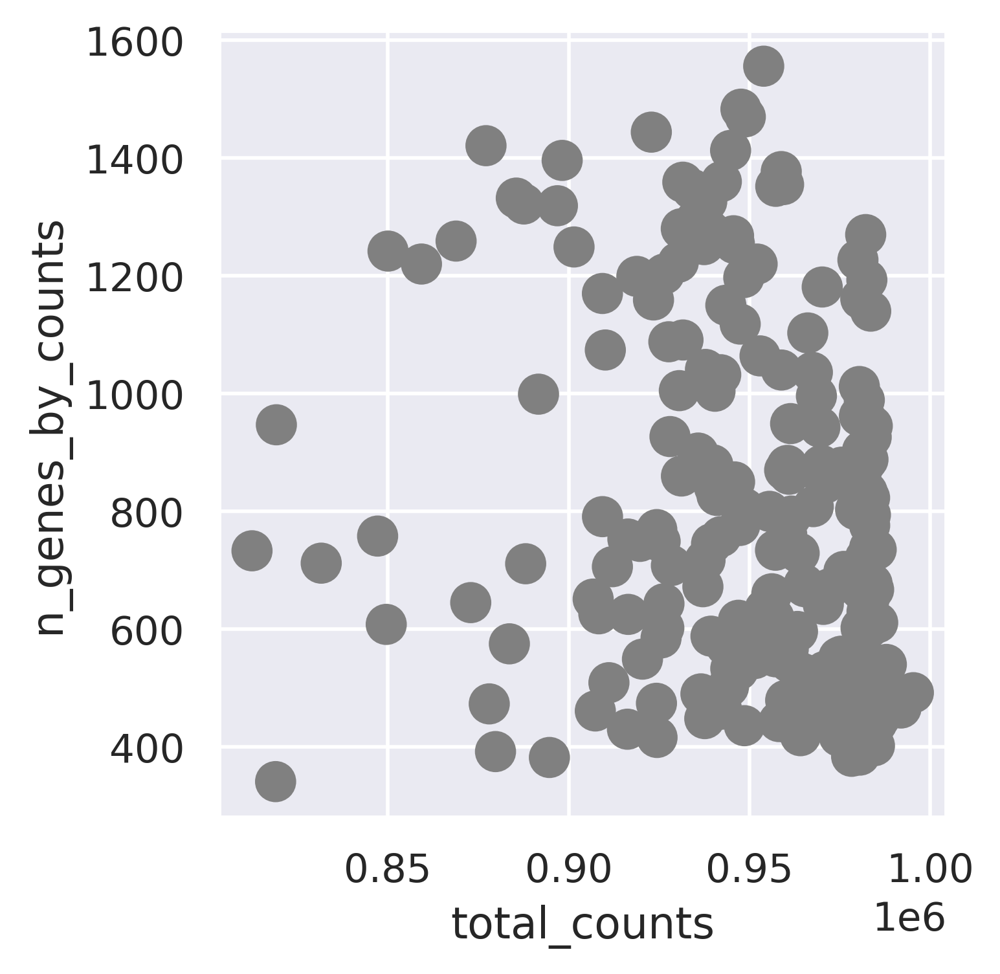

   The shape of adata after filtering is: (229, 5466)
22358


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [17]:
sample_number_afterfilter = 0
for _file in all_files:
    if _file not in ['MGH85','BT786','BT1187']:
        print('#----------------------------------------------')
        print('Deal with {}...'.format(_file))
        current_sample = all_dataset[all_dataset.obs['sample_id']==_file, :]
        print(type(current_sample.X))
        current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, target_sum=1e6,
                                                  max_n_genes_by_counts=8000, max_pct_counts_mt=10, max_total_counts=1e6+100, log_base=2, 
                                                  filter_genes=True, min_cells=10)   
        sample_number_afterfilter += current_sample_normalized.shape[0]
        current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))
    print(sample_number_afterfilter)  #

In [18]:
print(sample_number_afterfilter) 

22358


In [19]:
sample2dataset = {}
for _file in all_files:
    if _file not in ['MGH85','BT786','BT1187']: 
        current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
        current_dataset = sc.read_h5ad(current_file_path, backed=None)
        if current_dataset.shape[0] >= 1:
            # current_dataset.obs['sample'] = _file    
            sample2dataset[_file] = current_dataset
        else:
            print('Remove file {} with shape: {}'.format(_file, current_dataset.shape()))

In [20]:
sample2dataset['143'].obs

,sample_id,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
143_7d_1,143,Macrophage,3181,3177,9.997737e+05,0.0,0.0
143_7d_2,143,Malignant,4297,4297,1.000000e+06,0.0,0.0
143_7d_3,143,Malignant,3216,3214,9.997681e+05,0.0,0.0
143_7d_4,143,Malignant,4954,4954,1.000000e+06,0.0,0.0
143_7d_5,143,Macrophage,4494,4487,9.997840e+05,0.0,0.0
...,...,...,...,...,...,...,...
143_7d_2340,143,Malignant,4612,4610,9.998947e+05,0.0,0.0
143_7d_2341,143,Malignant,6562,6560,9.999376e+05,0.0,0.0
143_7d_2342,143,Malignant,4034,4032,9.998374e+05,0.0,0.0
143_7d_2343,143,Malignant,4164,4160,9.997501e+05,0.0,0.0


### 2 mergering all samples together
- https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.htmlr

In [21]:
len(sample2dataset)

36

In [22]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
count=0
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    count+=1
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')

    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')


dealing with MGH101
dealing with MGH100
dealing with MGH102


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


dealing with MGH104
dealing with MGH105
dealing with MGH106
dealing with MGH110
dealing with MGH113
dealing with MGH115
dealing with MGH121
dealing with MGH122
dealing with MGH124
dealing with MGH125
dealing with BT749
dealing with BT771
dealing with BT830
dealing with BT85
dealing with BT1160
dealing with BT920
dealing with MGH128
dealing with MGH129
dealing with MGH136
dealing with MGH143
dealing with MGH151
dealing with MGH152
dealing with MGH66
dealing with 102
dealing with 143
dealing with 105
dealing with 105A
dealing with 114
dealing with 115
dealing with 118
dealing with 124
dealing with 125


In [23]:
all_dataset

AnnData object with n_obs × n_vars = 22358 × 16613
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mt-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-

In [24]:
print(all_dataset.shape)
all_dataset.obs

(22358, 16613)


,sample_id,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
MGH101-P1-A04,MGH101,Macrophage,2941,2877,978595.853418,0.0,0.0,0
MGH101-P1-A05,MGH101,Macrophage,2745,2694,979758.498610,0.0,0.0,0
MGH101-P1-A07,MGH101,Macrophage,3016,2944,972091.591899,0.0,0.0,0
MGH101-P1-A09,MGH101,Macrophage,2860,2810,981576.034831,0.0,0.0,0
MGH101-P1-A10,MGH101,Macrophage,3244,3176,980560.722139,0.0,0.0,0
...,...,...,...,...,...,...,...,...
126_2_236,126,Malignant,842,705,981642.894876,0.0,0.0,1
126_2_237,126,Fibroblast,1250,1064,952914.285714,0.0,0.0,1
126_2_240,126,Malignant,1051,888,982753.373237,0.0,0.0,1
126_2_242,126,Malignant,509,441,983759.254836,0.0,0.0,1


In [25]:
all_dataset.obs

,sample_id,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
MGH101-P1-A04,MGH101,Macrophage,2941,2877,978595.853418,0.0,0.0,0
MGH101-P1-A05,MGH101,Macrophage,2745,2694,979758.498610,0.0,0.0,0
MGH101-P1-A07,MGH101,Macrophage,3016,2944,972091.591899,0.0,0.0,0
MGH101-P1-A09,MGH101,Macrophage,2860,2810,981576.034831,0.0,0.0,0
MGH101-P1-A10,MGH101,Macrophage,3244,3176,980560.722139,0.0,0.0,0
...,...,...,...,...,...,...,...,...
126_2_236,126,Malignant,842,705,981642.894876,0.0,0.0,1
126_2_237,126,Fibroblast,1250,1064,952914.285714,0.0,0.0,1
126_2_240,126,Malignant,1051,888,982753.373237,0.0,0.0,1
126_2_242,126,Malignant,509,441,983759.254836,0.0,0.0,1


In [26]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
GENE,,,,,,,,,,,,,,,,,,,,,
A1BG,NaN,NaN,NaN,NaN,NaN,NaN,109.0,False,109.0,11.734211,...,501.0,55.484049,68.939864,89495.770867,18.0,False,18.0,37.359568,92.139738,8555.341019
A1BG-AS1,NaN,NaN,NaN,NaN,NaN,NaN,74.0,False,74.0,17.043259,...,43.0,3.181982,97.334160,5132.537181,NaN,NaN,NaN,NaN,NaN,NaN


In [27]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})
all_dataset.var.head(2), all_dataset.var.shape

(          n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0  \
 GENE                                                                                      
 A1BG                                                    NaN                               
 A1BG-AS1                                                NaN                               
 
           total_counts-1  
 GENE                      
 A1BG         8555.341019  
 A1BG-AS1             NaN  ,
 (16613, 2))

In [28]:
all_dataset.write(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged.h5ad'))

In [29]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged.h5ad'))
all_dataset

AnnData object with n_obs × n_vars = 22358 × 16613
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [30]:
gene_list_in_bulk = pd.read_csv(r'../results/single_cell_datasets/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [31]:
common_marker_gene = pd.read_csv('../results/single_cell_datasets/selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(178, 6)


,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [32]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(16090, 158, (19814, 11), (16613, 2))

In [33]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [34]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 22358 × 16090
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


19.278


AnnData object with n_obs × n_vars = 22358 × 16090
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

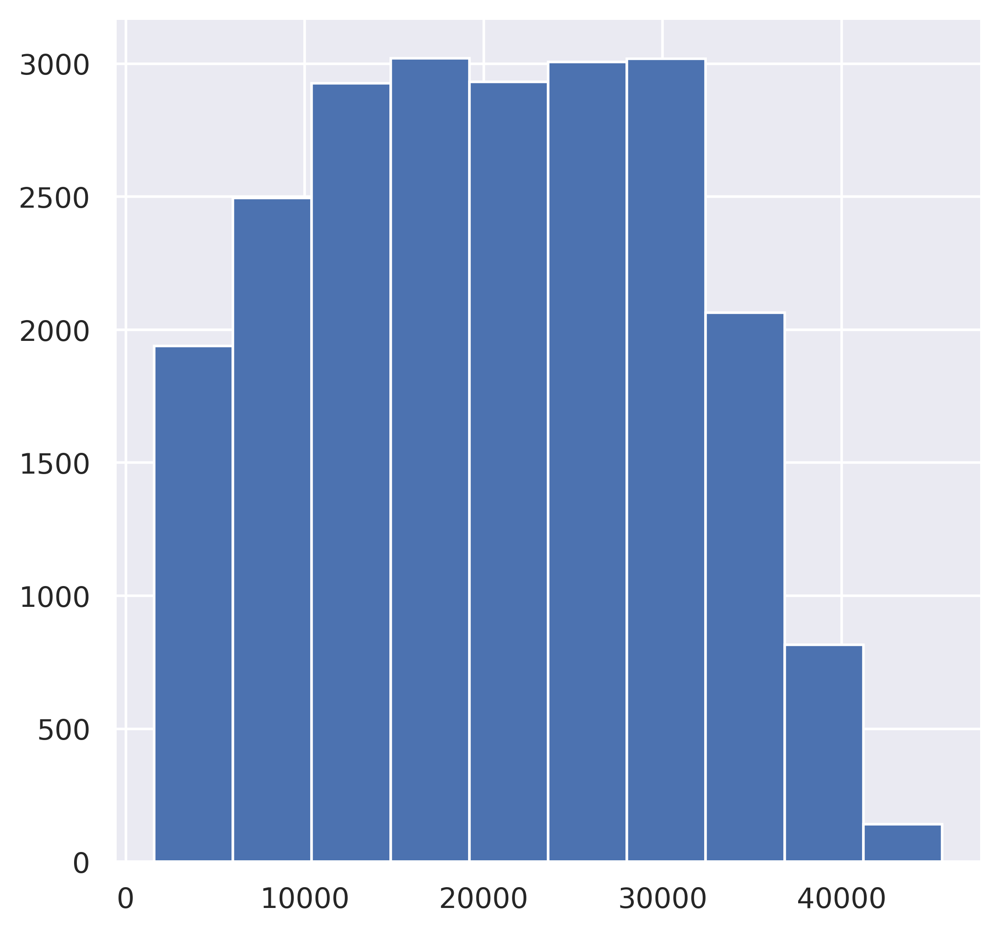

In [35]:
data = pd.DataFrame(all_dataset.X.todense())
data = log_exp2cpm(exp_df=data, log_base=2, correct=1)
data = non_log2log_cpm(input_file_path=data,  correct=1,transpose =False)
all_dataset_1 = an.AnnData(data)
all_dataset_1.X = csr_matrix(all_dataset_1.X)
all_dataset_1.obs = all_dataset.obs
all_dataset_1.var = all_dataset.var
all_dataset = all_dataset_1.copy()
print(data.max().max())  #check 
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))
all_dataset

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [36]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

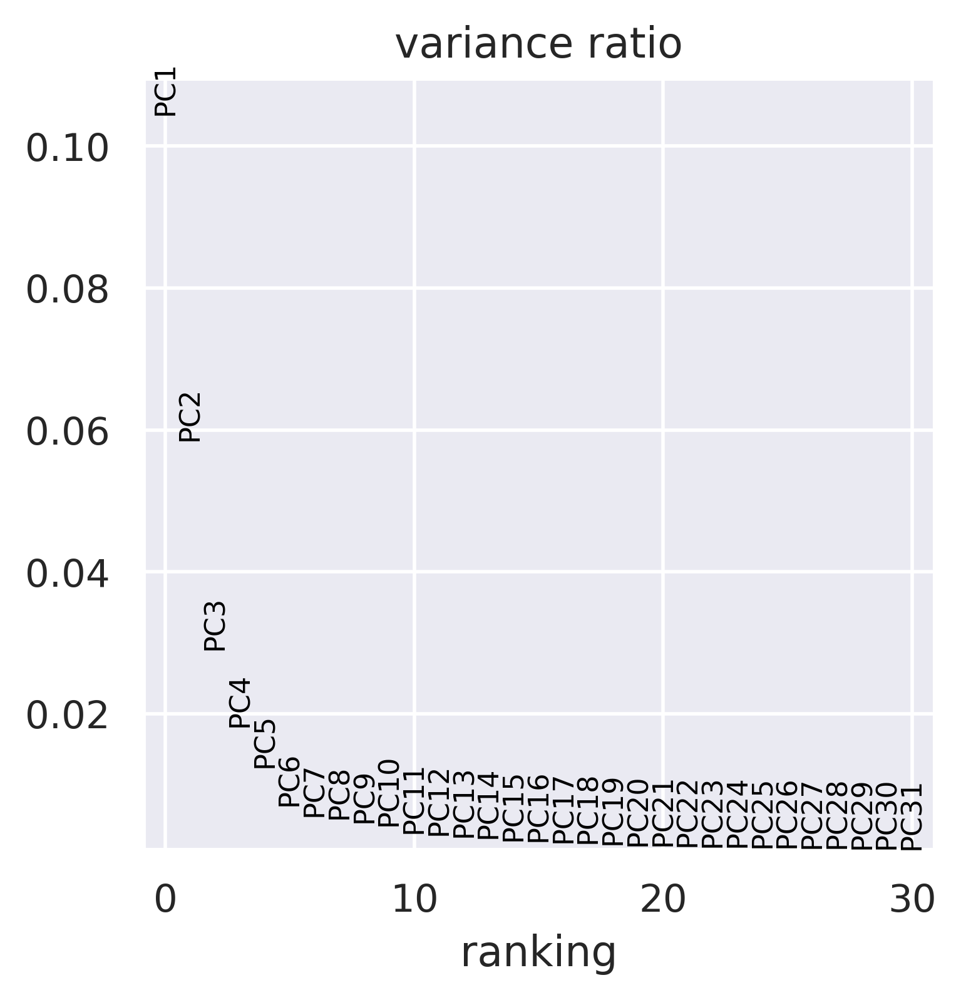

In [37]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [38]:
all_dataset.obsm['X_pca'].shape

(22358, 100)

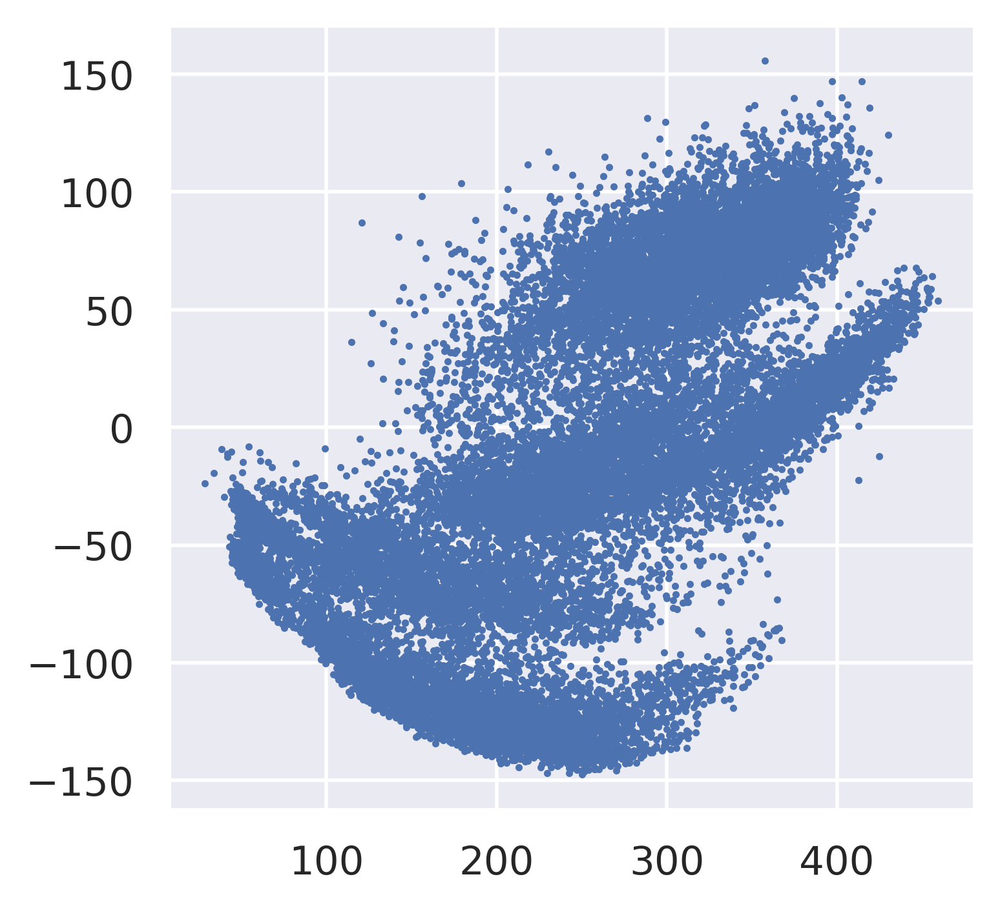

In [39]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1],s=1)

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [40]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [41]:
sc.tl.umap(all_dataset)

In [42]:
all_dataset

AnnData object with n_obs × n_vars = 22358 × 16090
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [43]:
sc.tl.leiden(all_dataset)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


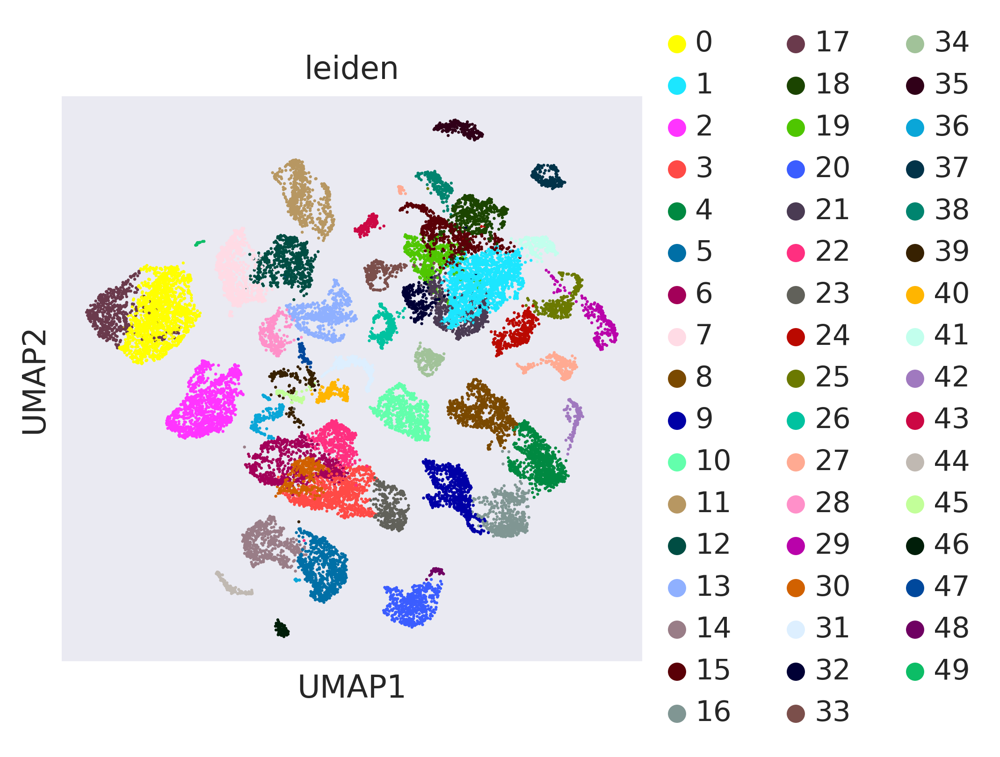

In [44]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')


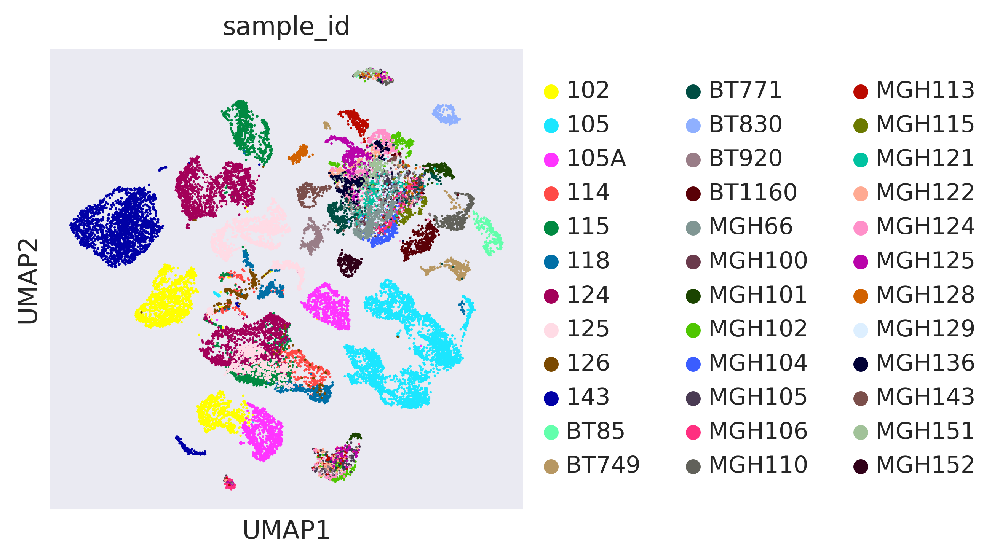

In [45]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [46]:
all_dataset.write(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_before_batch_correction.h5ad'))

### 5. Batch effect correction by BBKNN
- https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [47]:
##ss
all_dataset = sc.read_h5ad(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_before_batch_correction.h5ad'))

In [48]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')


CPU times: user 21.2 s, sys: 860 ms, total: 22 s
Wall time: 16.6 s


In [49]:
all_dataset

AnnData object with n_obs × n_vars = 22358 × 16090
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [50]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

CPU times: user 1min 37s, sys: 35.9 s, total: 2min 13s
Wall time: 1min 29s


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


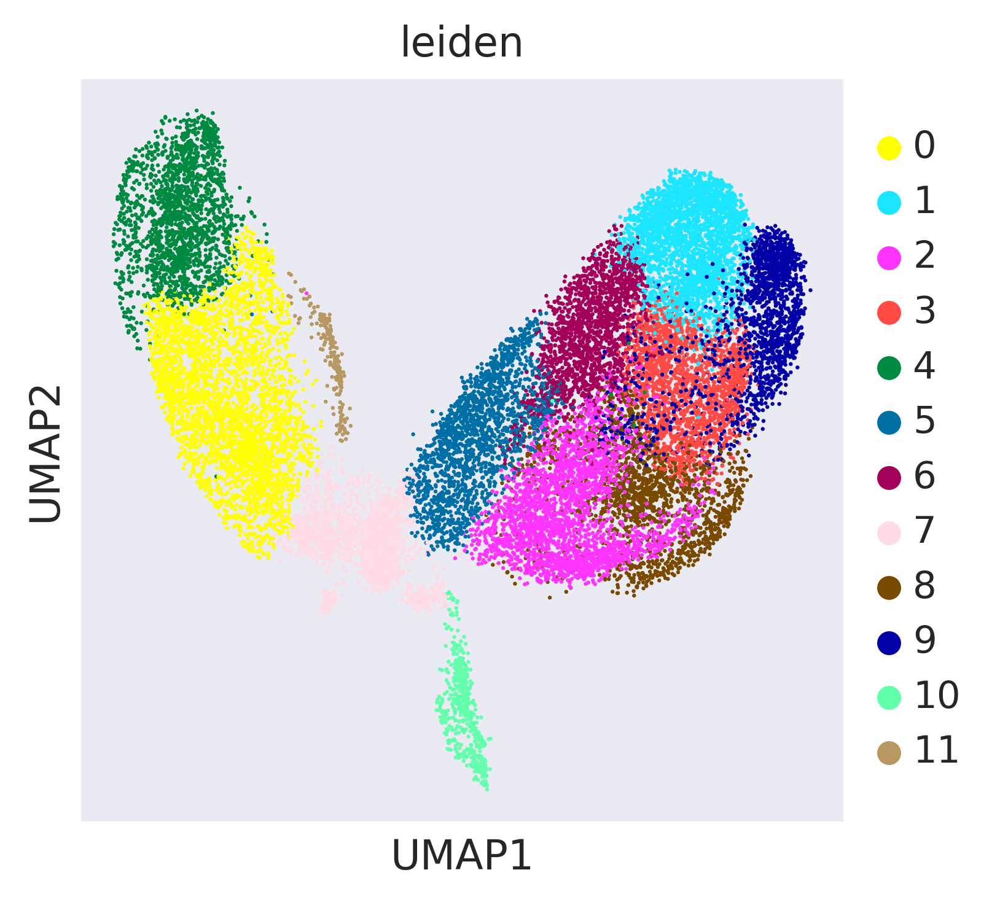

In [51]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

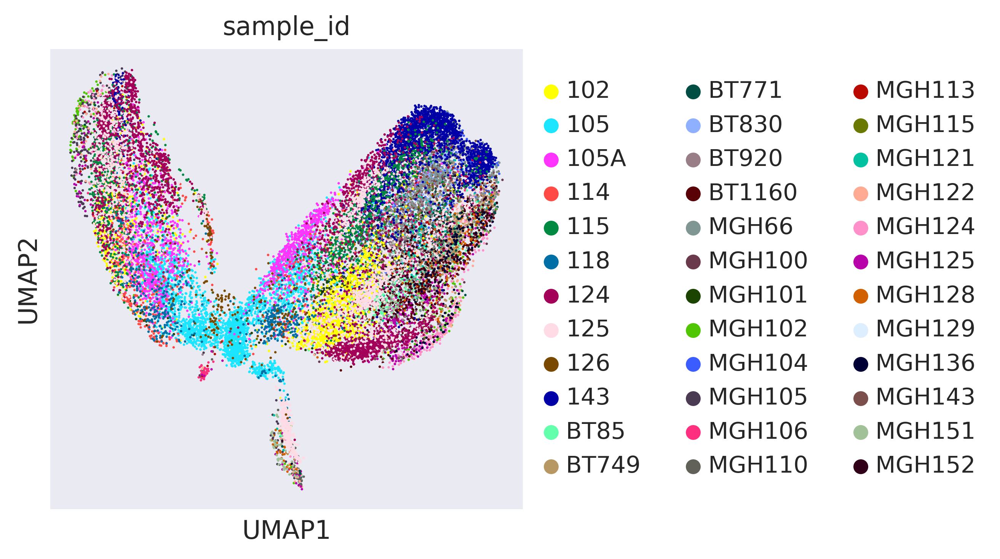

In [52]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

In [53]:
all_dataset.write(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_after_batch_correction_step5.h5ad'))

### 6. Finding marker genes

In [54]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_after_batch_correction_step5.h5ad'))

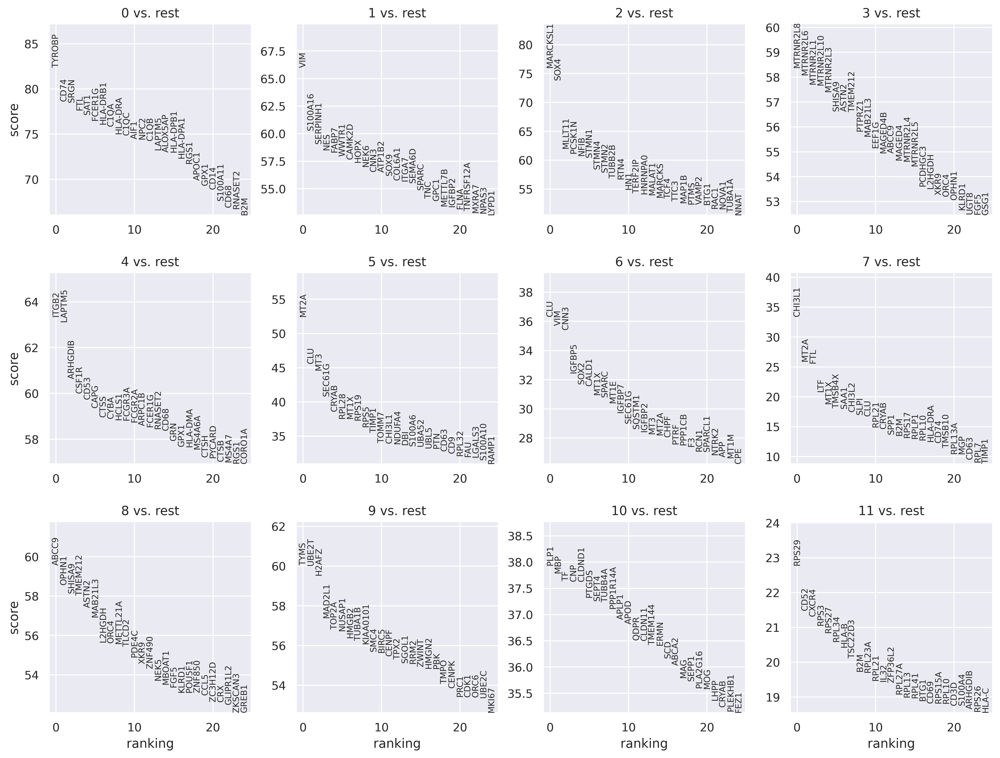

In [55]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [56]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,10,11
0,TYROBP,VIM,MARCKSL1,MTRNR2L8,ITGB2,MT2A,CLU,CHI3L1,ABCC9,TYMS,PLP1,RPS29
1,CD74,S100A16,SOX4,MTRNR2L6,LAPTM5,CLU,VIM,MT2A,OPHN1,UBE2T,MBP,CD52
2,SRGN,SERPINH1,MLLT11,MTRNR2L1,ARHGDIB,MT3,CNN3,FTL,SHISA9,H2AFZ,TF,CXCR4
3,FTL,NES,PCSK1N,MTRNR2L10,CSF1R,SEC61G,IGFBP5,LTF,TMEM212,MAD2L1,CNP,RPS3
4,SAT1,FABP7,NFIB,MTRNR2L3,CD53,CRYAB,SOX2,MT1X,ASTN2,TOP2A,CLDND1,RPS27
5,FCER1G,WWTR1,STMN1,SHISA9,CAPG,RPL28,CALD1,TMSB4X,MAB21L3,NUSAP1,PTGDS,RPL34
6,HLA-DRB1,CAMK2D,STMN4,ASTN2,CTSS,MT1X,MT1X,SAA1,L2HGDH,HMGB2,SEPT4,HLA-B
7,C1QA,HOPX,STMN2,TMEM212,CYBA,RPS19,SPARC,CHI3L2,ORC4,TUBA1B,TUBB4A,TSC22D3
8,HLA-DRA,NEK6,TUBB2B,PTPRZ1,HCLS1,RPS5,MT1E,SLPI,METTL21A,KIAA0101,PPP1R14A,B2M
9,C1QC,CNN3,RTN4,MAB21L3,FCGR3A,TIMP1,IGFBP7,CLU,TLCD2,SMC4,APLP1,RPL23A


In [57]:
common_marker_gene = pd.read_csv(r'../results/single_cell_datasets/selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [58]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print('Cells number of current cluster: {}'.format(all_dataset.obs['leiden'].value_counts()[cluster_id]))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
Cells number of current cluster: 3440
         0    cell_type
0   TYROBP  Macrophages
5   FCER1G  Macrophages
9     C1QC  Macrophages
10    AIF1  Macrophages
12    C1QB  Macrophages
20    CD14  Macrophages
22    CD68  Macrophages
28    CTSB  Macrophages
Current cluster id: 1
Cells number of current cluster: 2788
Empty DataFrame
Columns: [1, cell_type]
Index: []
Current cluster id: 2
Cells number of current cluster: 2612
        2 cell_type
29  FSCN1        DC
Current cluster id: 3
Cells number of current cluster: 1998
        3 cell_type
21  KLRD1        NK
Current cluster id: 4
Cells number of current cluster: 1946
         4                cell_type
9   FCGR3A         Macrophages / NK
10  FCGR2A  Macrophages (discarded)
12  FCER1G              Macrophages
14    CD68              Macrophages
18  MS4A6A              Macrophages
21    CTSB              Macrophages
22   MS4A7              Macrophages
25    CD14              Macrophages
Current cluster id: 5
Cells nu

In [59]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4","CXCL13",  "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2",     
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                  "FOXP3","CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T                                                        
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [60]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "FCRLA", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "CLEC4C", "IRF8", "MZB1", "CD40", # DC
                 "CDH5", "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "DCN", "FAP", "LUM", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "CMA1", "MS4A2", "TPSAB1", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [61]:

list_marker1 = set(all_dataset.var.index) & set(marker_genes1)
missing_gene = set(marker_genes1)-set(list_marker1)
print(f'Marker gene {missing_gene} of marker_genes1 list are missing.')
for i in missing_gene:
    marker_genes1.remove(i)
len(marker_genes1)

Marker gene {'CXCL13', 'FOXP3'} of marker_genes1 list are missing.


48

In [62]:
list_marker2 = set(all_dataset.var.index) & set(marker_genes2)
missing_gene = set(marker_genes2)-set(list_marker2)
print(f'Marker gene {missing_gene} of marker_genes2 list are missing.')
for i in missing_gene:
    marker_genes2.remove(i)
len(marker_genes2)

Marker gene {'FCRL5', 'CMA1', 'KRT19', 'MS4A1'} of marker_genes2 list are missing.


51

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


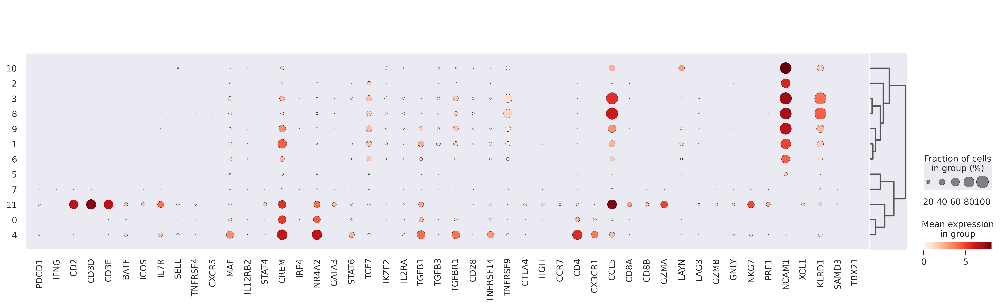

In [63]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


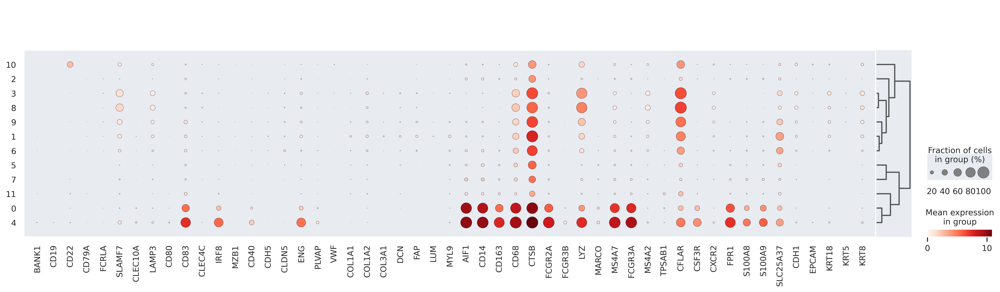

In [64]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)


In [68]:
#  Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0:'Macrophages (1)',
    1:'Cancer Cells (1)',   
    2:'Cancer Cells (2)',  
    3: 'Cancer Cells (3)', 
    4: 'Macrophages (2)',
    5: 'Cancer Cells (4)',  
    6: 'Cancer Cells (5)',   
    7: 'GBM_4',     
    8: 'NK / CD8', 
    9: 'Cancer Cells (6)',    
    10: 'Cancer Cell (7)',   
    11: 'T Cells' 
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['Macrophages (1)', 'Cancer Cells (1)', 'Cancer Cells (2)', 'Cancer Cells (3)', 'Macrophages (2)', 'Cancer Cells (4)', 'Cancer Cells (5)', 'GBM_4', 'NK / CD8', 'Cancer Cells (6)', 'Cancer Cell (7)', 'T Cells']


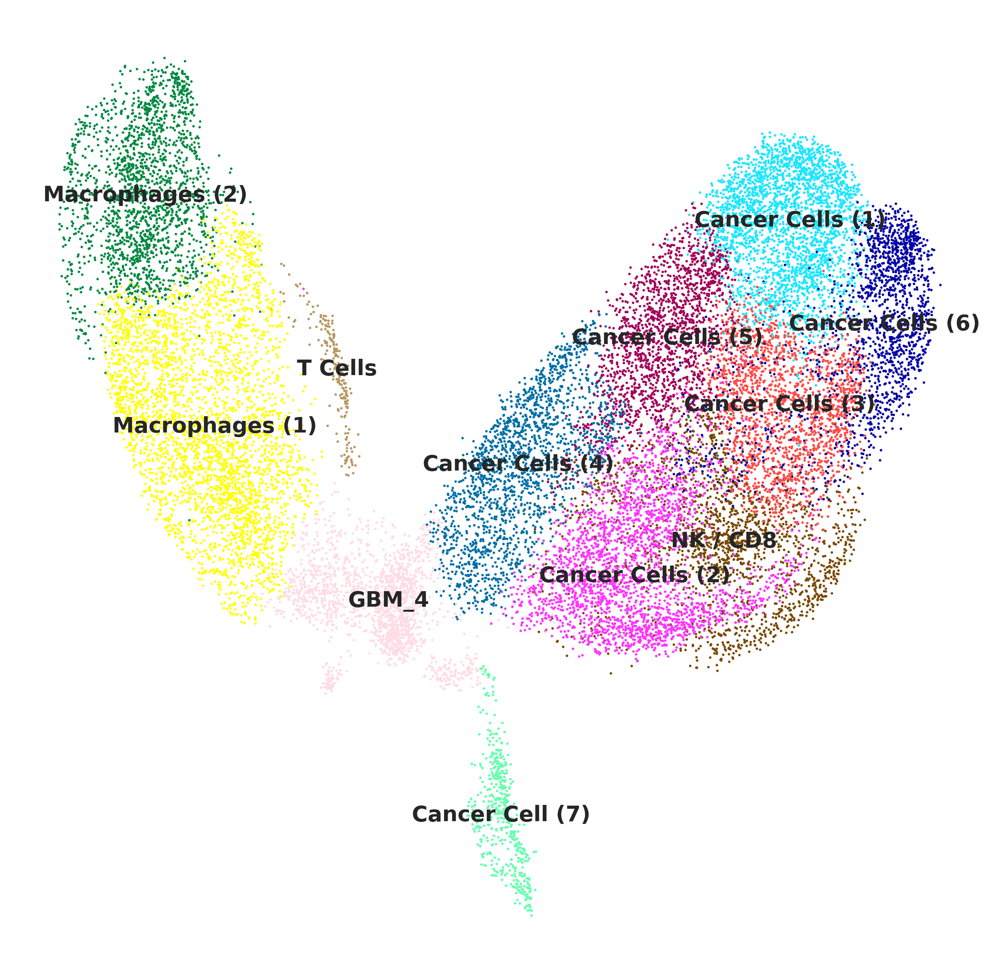

In [69]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


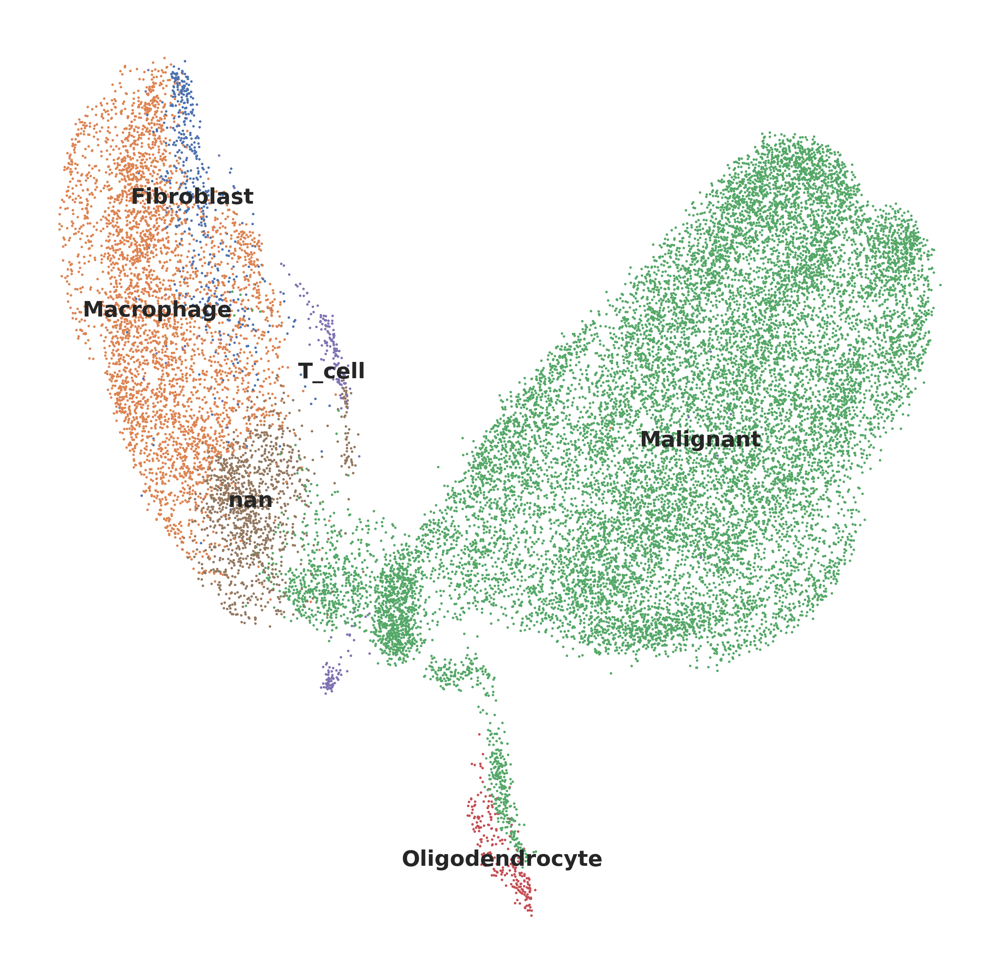

In [67]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='literature.png')

In [66]:
all_dataset.obs

,sample_id,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden
MGH101-P1-A04,MGH101,Macrophage,2941,2877,978595.853418,0.0,0.0,0,0
MGH101-P1-A05,MGH101,Macrophage,2745,2694,979758.498610,0.0,0.0,0,0
MGH101-P1-A07,MGH101,Macrophage,3016,2944,972091.591899,0.0,0.0,0,0
MGH101-P1-A09,MGH101,Macrophage,2860,2810,981576.034831,0.0,0.0,0,7
MGH101-P1-A10,MGH101,Macrophage,3244,3176,980560.722139,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...
126_2_236,126,Malignant,842,705,981642.894876,0.0,0.0,1,7
126_2_237,126,Fibroblast,1250,1064,952914.285714,0.0,0.0,1,0
126_2_240,126,Malignant,1051,888,982753.373237,0.0,0.0,1,7
126_2_242,126,Malignant,509,441,983759.254836,0.0,0.0,1,7


In [70]:
all_dataset.write(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_after_batch_correction.h5ad'))

#### Comparing original cell type and annotated cell type

In [ ]:
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [72]:
sorted(list(all_dataset.obs.leiden.unique()))

['Cancer Cell (7)',
 'Cancer Cells (1)',
 'Cancer Cells (2)',
 'Cancer Cells (3)',
 'Cancer Cells (4)',
 'Cancer Cells (5)',
 'Cancer Cells (6)',
 'GBM_4',
 'Macrophages (1)',
 'Macrophages (2)',
 'NK / CD8',
 'T Cells']

In [85]:
#Because GBM is not an epithelial tumor, the cells that are not commented out are assumed to be tumor cells tentatively, and further screening will follow
cell_type_mapping_leiden = {
 'Cancer Cell (7)': 'Cancer Cells',
 'Cancer Cells (1)': 'Cancer Cells',
 'Cancer Cells (2)': 'Cancer Cells',
 'Cancer Cells (3)': 'Cancer Cells',
 'Cancer Cells (4)': 'Cancer Cells',
 'Cancer Cells (5)': 'Cancer Cells',
 'Cancer Cells (6)': 'Cancer Cells',
 'GBM_4': 'GBM_4',       #delete later
 'Macrophages (1)': 'Macrophages',
 'Macrophages (2)': 'Macrophages',
 'NK / CD8': 'Lymphocytes' ,    #delete later
 'T Cells': 'T Cells'
}

In [76]:
sorted(list(all_dataset.obs.cell_type.unique()))

['Fibroblast', 'Macrophage', 'Malignant', 'Oligodendrocyte', 'T_cell', 'nan']

In [77]:
cell_type_mapping_original = {
 'Macrophage': 'Macrophages',
 'Malignant': 'Cancer Cells',    
 'Oligodendrocyte': 'Oligodendrocyte',
 'T_cell': 'T Cells',
 'Fibroblast': 'Fibroblasts',  
 'Macrophage': 'Macrophages',
 'nan': 'nan',

}  

In [86]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping_leiden)
all_dataset.obs['original_cell_type'] = all_dataset.obs['cell_type'].map(cell_type_mapping_original)
all_dataset.obs.head(2)

,sample_id,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
MGH101-P1-A04,MGH101,Macrophage,2941,2877,978595.853418,0.0,0.0,0,Macrophages (1),Macrophages,Macrophages
MGH101-P1-A05,MGH101,Macrophage,2745,2694,979758.498610,0.0,0.0,0,Macrophages (1),Macrophages,Macrophages


In [80]:
all_dataset.obs.shape

(22358, 11)

In [87]:
all_datasets_info = pd.DataFrame(all_dataset.obs.groupby(
    ['cell_type1','original_cell_type']).size())
all_datasets_info = all_datasets_info.loc[~(all_datasets_info[0]==0)]
all_datasets_info


0
cell_type1   original_cell_type       
Cancer Cells Fibroblasts             2
             Macrophages             2
             Cancer Cells        13031
             Oligodendrocyte       217
             T Cells                 3
GBM_4        Macrophages             7
             Cancer Cells         1640
             T Cells                76
             nan                    40
Lymphocytes  Cancer Cells         1748
Macrophages  Fibroblasts           488
             Macrophages          3772
             Cancer Cells           57
             T Cells                17
             nan                  1052
T Cells      Fibroblasts             8
             Macrophages             1
             Cancer Cells            3
             T Cells               134
             nan                    60

In [88]:
# setting DC cell type based on original cell type

Remove cells with different cell type between `cell_type1` and `original_cell_type`.

In [90]:
hnscc_03_obs_bool = (all_dataset.obs['cell_type1'] == all_dataset.obs['original_cell_type'])
print(sum(hnscc_03_obs_bool))
all_dataset = all_dataset[hnscc_03_obs_bool, :].copy()

16937


In [91]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

Macrophages (1) 1.0 2174
Cancer Cells (1) 1.0 2788
Cancer Cells (2) 1.0 2610
Cancer Cells (3) 1.0 1998
Macrophages (2) 1.0 1598
Cancer Cells (4) 1.0 1899
Cancer Cells (5) 1.0 1767
Cancer Cells (6) 1.0 1690
Cancer Cell (7) 1.0 279
T Cells 1.0 134


In [94]:
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})

In [95]:
all_dataset

AnnData object with n_obs × n_vars = 16937 × 16090
    obs: 'sample_id', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [96]:
all_datasets_info = pd.DataFrame(all_dataset.obs.groupby(
    ['original_cell_type','leiden']).size())
all_datasets_info = all_datasets_info.loc[~(all_datasets_info[0]==0)]
all_datasets_info


0
original_cell_type leiden                
Macrophages        Macrophages (1)   2174
                   Macrophages (2)   1598
Cancer Cells       Cancer Cells (1)  2788
                   Cancer Cells (2)  2610
                   Cancer Cells (3)  1998
                   Cancer Cells (4)  1899
                   Cancer Cells (5)  1767
                   Cancer Cells (6)  1690
                   Cancer Cell (7)    279
T Cells            T Cells            134

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


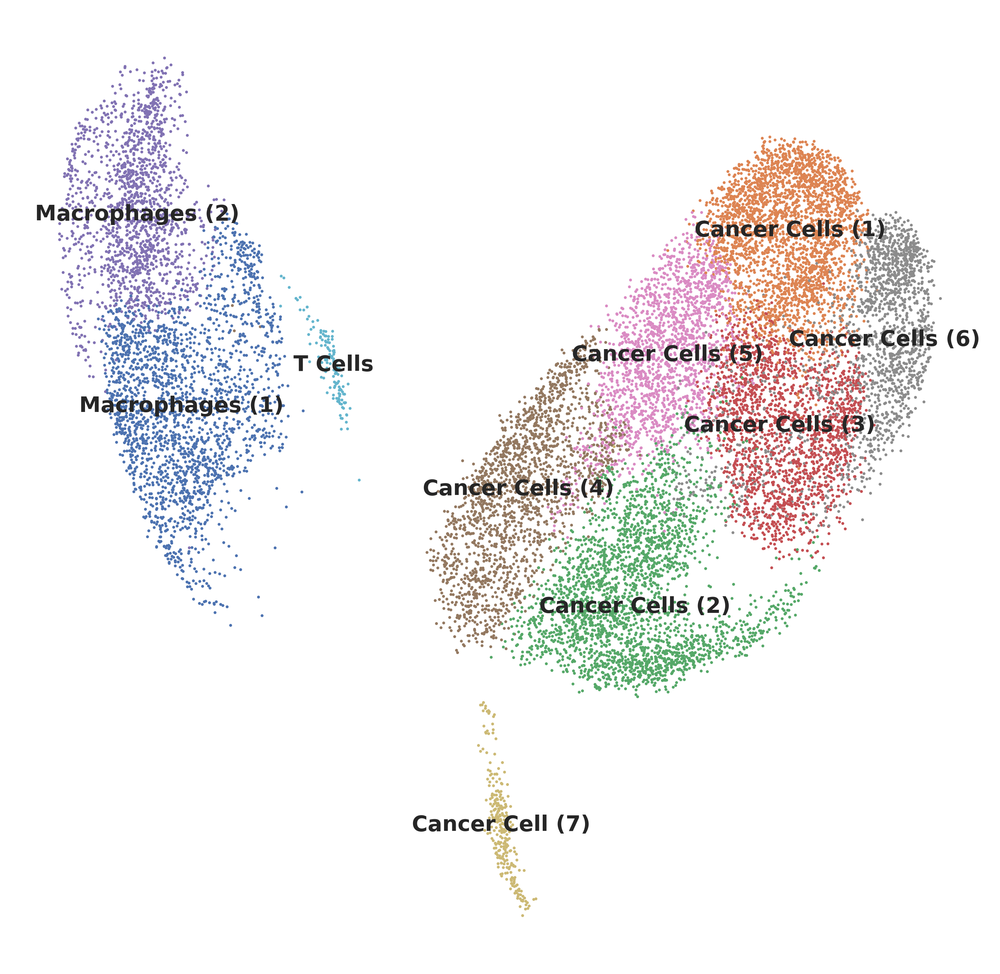

In [97]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_new.png')

In [99]:
all_dataset.write(os.path.join(result_dir, 'all_GBM_Neftel_Cell_2019_merged_after_batch_correction.h5ad'))